In [1]:
import numpy as np
from scipy import fft, optimize
from scipy.linalg import pinv
import NAFFlib as naf
import statistics as st
import matplotlib.pyplot as plt
import time
from IPython.display import display, Math
import re
import csv
import os

#Linear Regression
from sklearn.linear_model import LinearRegression
np.set_printoptions(suppress=True)

# BPM Data

In [41]:
#Get data from all BPMs from sdds file
Name_xbpms = []
Name_ybpms = []

# sdds_file = 'data_Wed_Jun_28_20-13-14_2023'
# sdds_file = 'data_Tue_Jun_11_11_06_06_2024'
# sdds_file = 'data_Fri_Jun_21_16_13_19_2024'

# sdds_file = 'data_Wed_Jul_10_15_18_01_2024'
sdds_file = 'data_Wed_Jul_10_15_22_53_2024'
# sdds_file = 'data_Wed_Jul_10_15_25_35_2024'
# sdds_file = 'data_Wed_Jul_10_15_34_02_2024'

with open("TBT_Data/" + sdds_file) as output:
    Lines = output.readlines()
    index_ix = index_jx = 0
    index_iy = index_jy = 0
    
    N_BPMx = int(Lines[63])
    N_BPMy = int(Lines[65])
    N_turns = int(Lines[64])
    Pos_xbpms = np.zeros([N_turns, N_BPMx])
    Pos_ybpms = np.zeros([N_turns, N_BPMy])
    S_xbpms = np.zeros([N_turns, N_BPMx])
    S_ybpms = np.zeros([N_turns, N_BPMy])
    
    init_i = 414
    end_y_index = N_BPMy*N_turns + init_i + 1
    for i, line in enumerate(Lines[1:]):
        Line = []
        #xBPM Names
        if i >= 67 and i < 95:
            for word in re.split("\s+", line):
                Line.append(word)
            Name_xbpms.append(Line[:-1])
        
        #yBPM Names
        if i >= 241 and i < 269:
            for word in re.split("\s+", line):
                Line.append(word)
            Name_ybpms.append(Line[:-1])
           
        #s and positions for xBPM
        if i > init_i:
            row = re.split("\s+", line)
            S_xbpms[index_ix][index_jx] = float(row[1])
            Pos_xbpms[index_ix][index_jx] = float(row[2])
            index_jx = (i - init_i)%N_BPMx
            
            if (i - init_i)%N_BPMx == 0 and (i - init_i) != 0:
                index_ix += 1
        
        #s and positions for yBPM
        if i > init_i and i < end_y_index:
            row = re.split("\s+", line)
            S_ybpms[index_iy][index_jy] = float(row[6])
            Pos_ybpms[index_iy][index_jy] = float(row[7])
            index_jy = (i - init_i)%N_BPMy
            
            if (i - init_i)%N_BPMy == 0 and (i - init_i) != 0:
                index_iy += 1
        
Name_xbpms = [item for row in Name_xbpms for item in row]
Name_ybpms = [item for row in Name_ybpms for item in row]

In [3]:
# Positions
init_turn = 0
N_turns = 1024
BPMx = Pos_xbpms[:N_turns].T
BPMy = Pos_ybpms[:N_turns].T

x = np.linspace(init_turn, N_turns, N_turns)
Omega = np.linspace(0, N_turns//2, N_turns//2)/N_turns


Mean of First Horizontal BPM = -1.3517021509179687
Standard deviation of First Horizontal BPM = 0.09794191699699697
Mean of First Vertical BPM = -0.5178896492657227
Standard deviation of First Vertical BPM = 0.1965038039946207


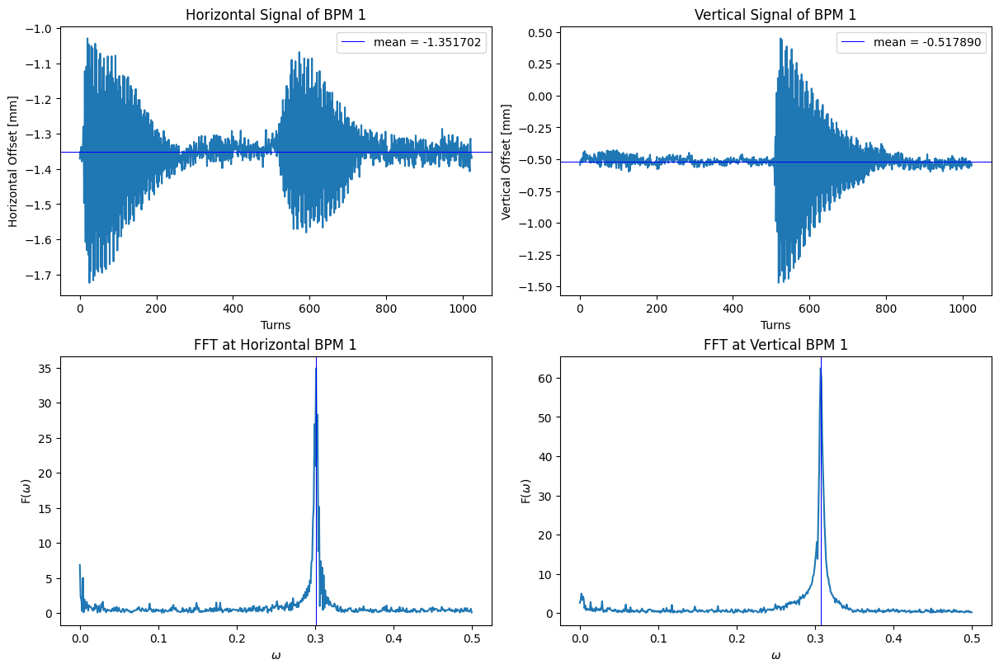

In [4]:
BPMx0 = BPMx[0]
N_turns = len(BPMx0)

BPMx0_mean = np.mean(BPMx0)
BPMx0_std = np.std(BPMx0)
print()
print("Mean of First Horizontal BPM =", BPMx0_mean)
print("Standard deviation of First Horizontal BPM =", BPMx0_std)

BPMy0 = BPMy[0]
BPMy0_mean = np.mean(BPMy0)
BPMy0_std = np.std(BPMy0)
print("Mean of First Vertical BPM =", BPMy0_mean)
print("Standard deviation of First Vertical BPM =", BPMy0_std)

fig, Ax = plt.subplots(2, 2, figsize=(12, 8), layout='constrained')
x = np.linspace(0, N_turns, N_turns)
Ax[0][0].plot(x, BPMx0)
Ax[0][0].axhline(y = BPMx0_mean, color = 'b', linestyle = '-', linewidth = .75, label = r"mean = %f"%BPMx0_mean)
Ax[0][0].set_xlabel("Turns")
Ax[0][0].set_ylabel("Horizontal Offset [mm]")
Ax[0][0].set_title("Horizontal Signal of BPM 1")
Ax[0][0].legend()

Ax[0][1].plot(x, BPMy0)
Ax[0][1].axhline(y = BPMy0_mean, color = 'b', linestyle = '-', linewidth = .75, label = r"mean = %f"%BPMy0_mean)
Ax[0][1].set_xlabel("Turns")
Ax[0][1].set_ylabel("Vertical Offset [mm]")
Ax[0][1].set_title("Vertical Signal of BPM 1")
Ax[0][1].legend()

# Look at FFT graphs and tune of beam
Omega = np.linspace(0, N_turns//2, N_turns//2)/N_turns
BPMX0 = np.abs(fft.rfft(BPMx0)[1:])
BPMx0_Tune_scipy = Omega[np.argmax(BPMX0)]
Ax[1][0].plot(Omega, BPMX0)
Ax[1][0].axvline(x = BPMx0_Tune_scipy, color = 'b', linestyle = '-', linewidth = .75, label = r"$\nu_x$ = %f"%BPMx0_Tune_scipy)
Ax[1][0].set_title("FFT at Horizontal BPM 1")
Ax[1][0].set_xlabel(r"$\omega$")
Ax[1][0].set_ylabel(r"F($\omega$)")

BPMY0 = np.abs(fft.rfft(BPMy0)[1:])
BPMy0_Tune_scipy = Omega[np.argmax(BPMY0)]
Ax[1][1].plot(Omega, BPMY0)
Ax[1][1].axvline(x = BPMy0_Tune_scipy, color = 'b', linestyle = '-', linewidth = .75, label = r"$\nu_y$ = %f"%BPMy0_Tune_scipy)
Ax[1][1].set_title("FFT at Vertical BPM 1")
Ax[1][1].set_xlabel(r"$\omega$")
Ax[1][1].set_ylabel(r"F($\omega$)")
plt.show(block=False)
print()

Average Horizontal tune: 0.3013698630136986
Average Vertical tune: 0.3013698630136986


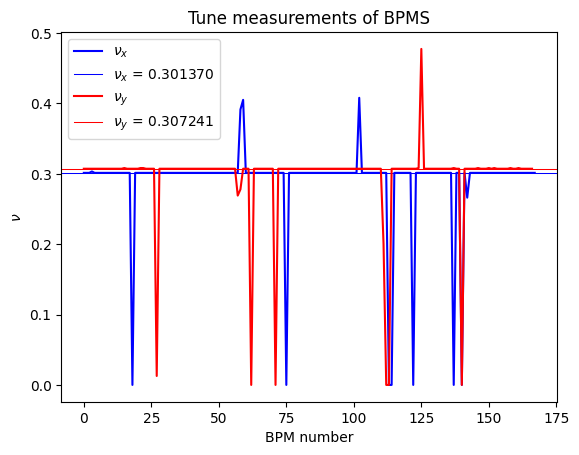

[18, 58, 59, 75, 102, 113, 114, 122, 137, 140, 142]
[27, 57, 58, 62, 71, 111, 112, 113, 125, 140]


In [5]:
# Look at all FFTs to figure out Tune of machine
BPMx_Tune_Map = np.zeros(N_BPMx)
for i in range(N_BPMx):
    BPMX = np.abs(fft.rfft(BPMx[i])[1:]) 
    BPMx_Tune_Map[i] = Omega[np.argmax(BPMX)]

BPMy_Tune_Map = np.zeros(N_BPMy)
for i in range(N_BPMy):
    BPMY = np.abs(fft.rfft(BPMy[i])[1:])
    BPMy_Tune_Map[i] = Omega[np.argmax(BPMY)]

nu_x, nu_y = st.mode(BPMx_Tune_Map), st.mode(BPMy_Tune_Map)
print("Average Horizontal tune:", nu_x)
print("Average Vertical tune:", nu_x)

plt.plot(BPMx_Tune_Map, color = 'b', label = r"$\nu_x$")
plt.axhline(y = nu_x, color = 'b', linestyle = '-', linewidth = .75, label = r"$\nu_x$ = %f"%nu_x)
plt.plot(BPMy_Tune_Map, color = 'r', label = r"$\nu_y$")
plt.axhline(y = nu_y, color = 'r', linestyle = '-', linewidth = .75, label = r"$\nu_y$ = %f"%nu_y)
plt.xlabel("BPM number")
plt.ylabel(r"$\nu$")
plt.title("Tune measurements of BPMS")
plt.legend()
plt.show()

def Bad_Bpms(Tune_Map, nu, N_BPM):
    Tune_Offset = np.abs(Tune_Map - np.ones(N_BPM)*nu)
    Bad_BPM = []
    for i, offset in enumerate(Tune_Offset):
        if offset > .005:
            Bad_BPM.append(i)
    return Bad_BPM
Bad_xBPMs = Bad_Bpms(BPMx_Tune_Map, nu_x, N_BPMx)
Bad_yBPMs = Bad_Bpms(BPMy_Tune_Map, nu_y, N_BPMy)
print(Bad_xBPMs)
print(Bad_yBPMs)

In [6]:
# Drift_bpmx = [(163, 165), (167, 0), (2, 4), (23, 25), (27, 28), (30, 32),
#               (53, 55), (57, 60), (62, 64), (83, 84), (86, 87), (89, 90)]
# Drift_bpmy = [(162, 164), (166, 0), (2, 4), (24, 26), (28, 29), (31, 33),
#               (53, 54), (56, 59), (61, 63), (83, 84), (86, 87), (89, 90)]

In [8]:
BetxModel = {}
AlfxModel = {}
BetyModel = {}
AlfyModel = {}
sModel = {}

# twiss_file = 'Twiss_files/twiss.out_Au23-100GeV-e0store'
# twiss_file = 'Twiss_files/twiss.out_pp24-100GeV-e0store'
twiss_file = 'Twiss_files/twiss.out_pp24-100GeV-e1store'

# Get Linear optics from MADx
with open(twiss_file) as output:
    Lines = output.readlines()
    for line in Lines:
        linelist = re.split("\s+", line)
        # print(linelist)
        if linelist[0] == '*':
            idx_s = linelist.index('S')
            idx_BETX = linelist.index('BETX')
            idx_ALFX = linelist.index('ALFX')
            idx_BETY = linelist.index('BETY')
            idx_ALFY = linelist.index('ALFY')
        
        if linelist[0] == '':
            sModel[linelist[1][1:-1]] = float(linelist[idx_s])
            BetxModel[linelist[1][1:-1]] = float(linelist[idx_BETX])
            AlfxModel[linelist[1][1:-1]] = float(linelist[idx_ALFX])
            BetyModel[linelist[1][1:-1]] = float(linelist[idx_BETY])
            AlfyModel[linelist[1][1:-1]] = float(linelist[idx_ALFY])
BetxBPMModel = []
BetyBPMModel = []
AlfxBPMModel = []
AlfyBPMModel = []
# Get MADx values of Beta and Alpha from BPMs
for elem in sModel:
    if ("_B" in elem and 
        elem != "G10_BX.1" and 
        elem != "G10_BX.2" and 
        "Q" not in elem and 
        "T" not in elem and 
        "BB" not in elem):
        if "V" not in elem: 
            BetxBPMModel.append(BetxModel[elem])
            AlfxBPMModel.append(AlfxModel[elem])
        if "H" not in elem and elem != "BI9_B3.1": 
            BetyBPMModel.append(BetyModel[elem])
            AlfyBPMModel.append(AlfyModel[elem])

## Look at Orbit

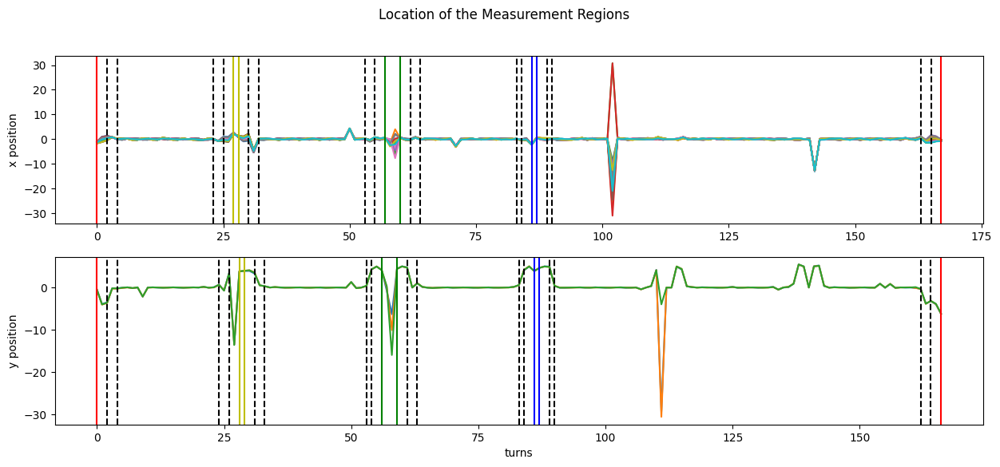

In [9]:
fig, Ax = plt.subplots(2, 1, figsize = (15, 6))
for i in range(30, 50):
    Ax[0].plot(Pos_xbpms[i, :])
fig.suptitle("Location of the Measurement Regions")

#IP6
Ax[0].axvline(x = 163, color = 'k', ls = '--')
Ax[0].axvline(x = 165, color = 'k', ls = '--')

Ax[0].axvline(x = 167, color = 'r')
Ax[0].axvline(x = 0, color = 'r')

Ax[0].axvline(x = 2, color = 'k', ls = '--')
Ax[0].axvline(x = 4, color = 'k', ls = '--')

#IP8
Ax[0].axvline(x = 23, color = 'k', ls = '--')
Ax[0].axvline(x = 25, color = 'k', ls = '--')

Ax[0].axvline(x = 27, color = 'y')
Ax[0].axvline(x = 28, color = 'y')

Ax[0].axvline(x = 30, color = 'k', ls = '--')
Ax[0].axvline(x = 32, color = 'k', ls = '--')

#IP10
Ax[0].axvline(x = 53, color = 'k', ls = '--')
Ax[0].axvline(x = 55, color = 'k', ls = '--')

Ax[0].axvline(x = 57, color = 'g')
Ax[0].axvline(x = 60, color = 'g')

Ax[0].axvline(x = 62, color = 'k', ls = '--')
Ax[0].axvline(x = 64, color = 'k', ls = '--')

#IP12
Ax[0].axvline(x = 83, color = 'k', ls = '--')
Ax[0].axvline(x = 84, color = 'k', ls = '--')

Ax[0].axvline(x = 86, color = 'b')
Ax[0].axvline(x = 87, color = 'b')

Ax[0].axvline(x = 89, color = 'k', ls = '--')
Ax[0].axvline(x = 90, color = 'k', ls = '--')

Ax[1].plot(Pos_ybpms[35, :])
Ax[1].plot(Pos_ybpms[36, :])
Ax[1].plot(Pos_ybpms[39, :])

#IP6
Ax[1].axvline(x = 162, color = 'k', ls = '--')
Ax[1].axvline(x = 164, color = 'k', ls = '--')

Ax[1].axvline(x = 0, color = 'r')
Ax[1].axvline(x = 166, color = 'r')

Ax[1].axvline(x = 2, color = 'k', ls = '--')
Ax[1].axvline(x = 4, color = 'k', ls = '--')

#IP8
Ax[1].axvline(x = 24, color = 'k', ls = '--')
Ax[1].axvline(x = 26, color = 'k', ls = '--')

Ax[1].axvline(x = 28, color = 'y')
Ax[1].axvline(x = 29, color = 'y')

Ax[1].axvline(x = 31, color = 'k', ls = '--')
Ax[1].axvline(x = 33, color = 'k', ls = '--')

#IP10
Ax[1].axvline(x = 53, color = 'k', ls = '--')
Ax[1].axvline(x = 54, color = 'k', ls = '--')

Ax[1].axvline(x = 56, color = 'g')
Ax[1].axvline(x = 59, color = 'g')

Ax[1].axvline(x = 61, color = 'k', ls = '--')
Ax[1].axvline(x = 63, color = 'k', ls = '--')

#IP12
Ax[1].axvline(x = 83, color = 'k', ls = '--')
Ax[1].axvline(x = 84, color = 'k', ls = '--')

Ax[1].axvline(x = 86, color = 'b')
Ax[1].axvline(x = 87, color = 'b')

Ax[1].axvline(x = 89, color = 'k', ls = '--')
Ax[1].axvline(x = 90, color = 'k', ls = '--')

Ax[0].set_ylabel("x position")

Ax[1].set_xlabel("turns")
Ax[1].set_ylabel("y position")

plt.show()

In [10]:
# Drift_bpmx = [(163, 165), (167, 0), (2, 4), (23, 25), (27, 28), (30, 32),
#               (53, 55), (57, 60), (62, 64), (83, 84), (86, 87), (89, 90)]
# Drift_bpmy = [(162, 164), (166, 0), (2, 4), (24, 26), (28, 29), (31, 33),
#               (53, 54), (56, 59), (61, 63), (83, 84), (86, 87), (89, 90)]

for i in range(len(Name_ybpms)):
    print(i, Name_ybpms[i])

0 g6-bx
1 bo6-b1
2 bo6-b3
3 bo6-b3.1
4 bo6-b4
5 bo6-bv5
6 bo6-b7
7 bo6-b8
8 bo6-bv9
9 bo6-bv11
10 bo6-bv13
11 bo6-bv15
12 bo6-bv17
13 bo6-bv19
14 bo7-bv21
15 bo7-bv19
16 bo7-bv17
17 bo7-bv15
18 bo7-bv13
19 bo7-bv11
20 bo7-bv9
21 bo7-b8
22 bo7-b7
23 bo7-bv5
24 bo7-b4
25 bo7-b3.1
26 bo7-b3
27 bo7-b1
28 g7-bx
29 g8-bx
30 bi8-b1
31 bi8-b3
32 bi8-b3.1
33 bi8-b4
34 bi8-bv6
35 bi8-b7
36 bi8-b8
37 bi8-bv10
38 bi8-bv12
39 bi8-bv14
40 bi8-bv16
41 bi8-bv18
42 bi8-bv20
43 bi9-bv20
44 bi9-bv18
45 bi9-bv16
46 bi9-bv14
47 bi9-bv12
48 bi9-bv10
49 bi9-b8
50 bi9-b7.1
51 bi9-b7
52 bi9-bv6
53 bi9-b4
54 bi9-b3
55 bi9-b1
56 g9-bx
57 g9-bx.2
58 g9-bx.1
59 g10-bx
60 bo10-b1
61 bo10-b3
62 bo10-b3.1
63 bo10-b4
64 bo10-bv5
65 bo10-b7
66 bo10-b8
67 bo10-bv9
68 bo10-bv11
69 bo10-bv13
70 bo10-bv15
71 bo10-bv17
72 bo10-bv19
73 bo11-bv21
74 bo11-bv19
75 bo11-bv17
76 bo11-bv15
77 bo11-bv13
78 bo11-bv11
79 bo11-bv9
80 bo11-b8
81 bo11-b7
82 bo11-bv5
83 bo11-b4
84 bo11-b3
85 bo11-b1
86 g11-bx
87 g12-bx
88 bi12-b1
89 bi12

# Linear Regression Calculation

In [11]:
def Mat_param(result):
    M = result.coef_
    det = np.linalg.det(M)
    
    M /= (np.sqrt(det))
    return M
    
def Twiss_calc(M, Data):
    if M[0, 1] > 0:
        phi = np.arccos((M[0, 0] + M[1, 1])/2)
    else: phi = 2*np.pi - np.arccos((M[0, 0] + M[1, 1])/2)
    beta = M[0, 1]/np.sin(phi)
    alpha = (M[0, 0] - M[1, 1])/(2*np.sin(phi))
    beta2 = -(alpha**2 + 1)*np.sin(phi)/M[1, 0]

    tune = phi/(2*np.pi)
    Twiss = np.array([tune, phi, alpha, beta])
    Data.extend(Twiss)

    return Twiss

In [12]:
def LR_calculation(Interval, Bpms, ishor, BPM, S_bpms, Name, BetBPMModel, AlfBPMModel, unExp = True, isPlot = False):
    bpm1, bpm2 = Bpms
    b1_m, b2_m = BetBPMModel[bpm1], BetBPMModel[bpm2]
    a1_m, a2_m = AlfBPMModel[bpm1], AlfBPMModel[bpm2]
    if ishor:
        axis = "x"
    else:
        axis = "y"
    Data1 = [Name[bpm1], bpm1]
    Data2 = [Name[bpm2], bpm2]
    
    def transformtbt(tbt, bpm, initial_turn, coord, Data):
        n_turns = len(tbt)
        n_more = n_turns + 1
        x = np.linspace(0, n_turns - 1, n_turns)
        # Define the exponential function to fit
        b_guess = -0.025
        upper = [np.inf, 10, 10, 1, np.pi]
        lower = [-np.inf, 0, 0, 0, -np.pi]
        
        bounds = optimize.Bounds(lower, upper)
        
        def exponential_func(x, a, b, c, d):
            return a * np.exp(b * x)*np.cos(2*np.pi*c *x + d)
        if ishor:
            tune = BPMx0_Tune_scipy
        else:
            tune = BPMy0_Tune_scipy
        Amp = (np.max(tbt) - np.min(tbt))/2
        popt, pcov = optimize.curve_fit(exponential_func, x, tbt, [Amp, b_guess, tune, 0])
        a_fit, b_fit, c_fit, d_fit = popt
        x_plot = np.linspace(initial_turn, initial_turn + n_turns, n_turns)
        fitted_curve = exponential_func(x, a_fit, b_fit, c_fit, d_fit)

        if isPlot:
            fig, Ax = plt.subplots(1, 2, figsize=(15, 6))
            Ax[0].plot(x_plot, tbt, 'k-', label='Original Data')
            Ax[0].plot(x_plot, fitted_curve, 'r-', label='Fitted Exponential', alpha = .5)
            Ax[0].plot(x_plot, tbt - fitted_curve, 'b-', label='difference')
            Ax[0].set_xlabel("turns")
            Ax[0].set_ylabel("%s [mm], %s"%(coord, Name[bpm]))
            Ax[0].legend()
    
        def exponential_func_mod(x, a, c, d):
            return a * np.cos(2*np.pi*c*x + d)
        x_more = np.linspace(0, n_more - 1, n_more)
        fitted_curve_mod = exponential_func_mod(x_more, a_fit, c_fit, d_fit)
        if isPlot:
            Ax[1].plot(x_more, fitted_curve_mod)
            Ax[1].set_xlabel("turns")
            Ax[1].set_ylabel("%s [mm], %s"%(coord, Name[bpm]))
            plt.show()
        return fitted_curve_mod
    
    #Organize position and speed data
    initial_turn, interval_turn = Interval
        
    # Scaled position and speed between two bpms
    C = 3833.845181
    if S_bpms[0, bpm1] > S_bpms[0, bpm2]: 
        L = S_bpms[0, bpm2] - S_bpms[0, bpm1] + C
        x_data1_all = BPM[bpm1][:-1] - np.mean(BPM[bpm1])
        x_data2_all = BPM[bpm2][1:] - np.mean(BPM[bpm2])
    else: 
        L = S_bpms[0, bpm2] - S_bpms[0, bpm1]
        x_data1_all = BPM[bpm1] - np.mean(BPM[bpm1])
        x_data2_all = BPM[bpm2] - np.mean(BPM[bpm2])
    xp_data_all = (x_data2_all - x_data1_all)/L
    # variable data: x_data (bpm, var) (current turn)
    n_turns = 450
    x_data11 = x_data1_all[initial_turn: initial_turn + interval_turn]
    x_data12 = xp_data_all[initial_turn: initial_turn + interval_turn]
    
    x_data21 = x_data2_all[initial_turn: initial_turn + interval_turn]

    if unExp:
        x_data11_trans = transformtbt(x_data11, bpm1, initial_turn, "$%s_i$"%axis, Data1)
        x_data12_trans = transformtbt(x_data12, bpm1, initial_turn, "$%s'_i$"%axis, Data1)
        x_data21_trans = transformtbt(x_data21, bpm2, initial_turn, "$%s_i$"%axis, Data2)

    x_data11 = x_data11_trans[:interval_turn]
    x_data12 = x_data12_trans[:interval_turn]
    x_data21 = x_data21_trans[:interval_turn]
    x_data22 = np.copy(x_data12)

    X_data1 = np.vstack((x_data11, x_data12)).T
    X_data2 = np.vstack((x_data21, x_data22)).T

    # Y Train data (next turn)
    y_data11 = x_data11_trans[1:interval_turn + 1]
    y_data12 = x_data12_trans[1:interval_turn + 1]

    y_data21 = x_data21_trans[1:interval_turn + 1]
    y_data22 = np.copy(y_data12)

    Y_data1 = np.vstack((y_data11, y_data12)).T
    Y_data2 = np.vstack((y_data21, y_data22)).T

            
    #LR Calculation:
    # Y = MX + B; M: 2x2
    result1 = LinearRegression().fit(X_data1, Y_data1)
    result2 = LinearRegression().fit(X_data2, Y_data2)

    #Correlation:
    corr1 = result1.score(X_data1, Y_data1)
    corr2 = result2.score(X_data2, Y_data2)
    
    #Prediction: Visualize correlation
    pred1 = result1.predict(X_data1)
    pred2 = result2.predict(X_data2)
    if isPlot:
        fig, Ax = plt.subplots(1, 2, figsize=(15, 6))
        Ax[0].scatter(pred1, Y_data1)
        Ax[0].set_title("prediction vs real for left bpm")
        Ax[0].set_xlabel("predicted next turn values")
        Ax[0].set_ylabel("Actual next turn values")
        
        Ax[1].scatter(pred2, Y_data2)
        Ax[1].set_title("prediction vs real for right bpm")
        Ax[1].set_xlabel("predicted next turn values")
        Ax[1].set_ylabel("Actual next turn values")
        plt.show()
    
    # Get Matrix M
    M1 = Mat_param(result1)
    M2 = Mat_param(result2)
    
    # Calculate Twiss parameters
    # print("Tune from bpm 1 & 2:")
    Twiss1 = Twiss_calc(M1, Data1)
    Twiss2 = Twiss_calc(M2, Data2)
    tune1, phi1, alf1, bet1 = Twiss1
    tune2, phi2, alf2, bet2 = Twiss2
    
    # beta beat at bpm 1, 2:
    beat1 = (b1_m - bet1)/b1_m
    beat2 = (b2_m - bet2)/b2_m
    Data1.extend([b1_m, beat1])
    Data2.extend([b2_m, beat2])
    
    ### Phase Space Normalization ###
    # MADx
    x_data11_norm_m = x_data11/np.sqrt(b1_m)
    x_data12_norm_m = x_data11*a1_m/np.sqrt(b1_m) + x_data12*np.sqrt(b1_m)
    x_data21_norm_m = x_data21/np.sqrt(b2_m)
    x_data22_norm_m = x_data21*a2_m/np.sqrt(b2_m) + x_data22*np.sqrt(b2_m)

    # Phase Calculation from normalization
    Phi1_m = np.zeros(interval_turn)
    Phi2_m = np.zeros(interval_turn)
    for i in range(interval_turn):
         Phi1_m[i] = np.arctan(x_data12_norm_m[i]/x_data11_norm_m[i])*180/np.pi
         Phi2_m[i] = np.arctan(x_data22_norm_m[i]/x_data21_norm_m[i])*180/np.pi

    # LR results
    x_data11_norm = x_data11/np.sqrt(bet1)
    x_data12_norm = x_data11*alf1/np.sqrt(bet1) + x_data12*np.sqrt(bet1)
    x_data21_norm = x_data21/np.sqrt(bet2)
    x_data22_norm = x_data21*alf2/np.sqrt(bet2) + x_data22*np.sqrt(bet2)
    r1 = np.sqrt(x_data11_norm**2 + x_data12_norm**2)
    r2 = np.sqrt(x_data21_norm**2 + x_data22_norm**2)
    r1_mean, r1_std = np.mean(r1), np.std(r1)
    r2_mean, r2_std = np.mean(r2), np.std(r2)

    Phi1 = np.zeros(interval_turn)
    Phi2 = np.zeros(interval_turn)
    for i in range(interval_turn):
         Phi1[i] = np.arctan(x_data12_norm[i]/x_data11_norm[i])*180/np.pi
         Phi2[i] = np.arctan(x_data22_norm[i]/x_data21_norm[i])*180/np.pi
    
    if isPlot:
        # Phi Measurement
        fig, Ax = plt.subplots(1, 2, figsize=(15, 6))
        Ax[0].plot(Phi1, '-o', ms = 2, label = "local")
        Ax[0].plot(Phi1_m, '-o', ms = 2, label = "model", alpha = .5)
        Ax[0].set_title("phase vs interval for %s"%Name[bpm1])
        Ax[0].legend()

        Ax[1].plot(Phi2, '-o', ms = 2, label = "local")
        Ax[1].plot(Phi2_m, '-o', ms = 2, label = "model", alpha = .5)
        Ax[1].set_title("phase vs interval for %s"%Name[bpm2])
        Ax[1].legend()
        plt.show()

        # Unnormalized PS:
        fig, Ax = plt.subplots(1, 2, figsize=(15, 6))
        Ax[0].scatter(x_data11, x_data12, label = "original", color='r')
        Ax[0].set_ylabel("%s' [mrad]"%axis)
        Ax[0].set_xlabel("%s [mm], %s"%(axis, Name[bpm1]))
        Ax[0].legend()
        
        Ax[1].scatter(x_data21, x_data22, label = "original", color='r')
        Ax[1].set_ylabel("%s' [mrad]"%axis)
        Ax[1].set_xlabel("%s [mm], %s"%(axis, Name[bpm2]))
        Ax[1].legend()
        plt.show()

        # Renormalized Phase Space
        print("r1 mean, std:", r1_mean, r1_std)
        fig, Ax = plt.subplots(1, 2, figsize=(15, 6))
        Ax[0].scatter(x_data11_norm, x_data12_norm, label = "local", color='r')
        Ax[0].scatter(x_data11_norm_m, x_data12_norm_m, label = "model", alpha = .5, color='b')
        Ax[0].set_ylabel("%s' [mrad]"%axis)
        Ax[0].set_xlabel("%s [mm], %s"%(axis, Name[bpm1]))
        Ax[0].legend()
        
        print("r2 mean, std:", r2_mean, r2_std)
        Ax[1].scatter(x_data21_norm, x_data22_norm, label = "local", color='r')
        Ax[1].scatter(x_data21_norm_m, x_data22_norm_m, label = "model", alpha = .5, color='b')
        Ax[1].set_ylabel("%s' [mrad]"%axis)
        Ax[1].set_xlabel("%s [mm], %s"%(axis, Name[bpm2]))
        Ax[1].legend()
    
    return Data1, Data2

In [13]:
def bpm_signals(Bpms, BPM, Intervals, Name_bpms, ishor):
    x = np.linspace(0, N_turns, N_turns)
    fig, Ax = plt.subplots(1, 2, figsize=(15, 3))

    for i, bpm in enumerate(Bpms):
        BPM0 = BPM[bpm]
        BPM0_mean = np.mean(BPM0)

        Ax[i].plot(x, BPM0)
        Ax[i].axhline(y = BPM0_mean, color = 'b', linestyle = '-', linewidth = .75, label = r"mean = %f"%BPM0_mean)
        Ax[i].axvline(x = Intervals[0], color = 'k', linestyle = '--', linewidth = .75)
        Ax[i].axvline(x = Intervals[0] + Intervals[1], color = 'k', linestyle = '--', linewidth = .75)
        if ishor: Ax[i].set_ylabel("Horizontal Offset [mm]")
        else: Ax[i].set_ylabel("Vertical Offset [mm]")
        Ax[i].set_xlabel("Turns, %s"%Name_bpms[bpm])
        Ax[i].legend()
    plt.show()

### Around IP6

Bad Horizontal BPMs: [18, 58, 59, 75, 102, 113, 114, 122, 137, 140, 142]
Bad Vertical BPMs: [27, 57, 58, 62, 71, 111, 112, 113, 125, 140]


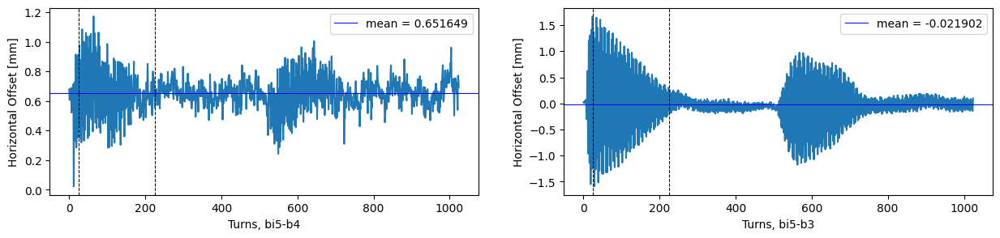

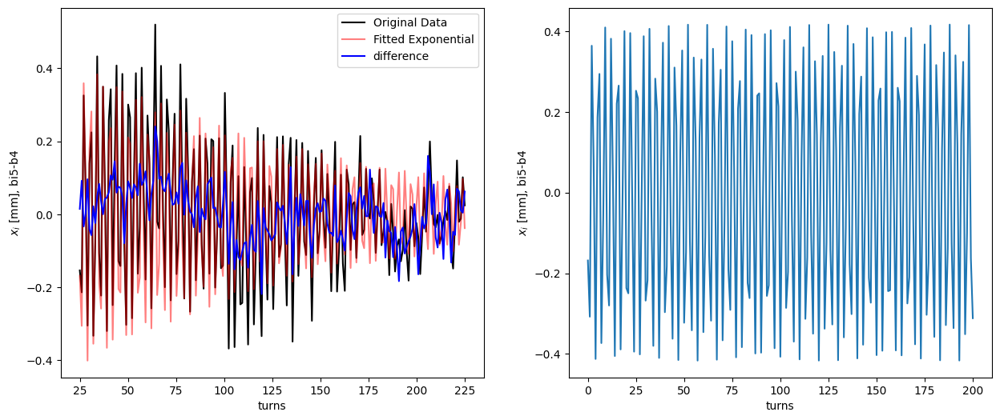

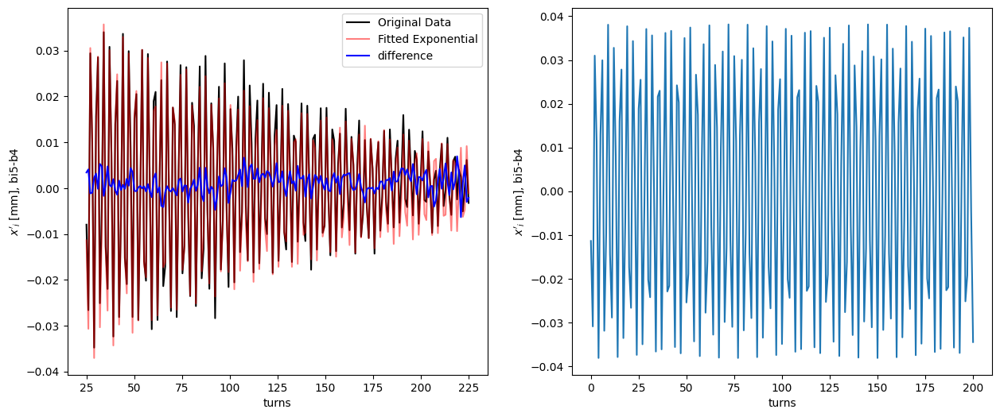

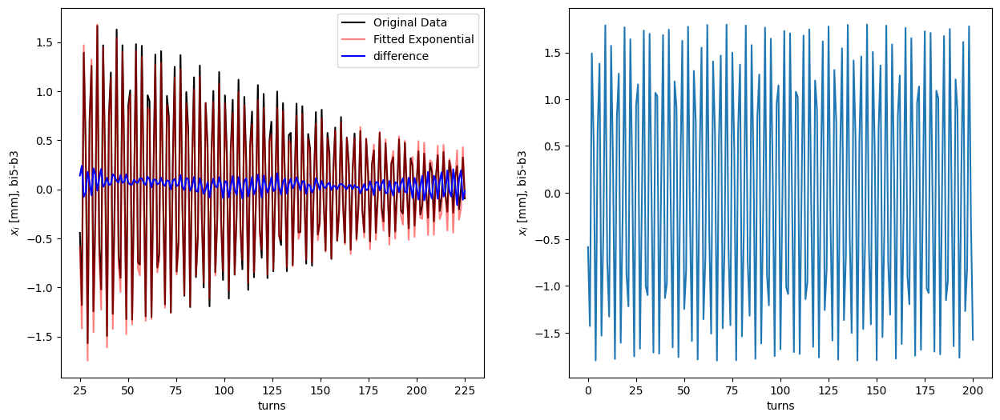

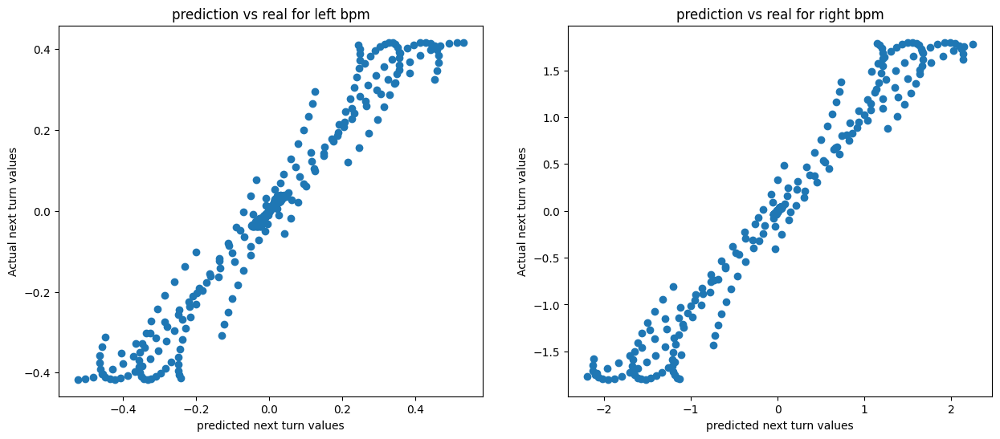

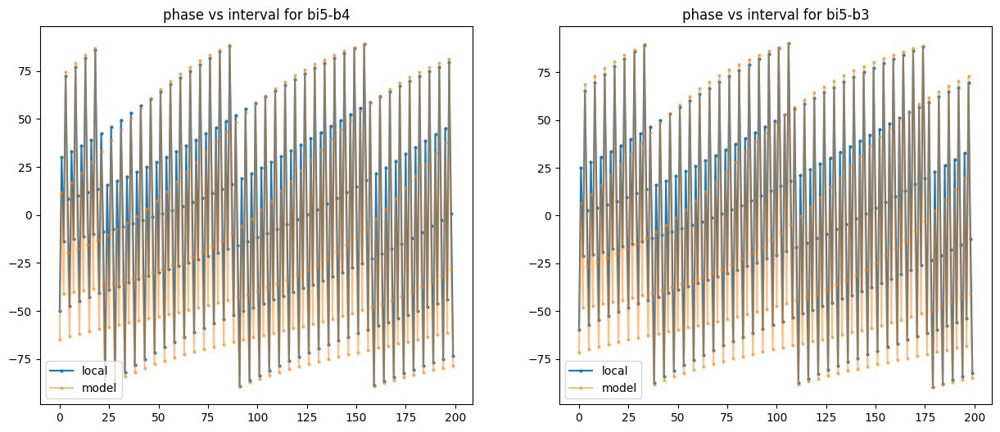

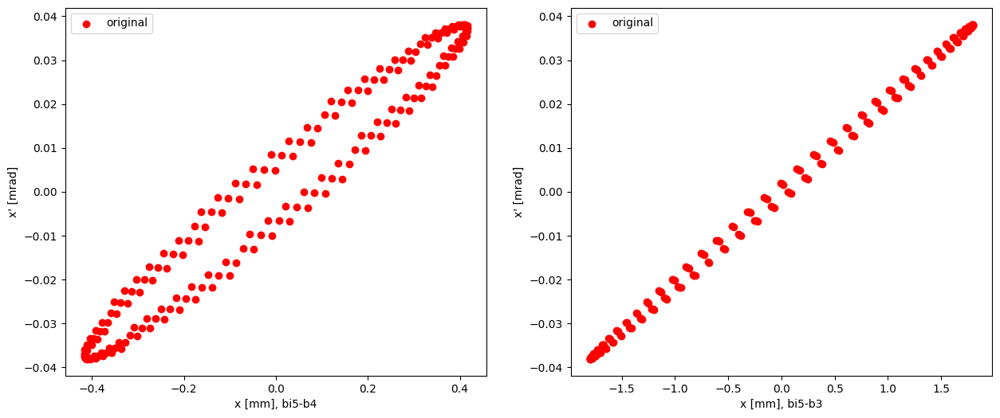

r1 mean, std: 0.056210423230945855 0.008370448512771309
r2 mean, std: 0.055338490098769934 0.007592622171912719
['bi5-b4', 163, 0.6970060655216475, 4.379418269900667, -4.80513396976927, 53.58440479356055, 70.79118234, 0.24306385311941456]
['bi5-b3', 165, 0.6973490592306167, 4.3815733629333184, -21.928805686617565, 1035.3391774020001, 1477.33283, 0.2991835310381615]


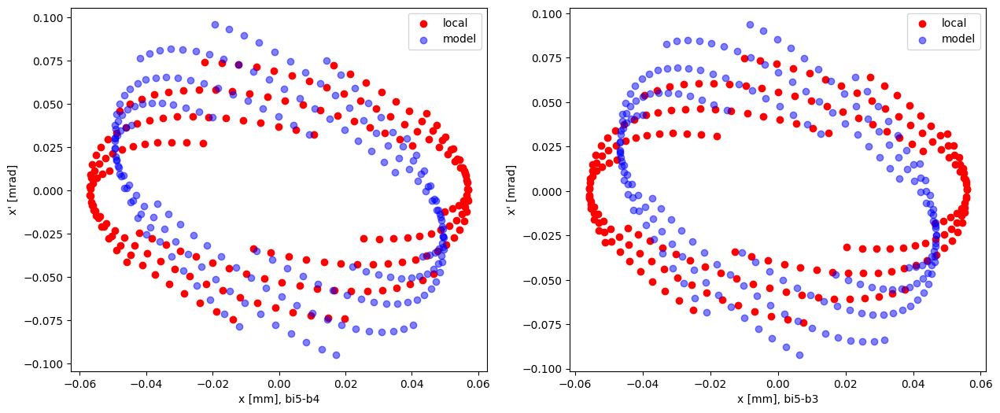

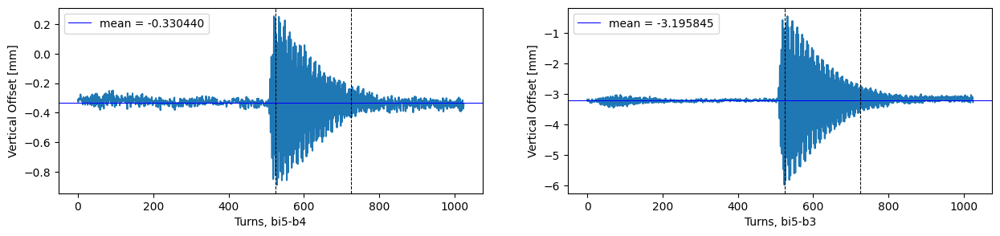

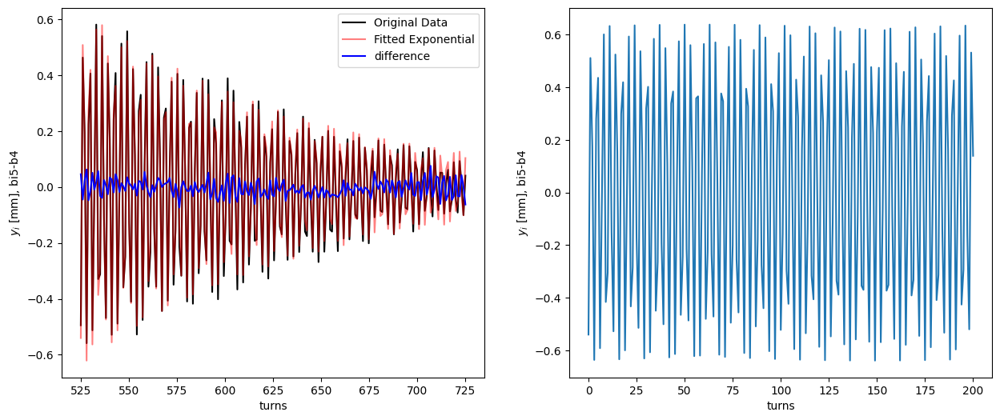

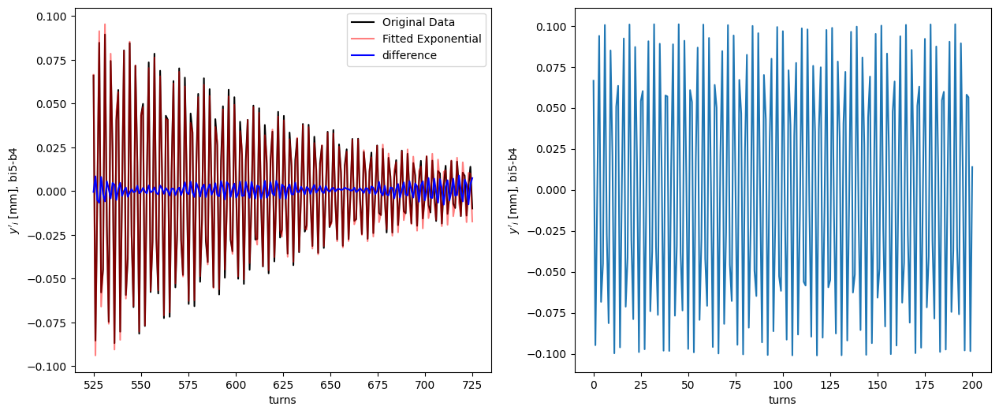

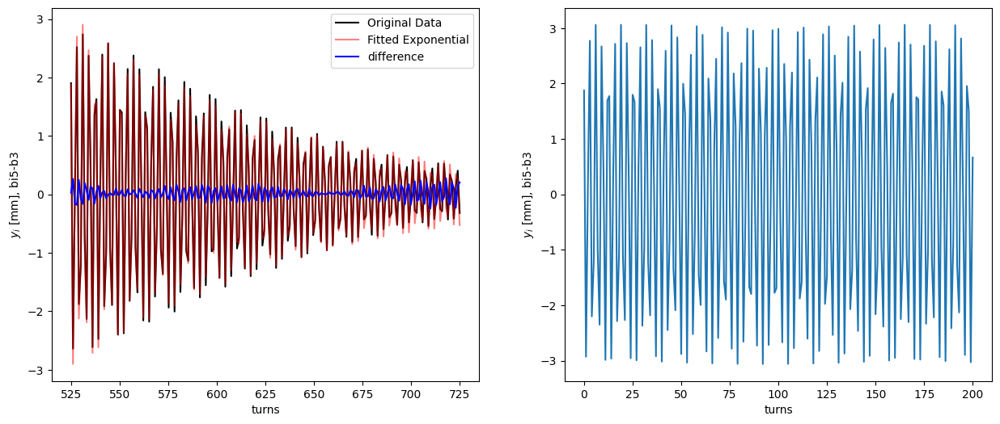

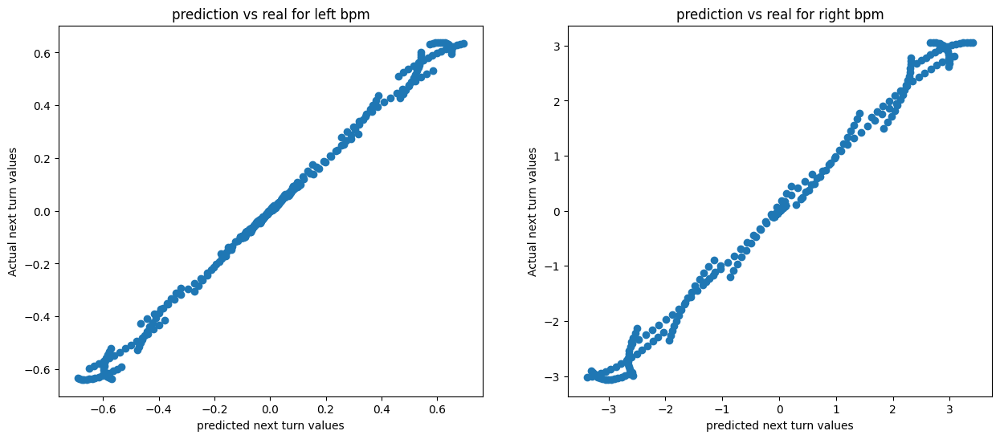

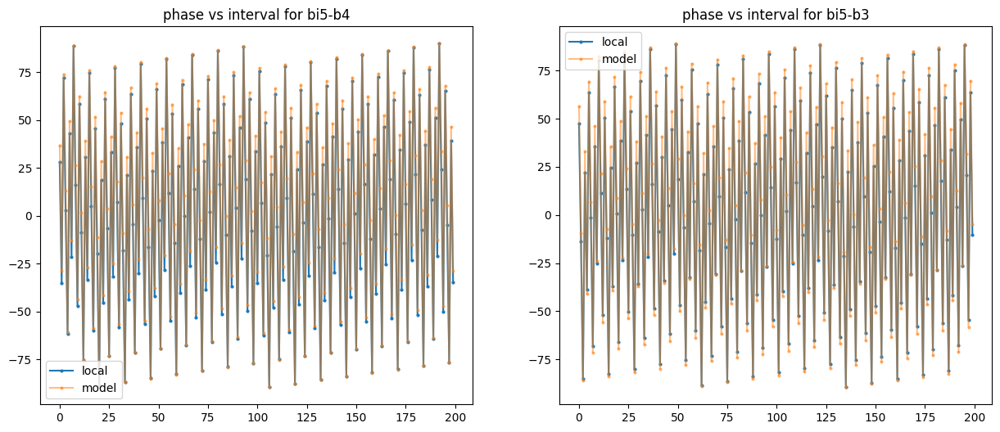

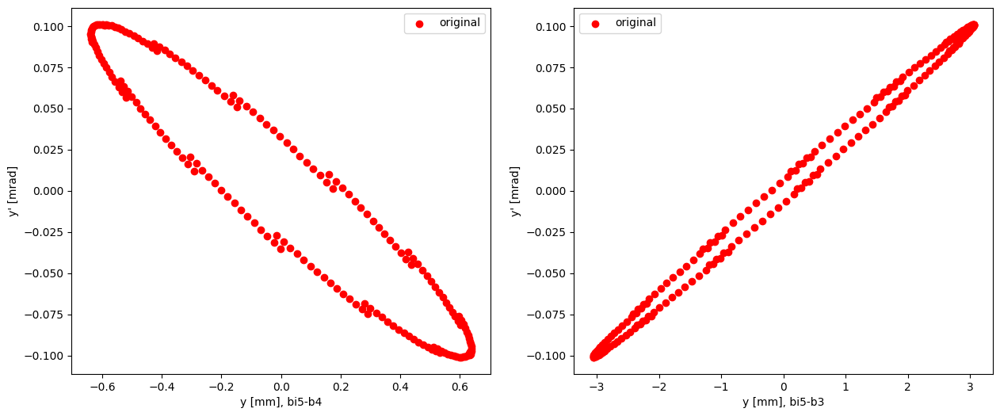

r1 mean, std: 0.1431367019954914 0.005369749610981808
r2 mean, std: 0.14727852936579133 0.008126771687156926
['bi5-b4', 162, 0.6916908529506944, 4.346021804370319, 2.9783225304920555, 19.878459689678614, 21.00462457, 0.0536150920750014]
['bi5-b3', 164, 0.6915538055111414, 4.345160709911733, -14.146726926144998, 429.7218188526681, 539.1846718, 0.20301551337114984]


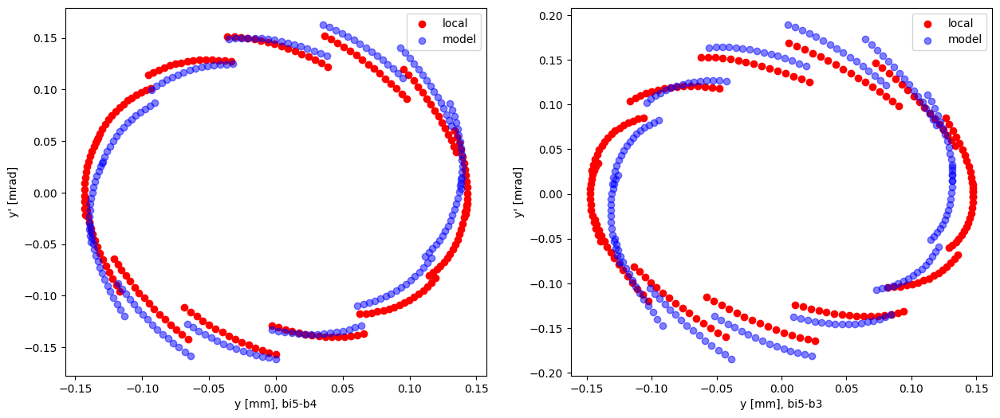

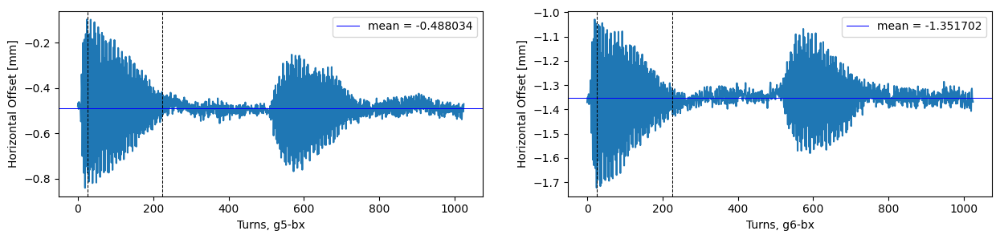

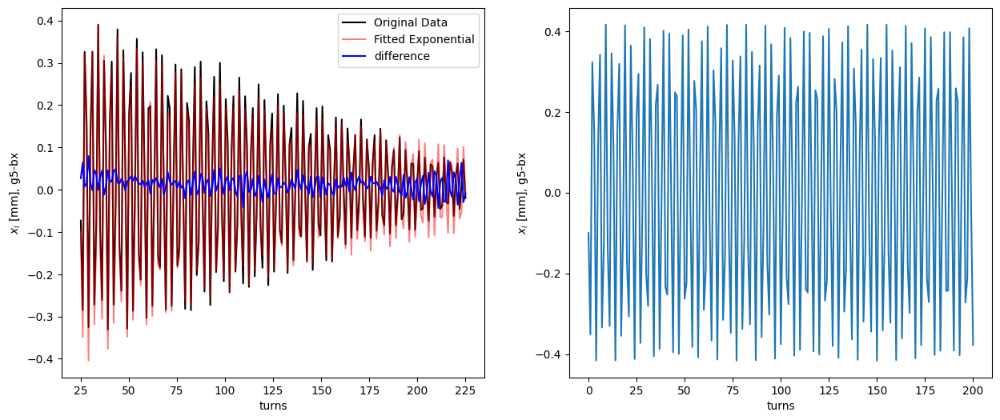

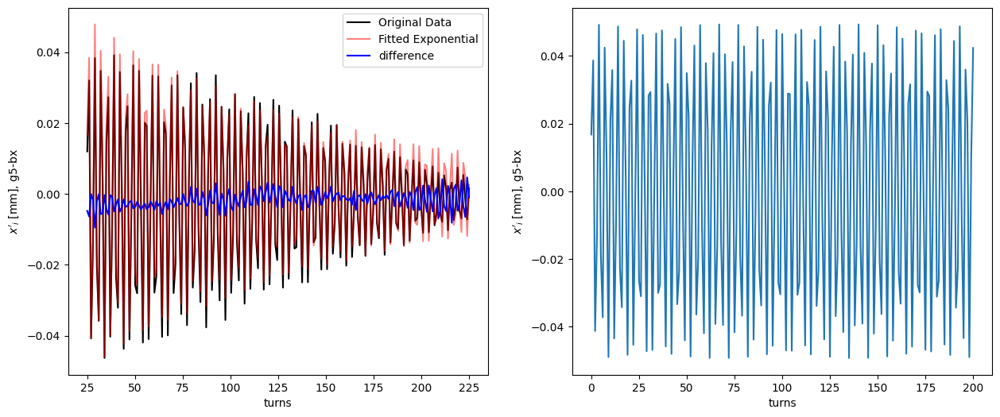

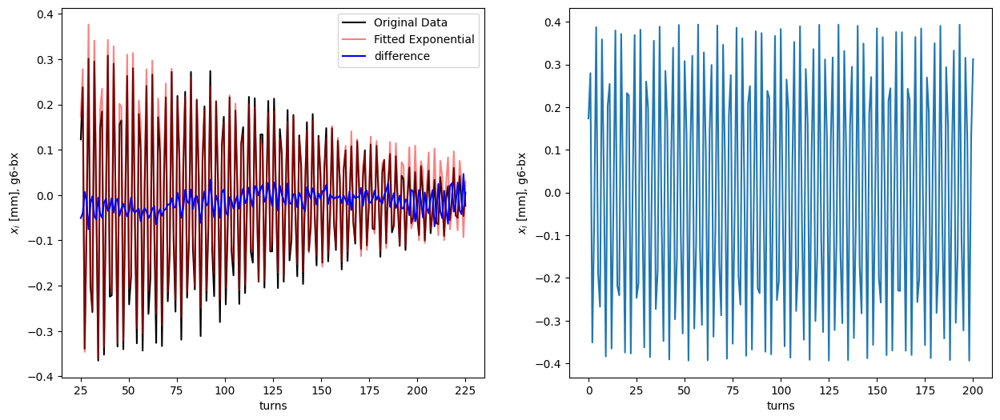

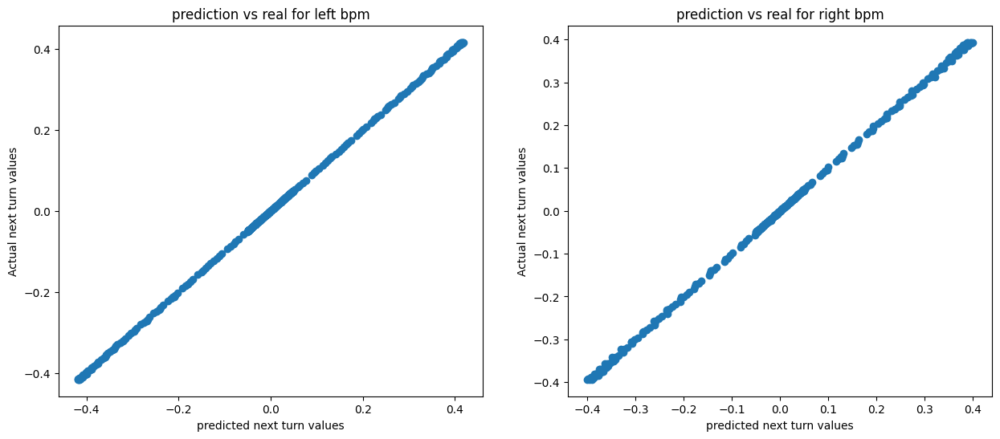

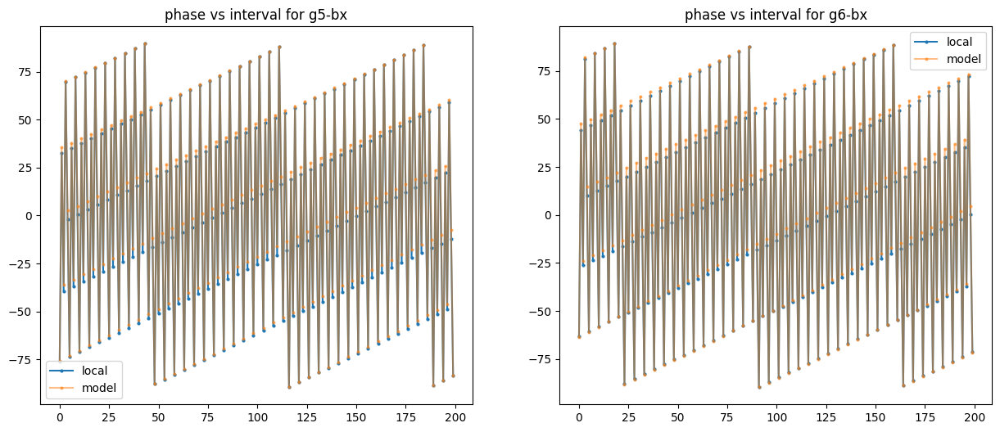

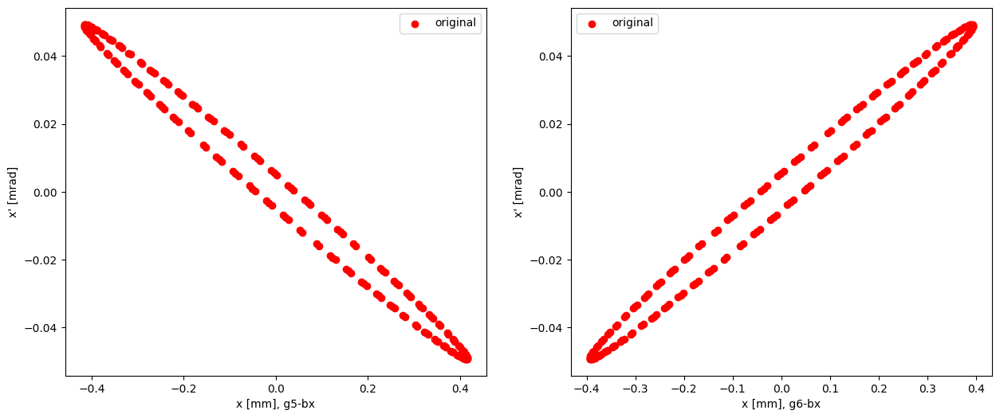

r1 mean, std: 0.04602746713434825 0.0001349601766246202
r2 mean, std: 0.04664197107709106 0.00036432330149038084
['g5-bx', 167, 0.6985978880551418, 4.389419985854756, 9.638390621232514, 81.74516637434681, 80.89815159, -0.010470137669394076]
['g6-bx', 0, 0.6985904484388256, 4.389373241366827, -8.864962148492982, 71.16434262967378, 74.81639007, 0.048813467702855905]


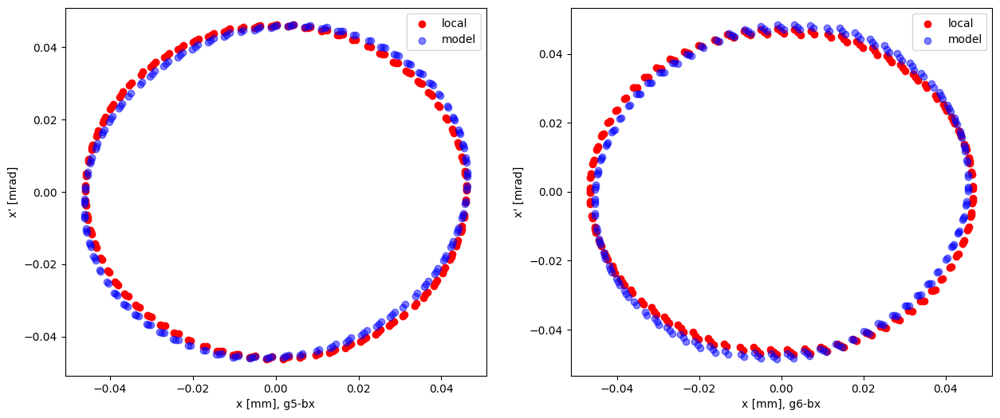

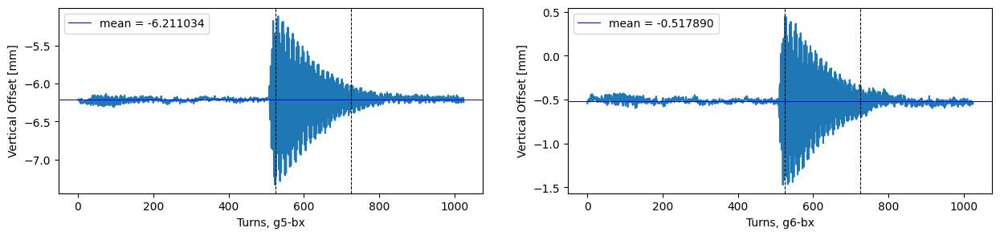

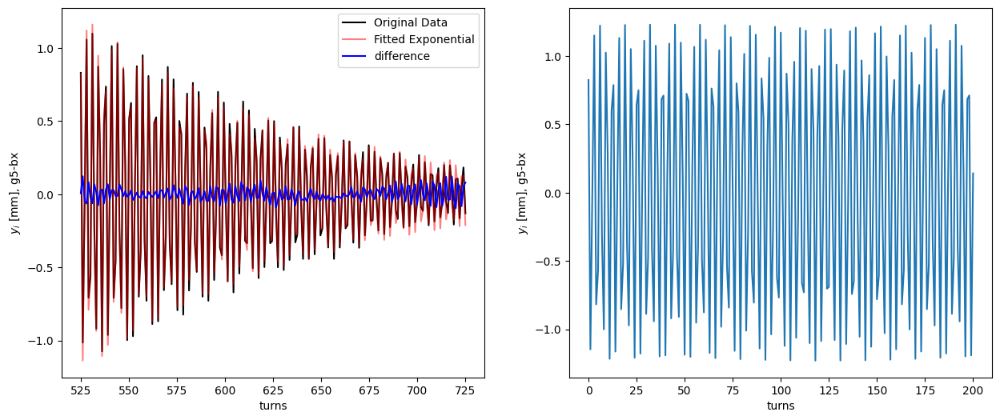

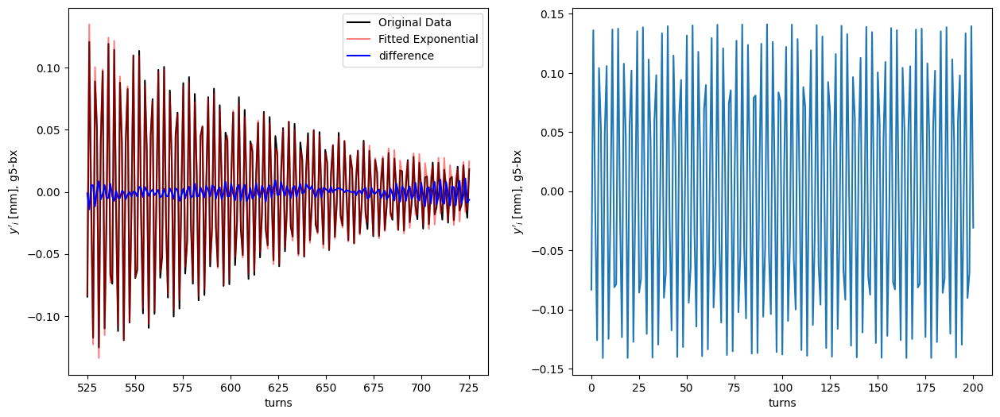

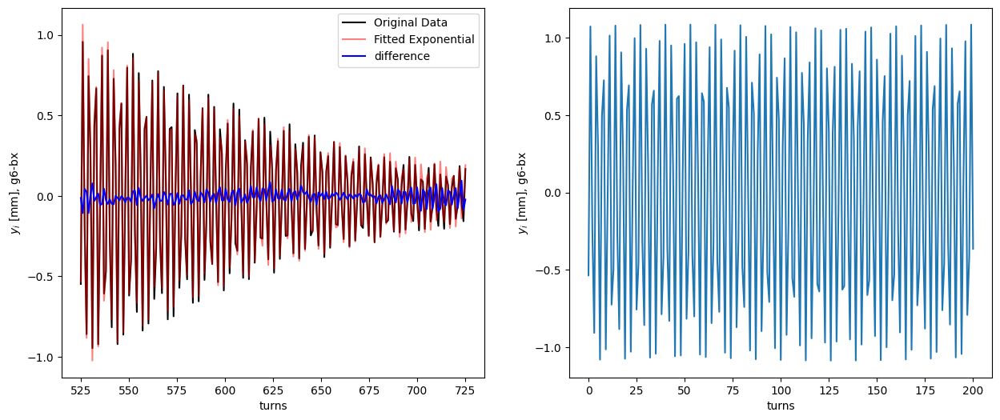

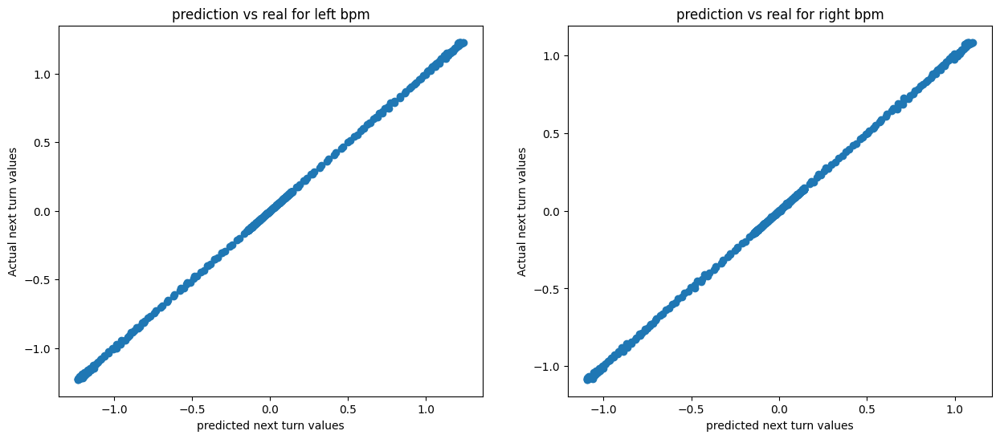

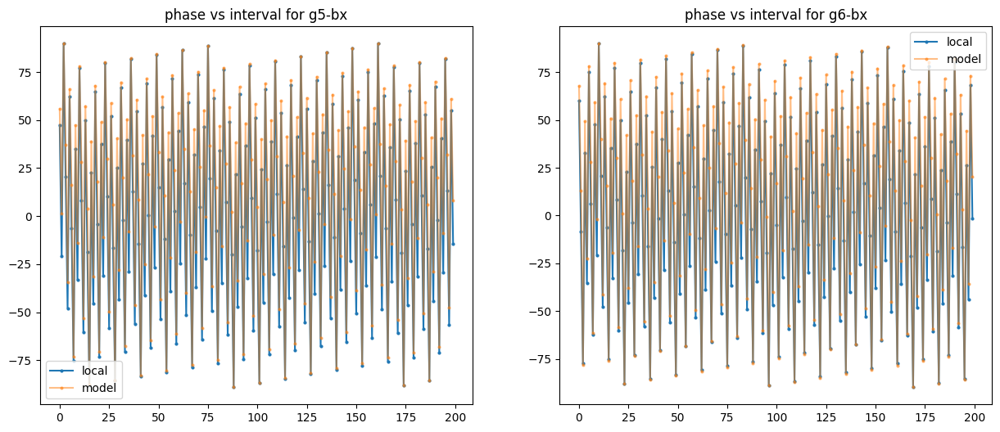

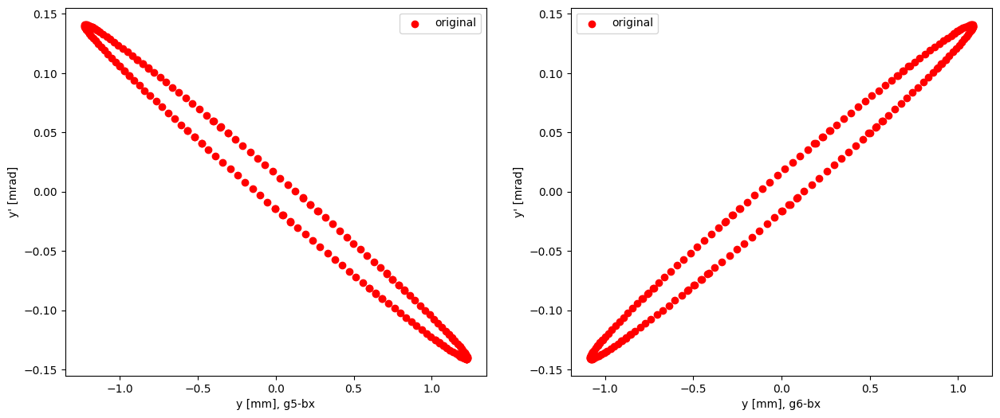

r1 mean, std: 0.1343435609421211 0.0007127467567532395
r2 mean, std: 0.13466915282291436 0.0009354811236490329
['g5-bx', 166, 0.6918172616139233, 4.346816053425819, 9.552181363082966, 83.73738375009262, 82.11920155, -0.01970528414243476]
['g6-bx', 0, 0.6918136672953479, 4.3467934696561565, -8.380652336247707, 64.98350869162135, 75.89979205, 0.14382494422629513]


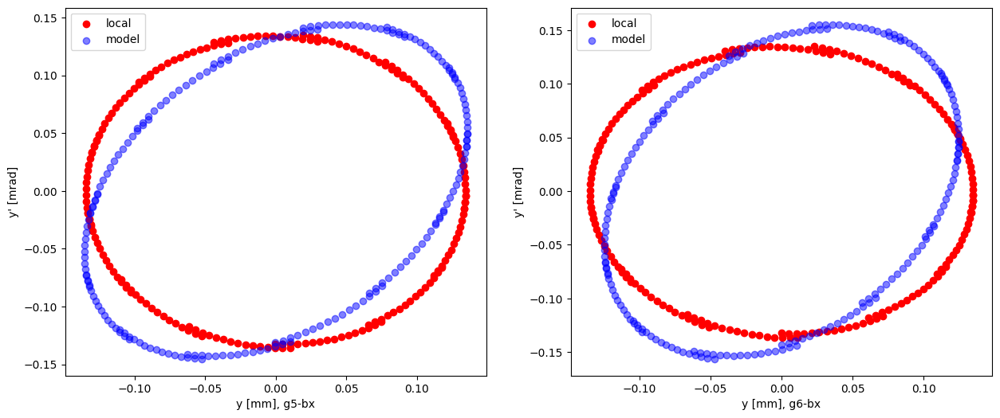

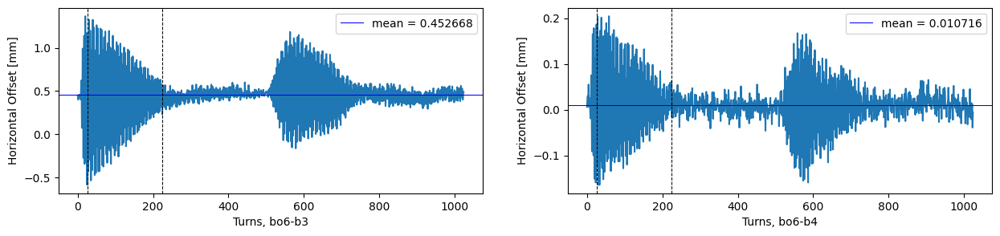

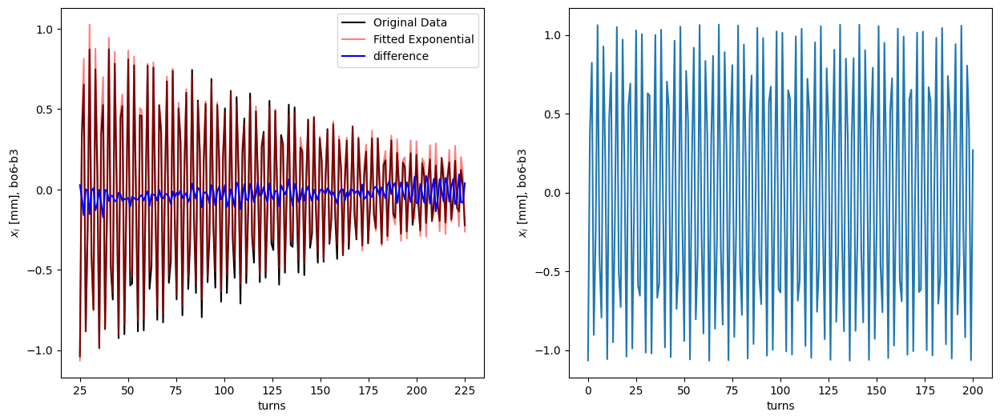

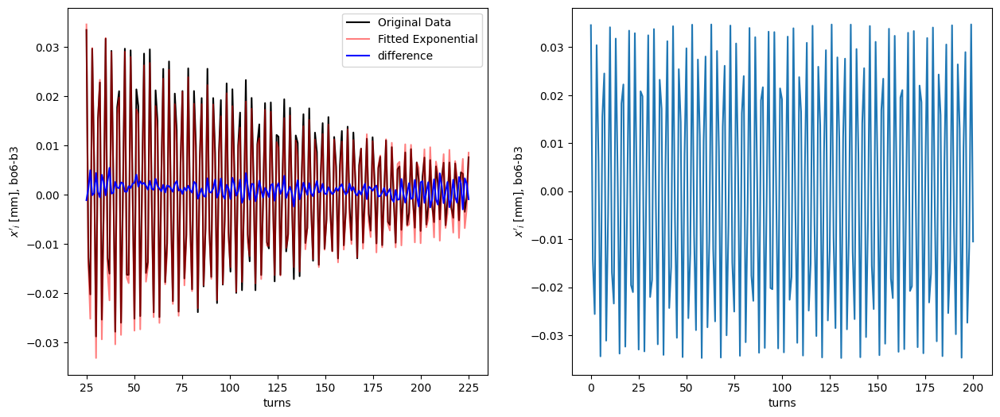

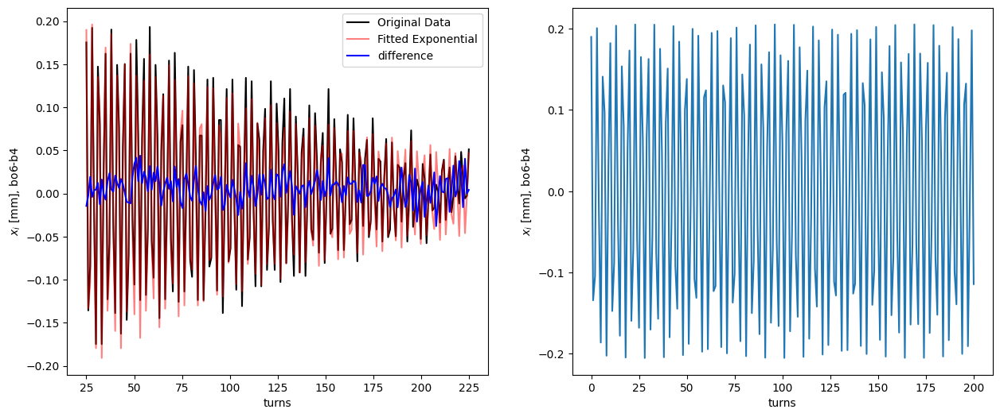

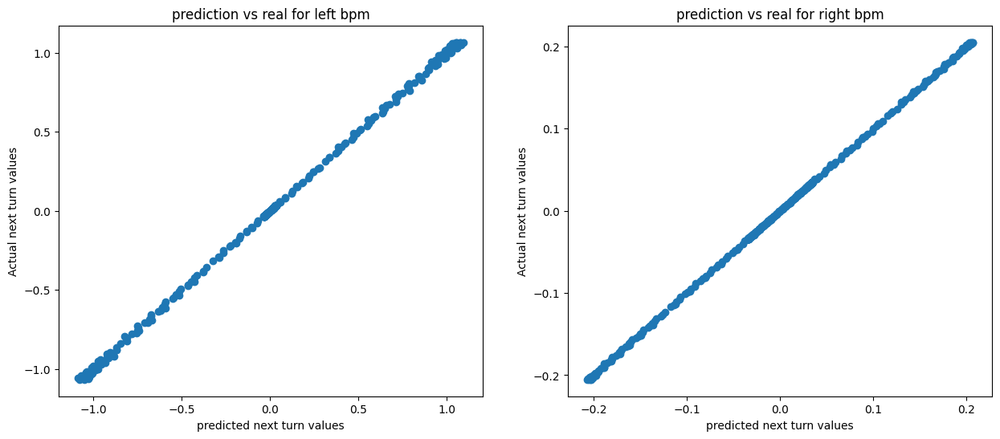

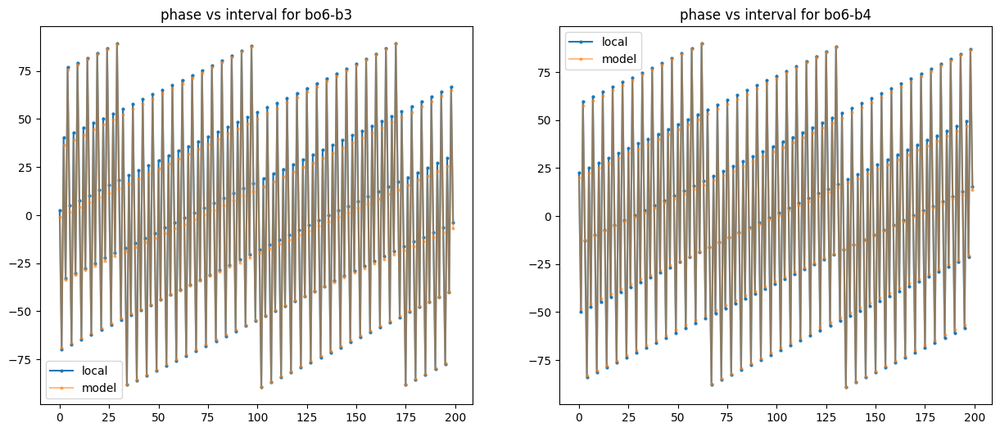

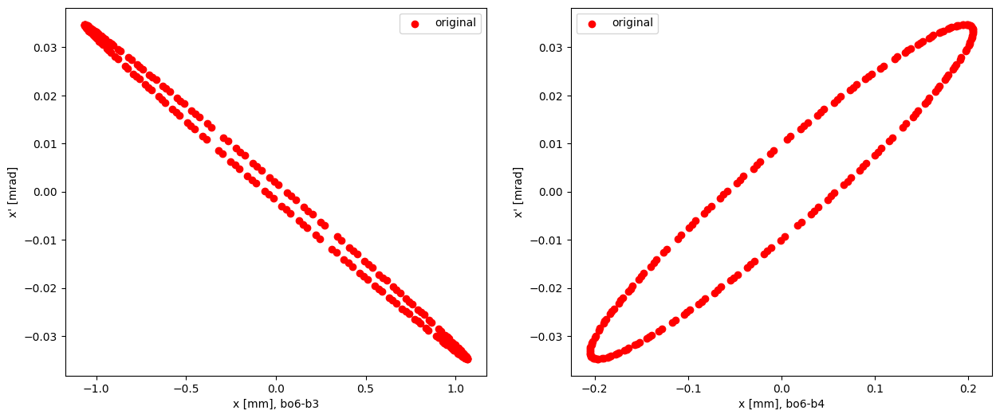

r1 mean, std: 0.0446367244733252 0.0005460983311894544
r2 mean, std: 0.045038236997202594 0.00024329411071357502
['bo6-b3', 2, 0.698566324217748, 4.389221664415405, 18.560425872720916, 570.4720978953784, 534.5534083, -0.06719382766561699]
['bo6-b4', 4, 0.6985826282679741, 4.389324105784234, -3.3675281787653533, 20.74429979941151, 19.2559119, -0.07729511368461911]


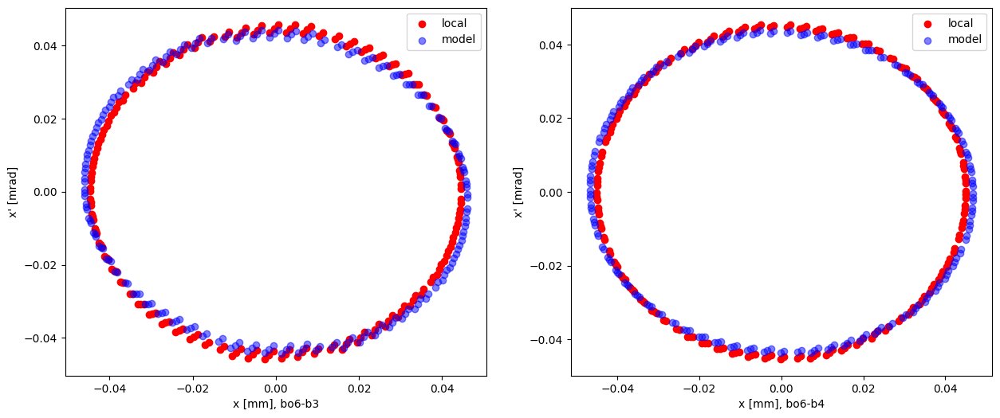

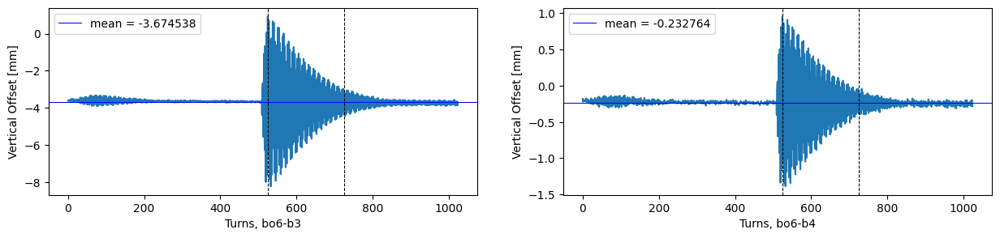

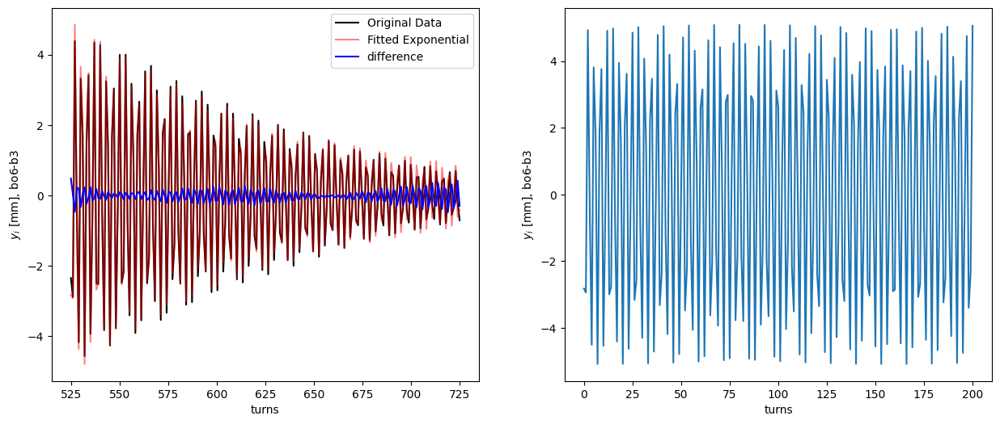

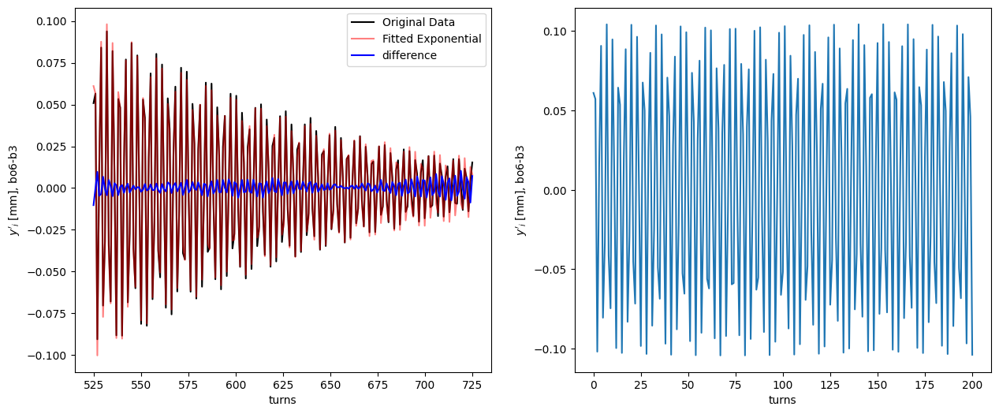

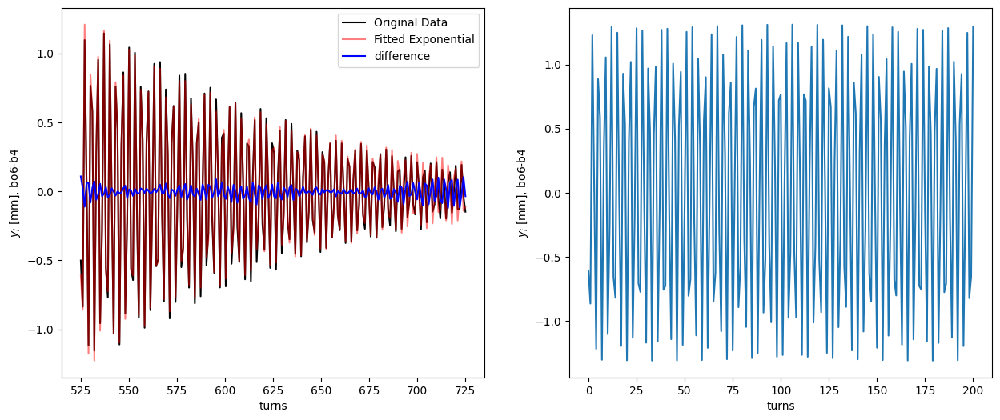

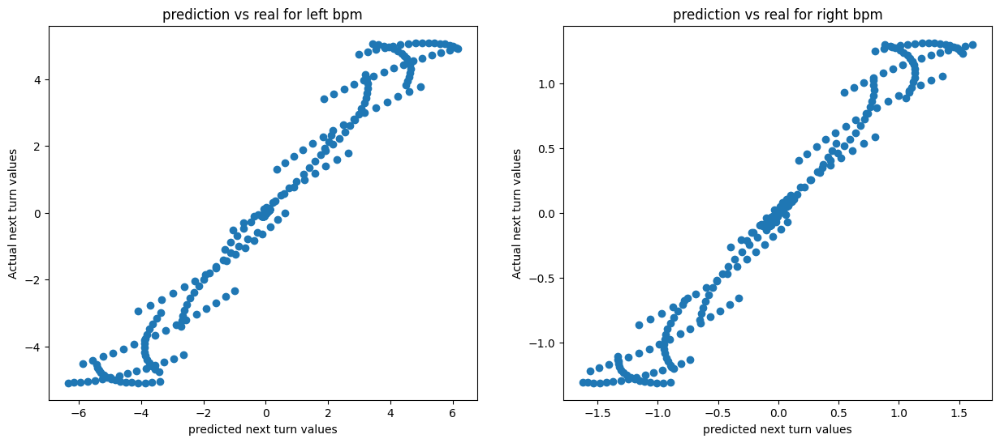

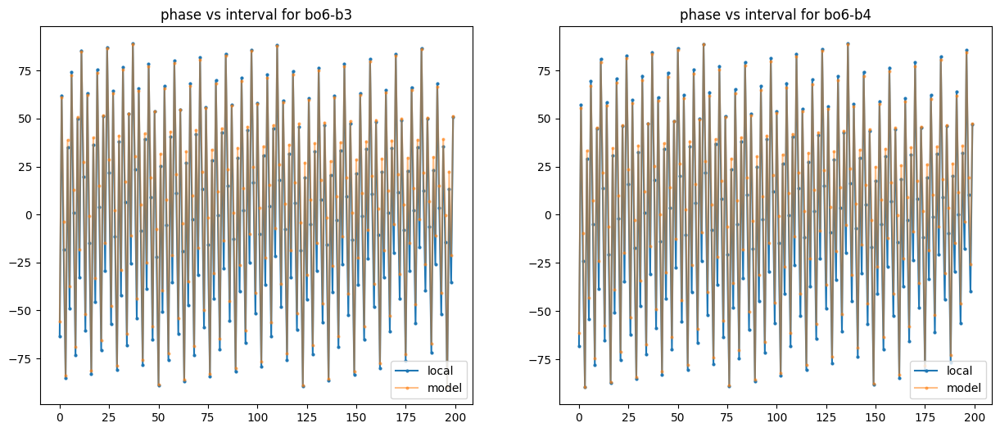

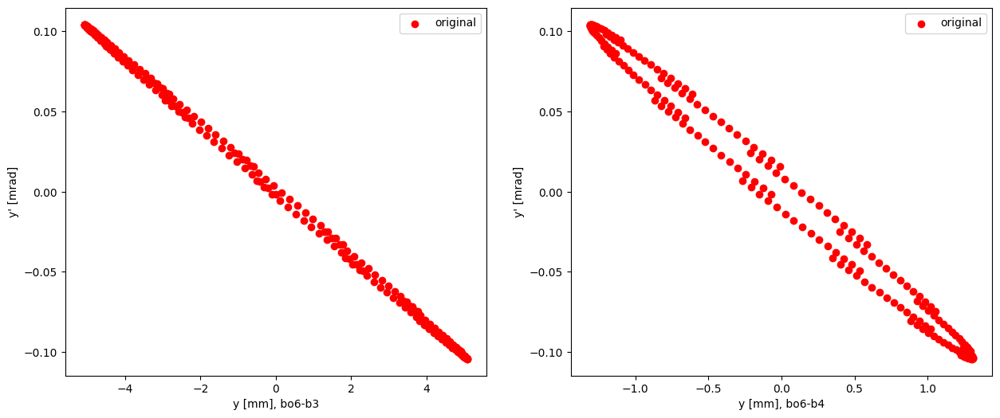

r1 mean, std: 0.11968053813740731 0.015007135568897736
r2 mean, std: 0.12033193860361571 0.014623700397093119
['bo6-b3', 2, 0.6905074991349868, 4.33858657306227, 36.55287641441926, 1783.6815008735439, 1510.086873, -0.18117807178206224]
['bo6-b4', 4, 0.6905537739169673, 4.338877326092502, 9.276791290765578, 117.28111975169286, 96.02554322, -0.2213533588973833]


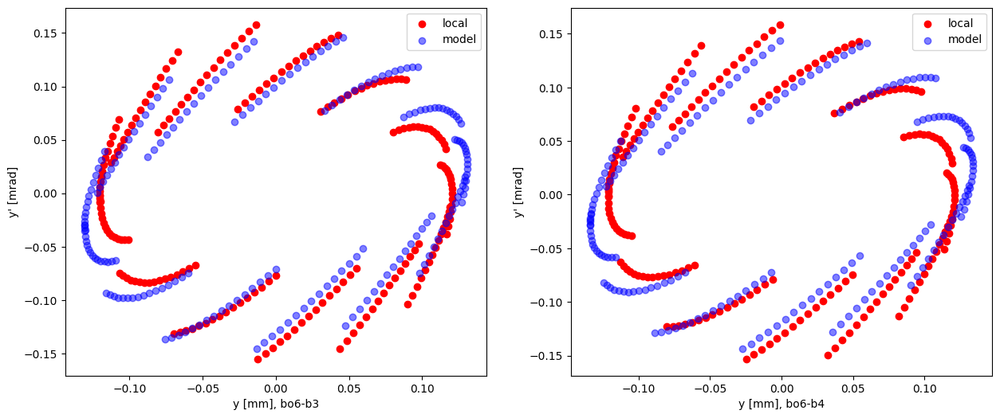

In [14]:
intervalx = 200
intervaly = 200
print("Bad Horizontal BPMs:", Bad_Bpms(BPMx_Tune_Map, nu_x, N_BPMx))
print("Bad Vertical BPMs:", Bad_Bpms(BPMy_Tune_Map, nu_y, N_BPMy))

unexp = True
############ downstream of IP6 ############
Intervalsx = (25, intervalx)
Intervalsy = (525, intervaly)
Bpmsx = 163, 165
Bpmsy = 162, 164
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_d6x, Data2_d6x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
print(Data1_d6x)
print(Data2_d6x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_d6y, Data2_d6y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
print(Data1_d6y)
print(Data2_d6y)

# ############ at IP6 ############
Intervalsx = (25, intervalx)
Intervalsy = (525, intervaly)
Bpmsx = 167, 0
Bpmsy = 166, 0
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_6x, Data2_6x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
print(Data1_6x)
print(Data2_6x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_6y, Data2_6y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
print(Data1_6y)
print(Data2_6y)

# ############ upstream of IP6 ############
Intervalsx = (25, intervalx)
Intervalsy = (525, intervaly)
Bpmsx = 2, 4
Bpmsy = 2, 4
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_u6x, Data2_u6x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
print(Data1_u6x)
print(Data2_u6x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_u6y, Data2_u6y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
print(Data1_u6y)
print(Data2_u6y)

The resulting PS graphs show that the local method finds the normalized PS and resulting linear optics specific for this beam. Additionally, the beta beat is more visual in these PS graphs; the more the PS produced by the local optics does not match with the PS produced by the model optics, the more beta beat there is.

As the PS is plotted for each turn, the average beam coordinates seem to still spiral out from the center. Since the exponential has been taken out, it cannot be the culprit, which means that there is something else that hasn't been taken into account. Since the the beam is still consistent at the end points for most locations, it is both a linear and sinusoidal effect. It is due to the normalized prime coordinate, where the two sinusoids, although seperately sinusoidal, when added together are linear and sinusoidal (check graphs). 

The two sinusoids are supposed to be destructive no matter the turn, but when adding the correct ratio of amplitudes, they form the circular PS, yet will still expand out linearly. If it were any other ratio, it would be linearly expanding only as much as the unnormalized phase space, which is incorrect. Therefore, this constructive behavior is necessary to form the circular PS. This can also be imagined from the unnormalized PS being "stretched" into a circular shape; since the ellipse is not infinitely thin, its thickness gets amplified during the transformation. The exponential behavior is then something to do with the experiment: beam or BPM, as the behavior originates from the unnormalized PS.

### Around IP8

Bad Horizontal BPMs: [18, 58, 59, 75, 102, 113, 114, 122, 137, 140, 142]
Bad Vertical BPMs: [27, 57, 58, 62, 71, 111, 112, 113, 125, 140]


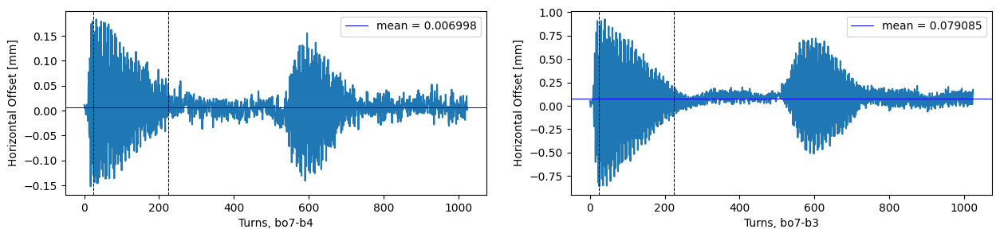

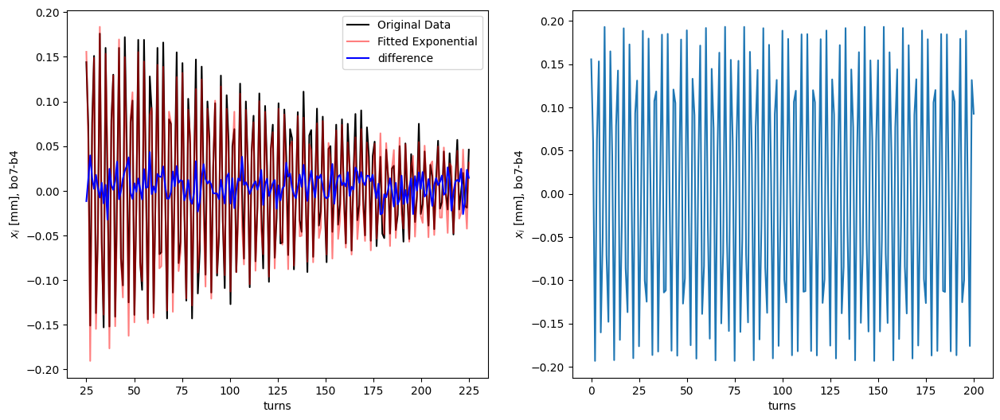

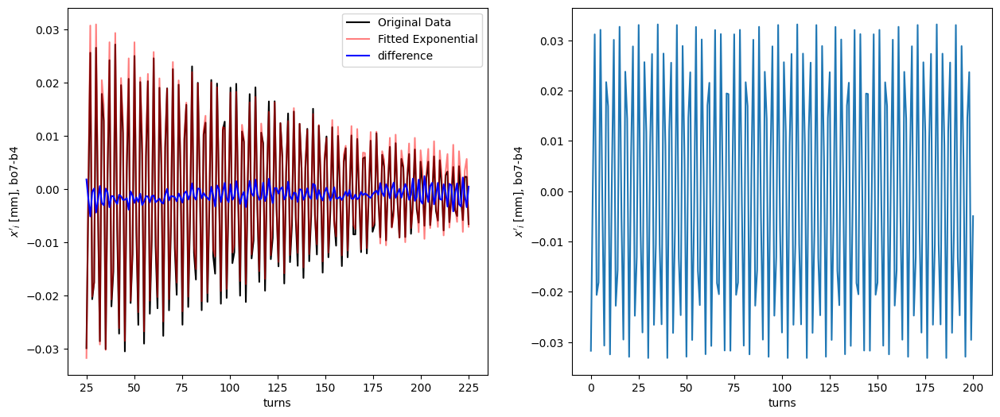

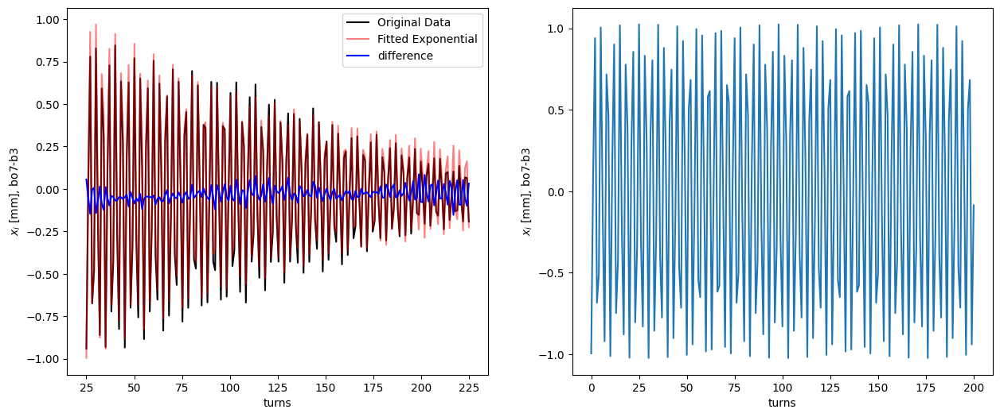

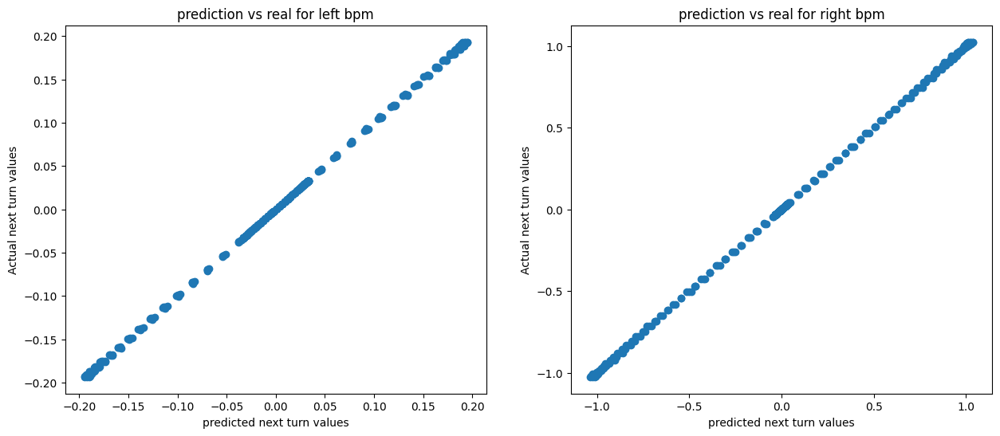

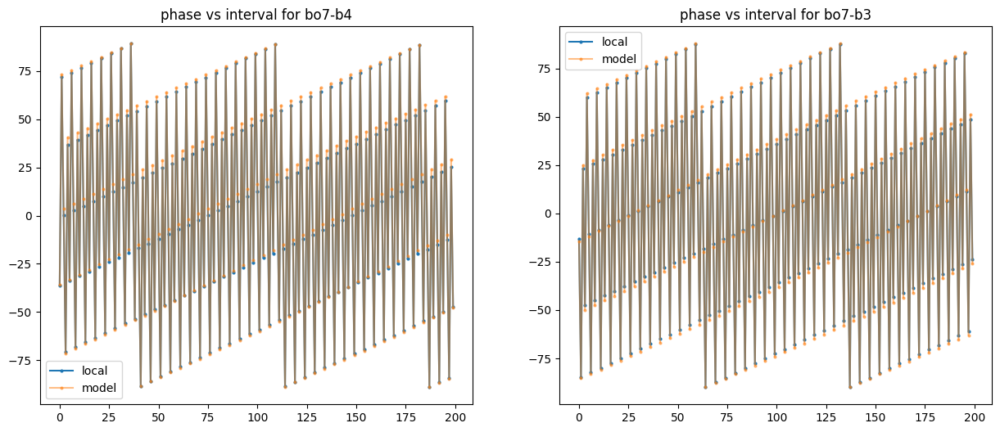

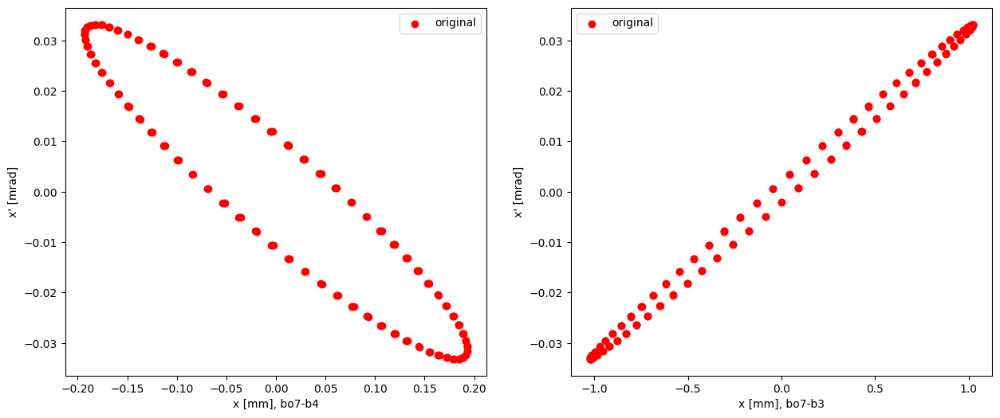

r1 mean, std: 0.046463860599296546 0.00029930728626399646
r2 mean, std: 0.046522260273999 0.00034682850352903
['bo7-b4', 23, 0.6986353997520202, 4.38965567879743, 2.7968220012942377, 17.30669703882468, 18.49617565, 0.06430943529536179]
['bo7-b3', 25, 0.6986293641207749, 4.38961775580787, -15.660075185425592, 484.2717763188797, 529.7048166, 0.08577048736830435]


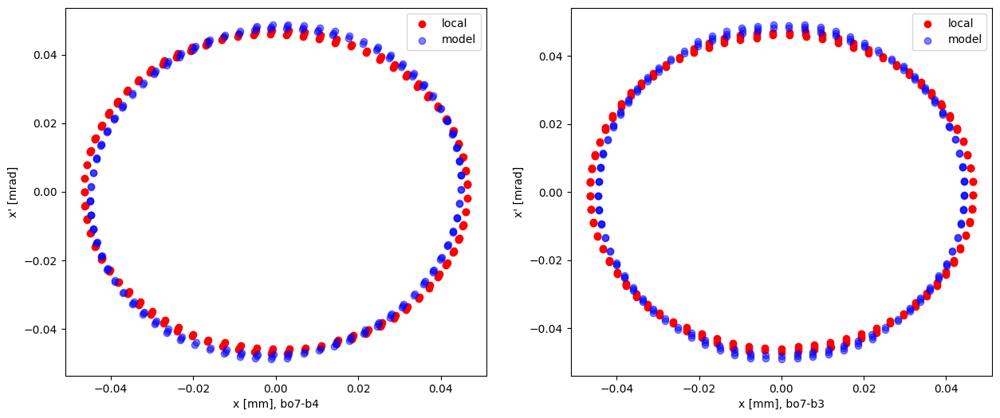

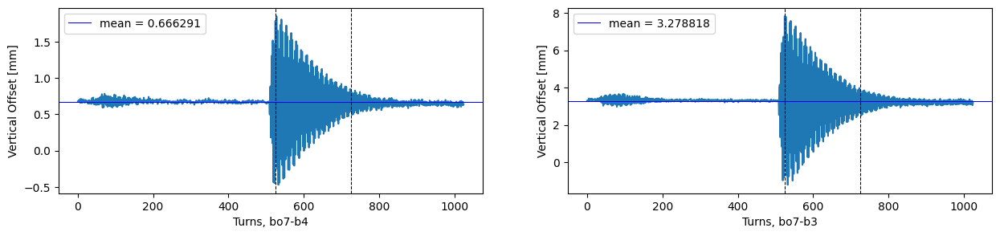

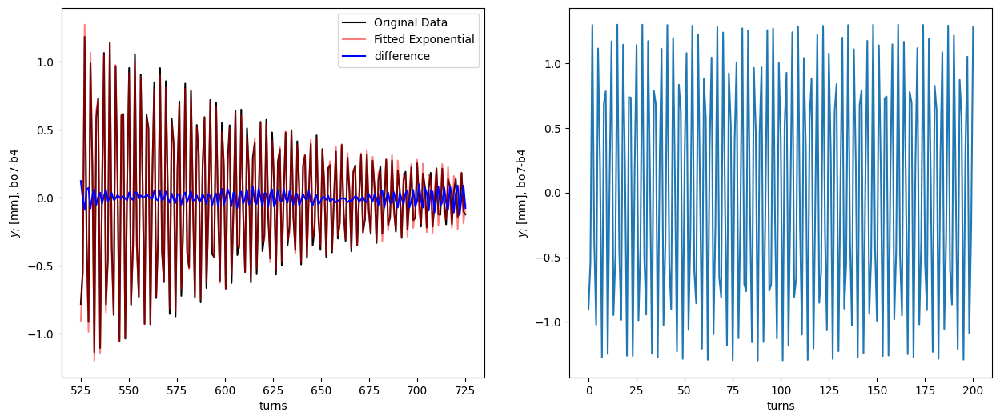

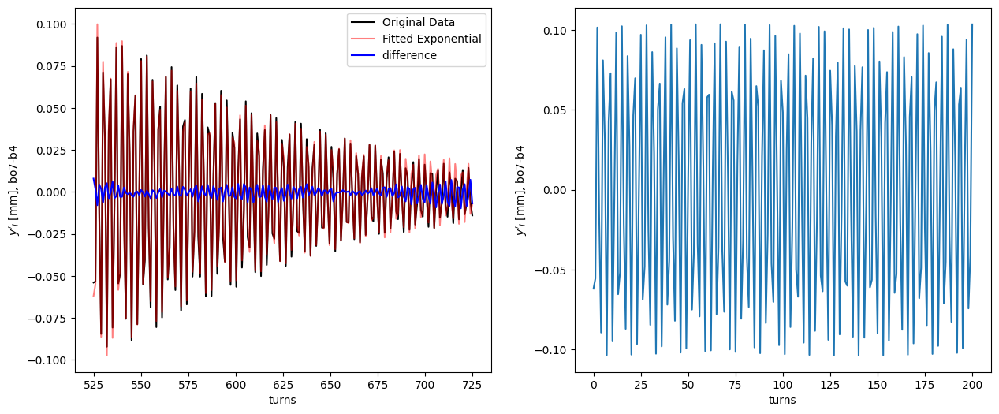

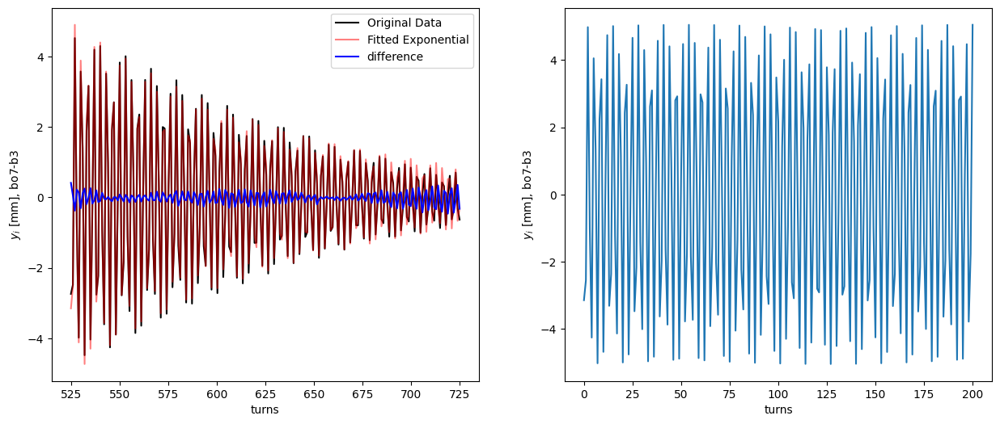

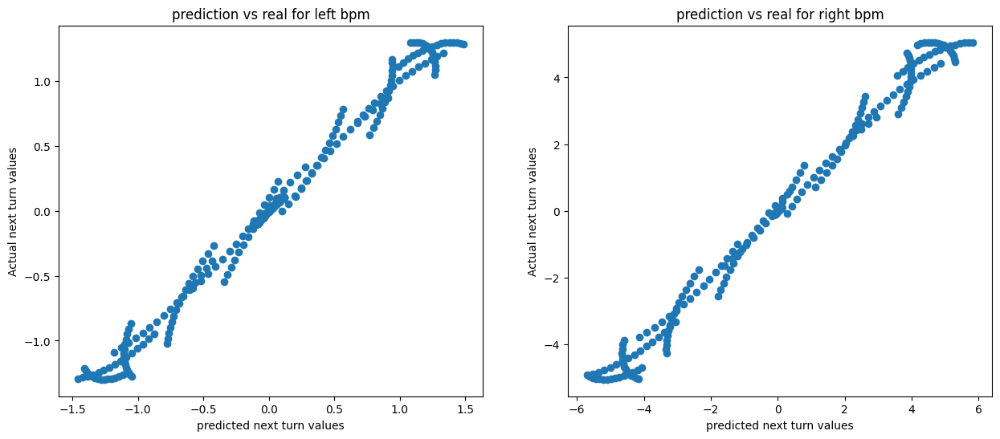

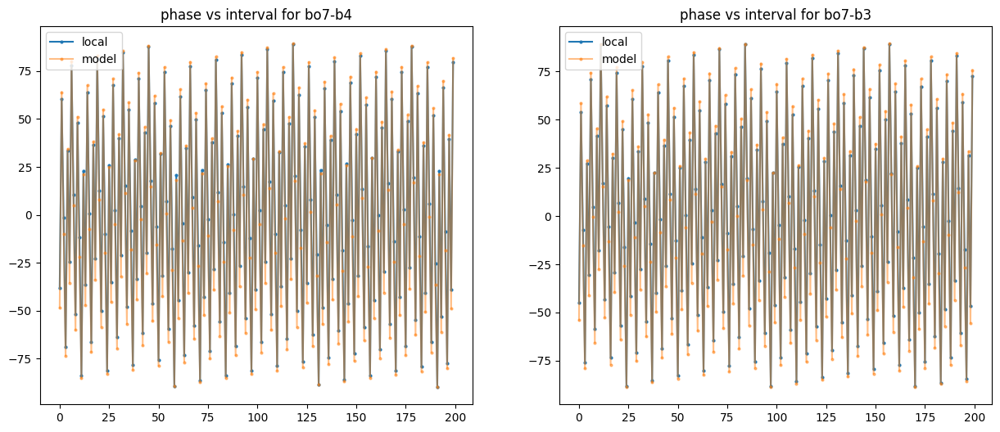

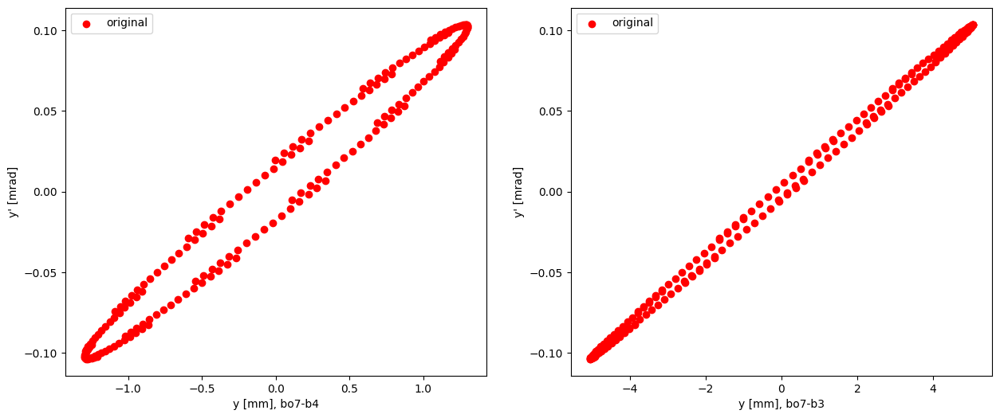

r1 mean, std: 0.14846111245242555 0.010457776473403303
r2 mean, std: 0.1482304712071339 0.010345585932183434
['bo7-b4', 24, 0.6914717896329192, 4.344645388950732, -5.986877786921517, 76.01893680092333, 95.15734481, 0.20112381285217862]
['bo7-b3', 26, 0.6915134874091321, 4.344907383805575, -23.674426420677417, 1154.9585641710773, 1470.956668, 0.2148248896132151]


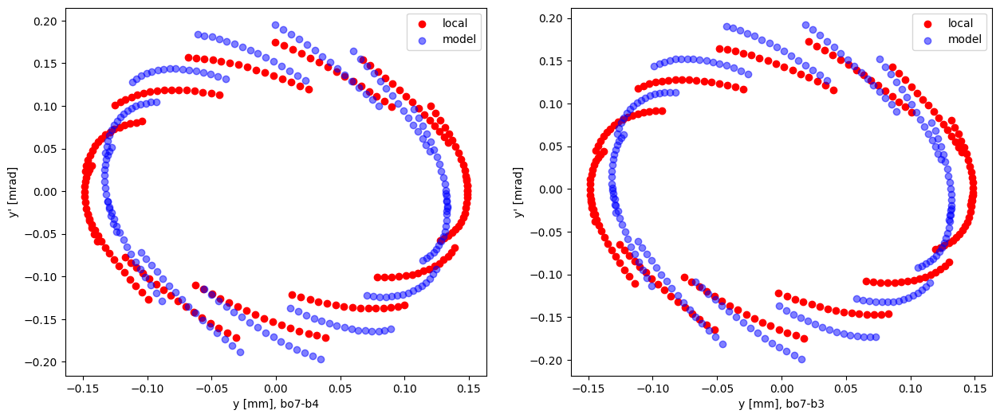

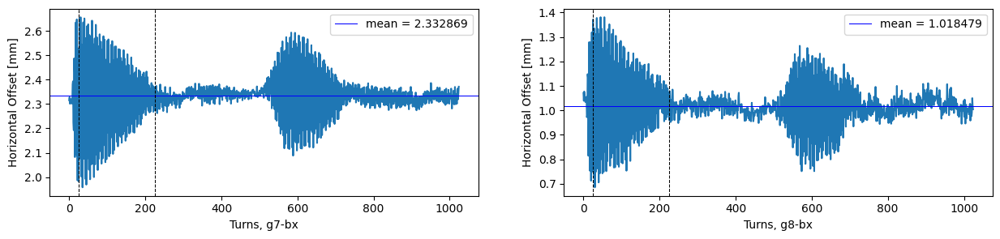

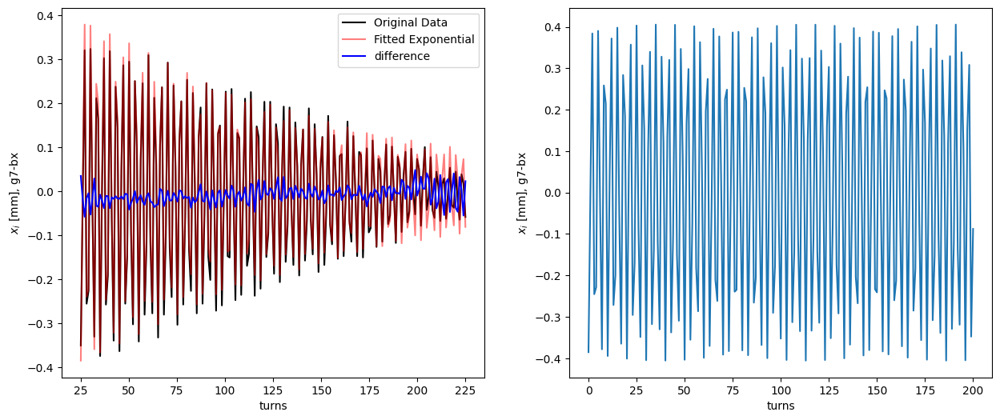

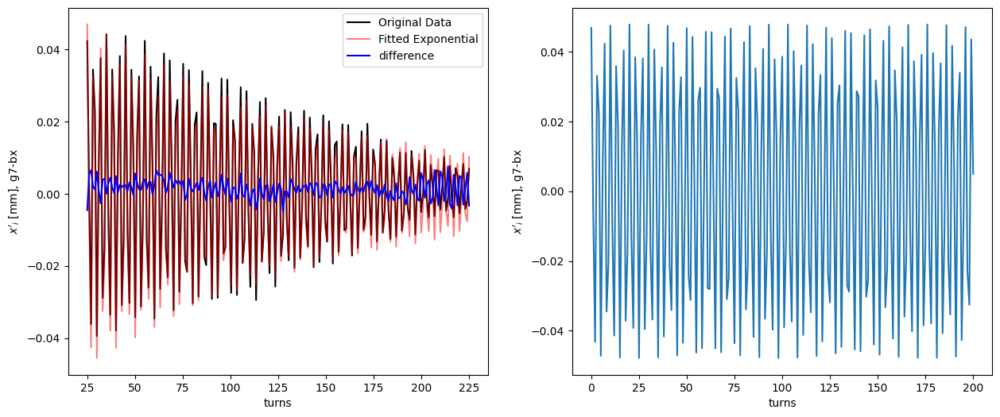

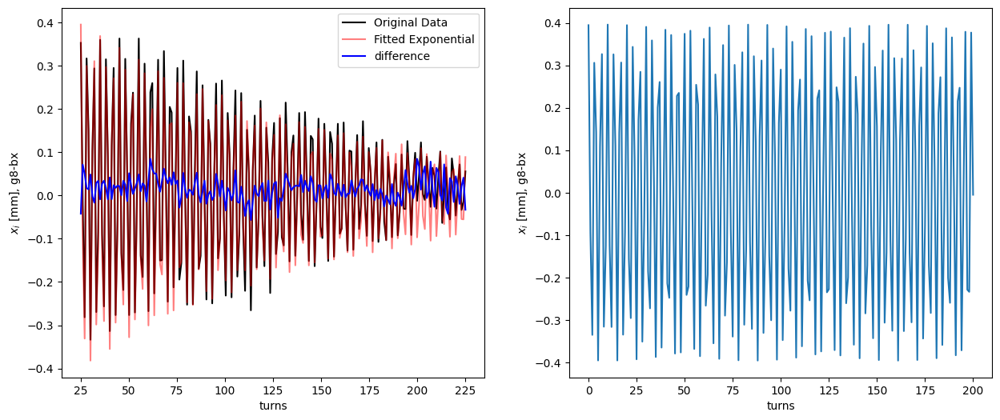

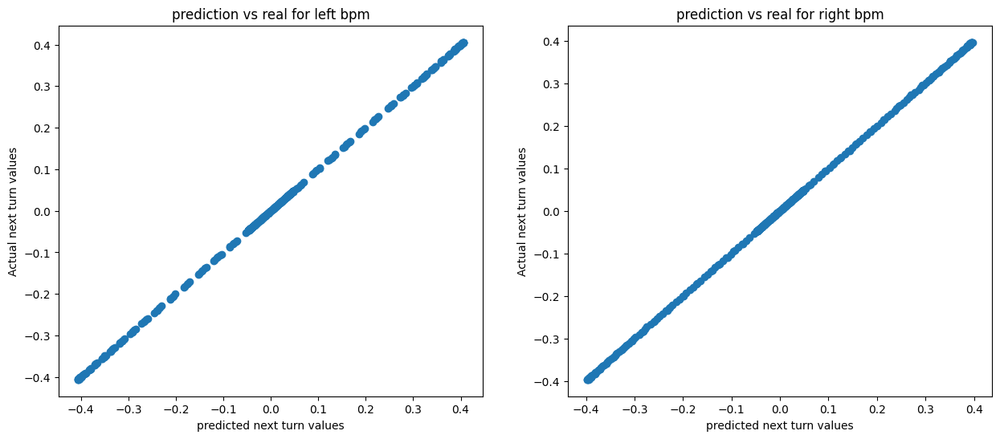

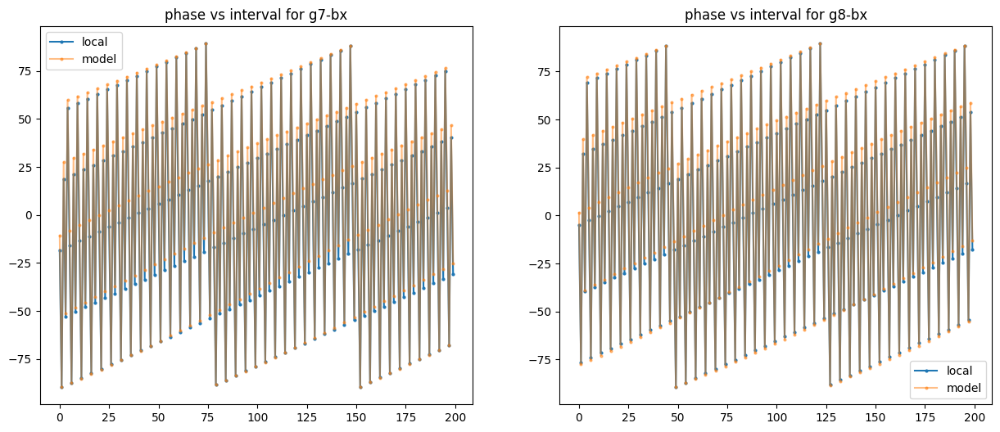

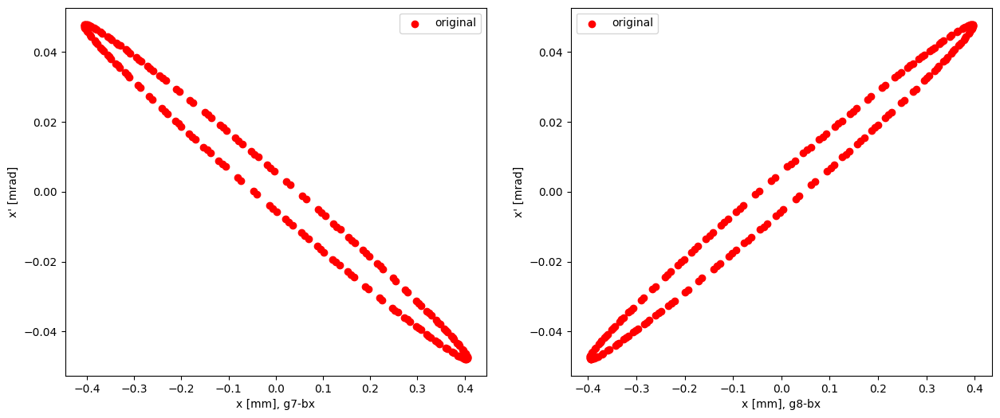

r1 mean, std: 0.04715235090358062 6.100618308527899e-05
r2 mean, std: 0.04710848611268547 9.52922419964919e-05
['g7-bx', 27, 0.6986704649654844, 4.389876000031461, 8.666258608594108, 73.99143317279669, 78.28517569, 0.054847453293149946]
['g8-bx', 28, 0.6986710029391342, 4.389879380219593, -8.478750535031239, 70.73361908947135, 79.37992211, 0.10892304742434887]


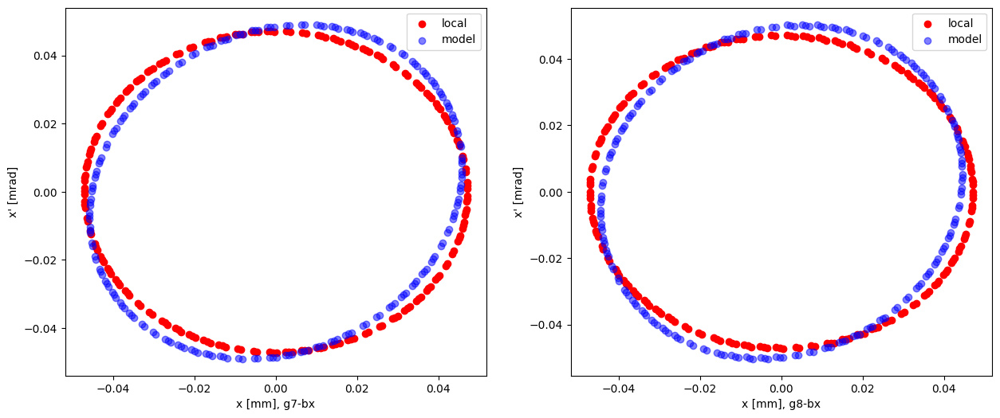

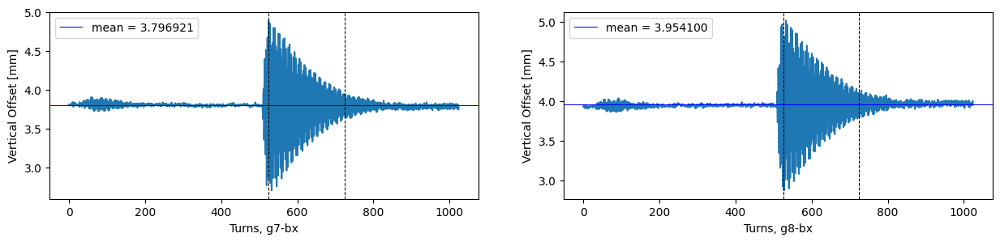

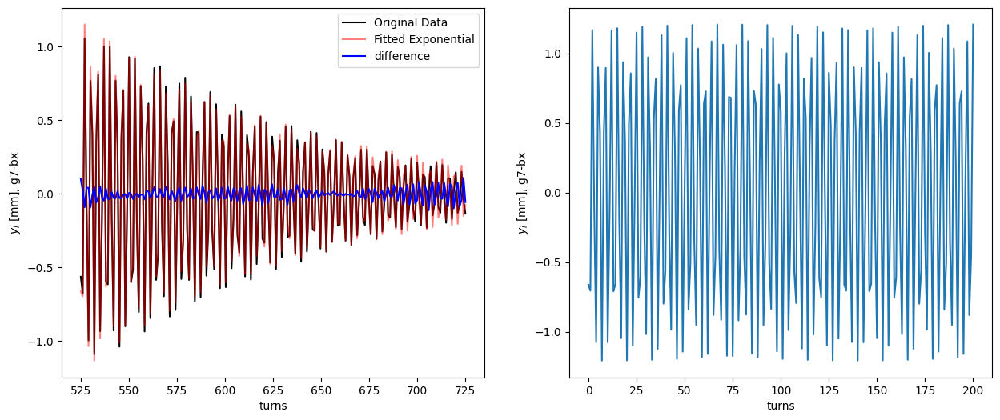

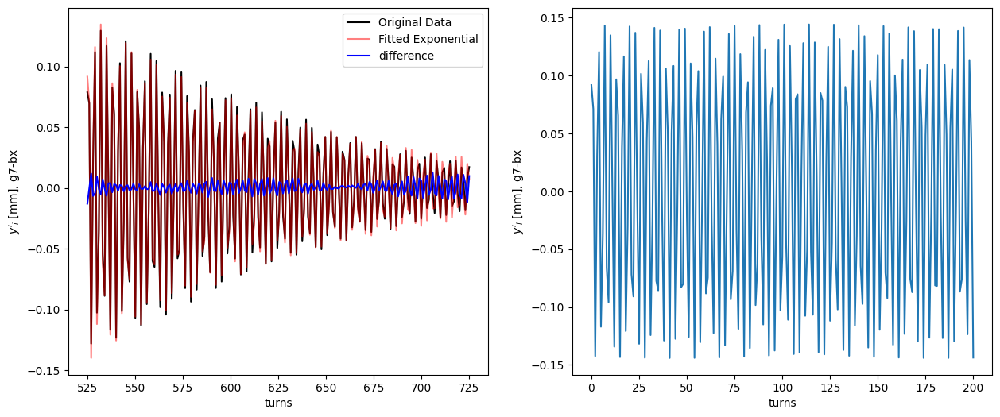

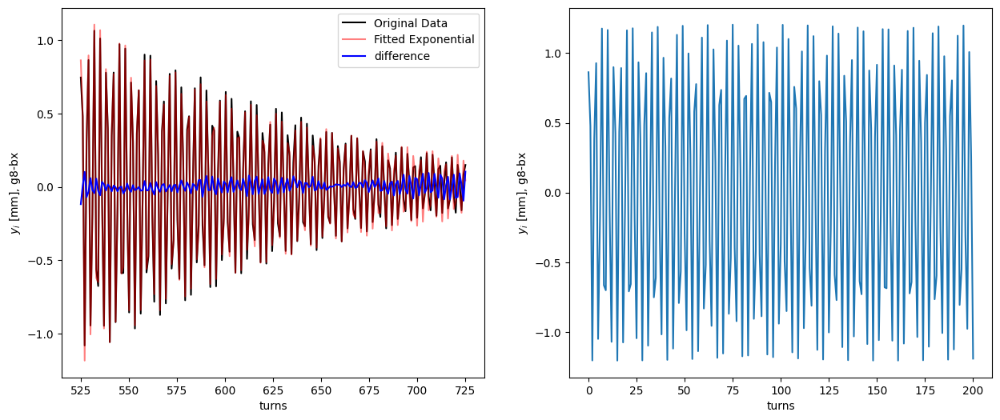

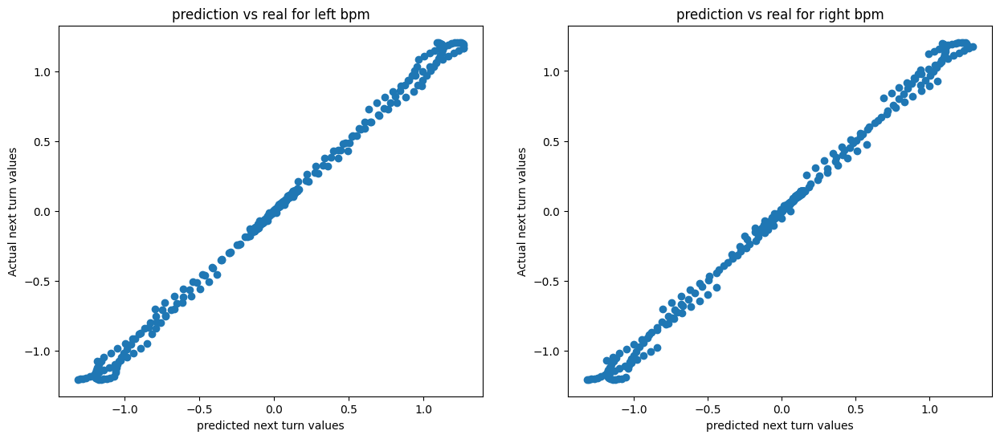

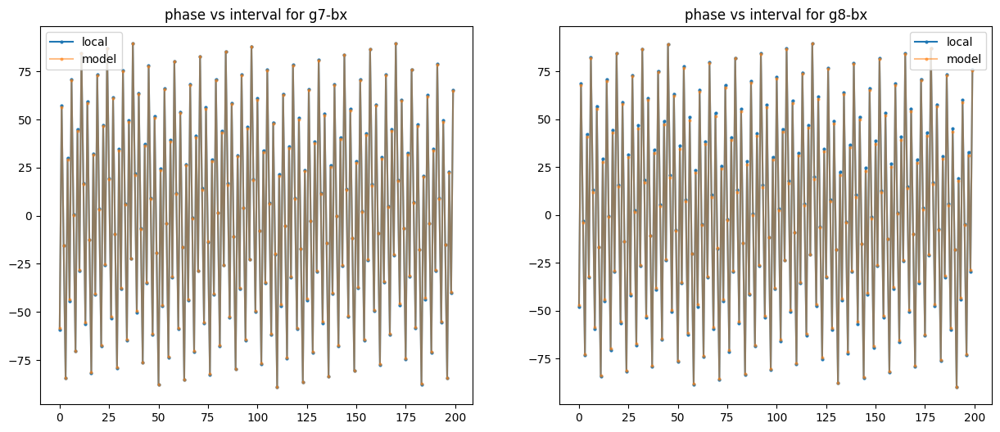

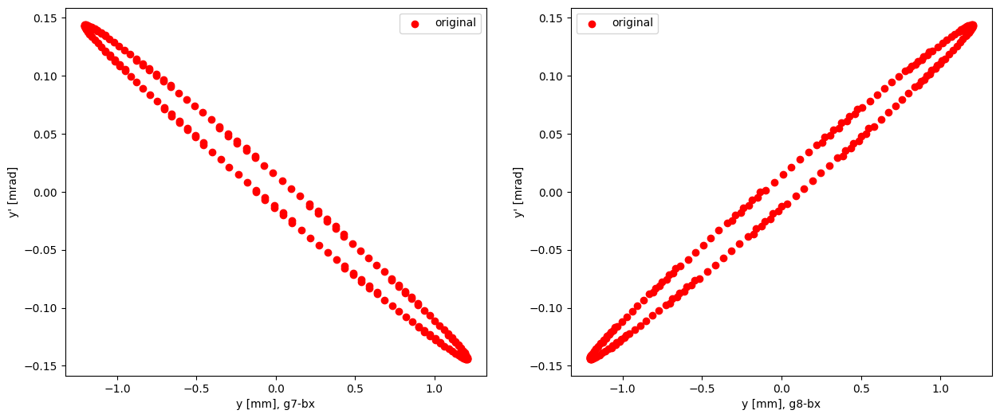

r1 mean, std: 0.1306345007614707 0.004975304452069226
r2 mean, std: 0.1297337035119528 0.005603733679901379
['g7-bx', 27, 0.6986704649654844, 4.389876000031461, 8.666258608594108, 73.99143317279669, 78.28517569, 0.054847453293149946]
['g8-bx', 28, 0.6986710029391342, 4.389879380219593, -8.478750535031239, 70.73361908947135, 79.37992211, 0.10892304742434887]


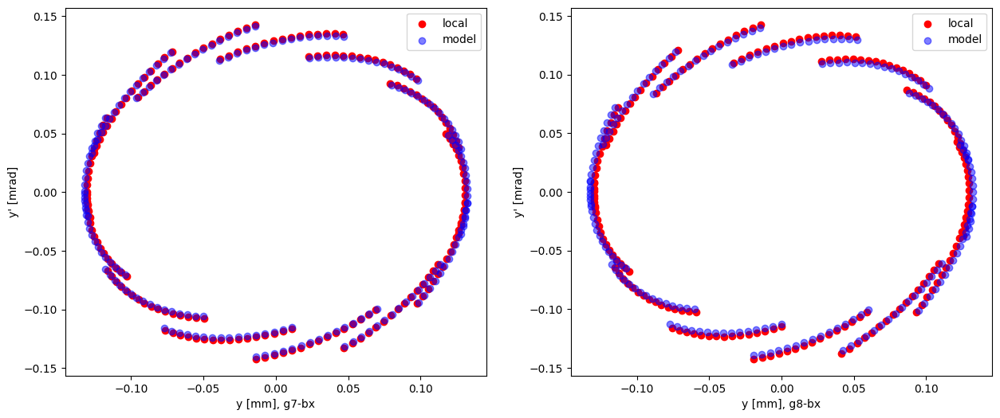

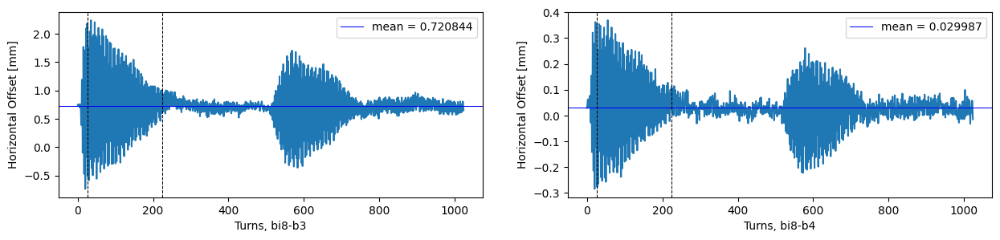

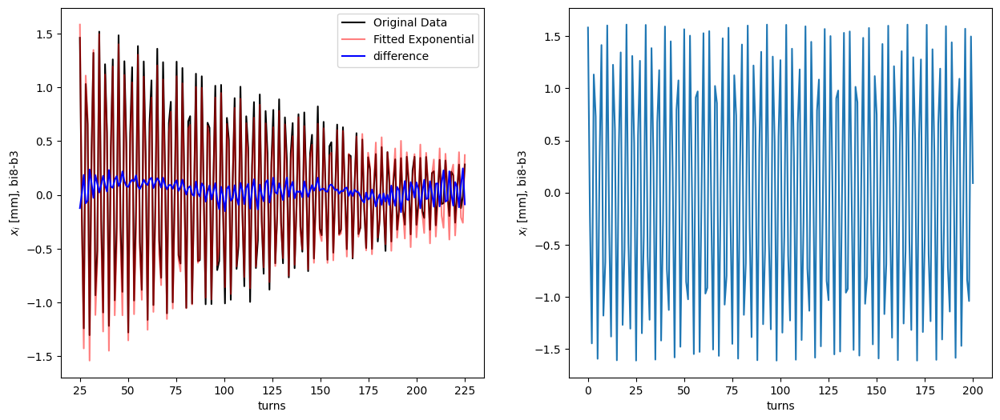

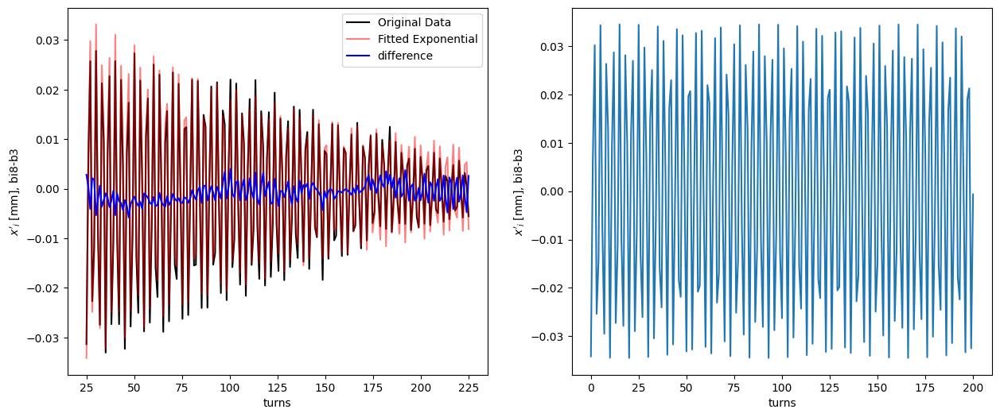

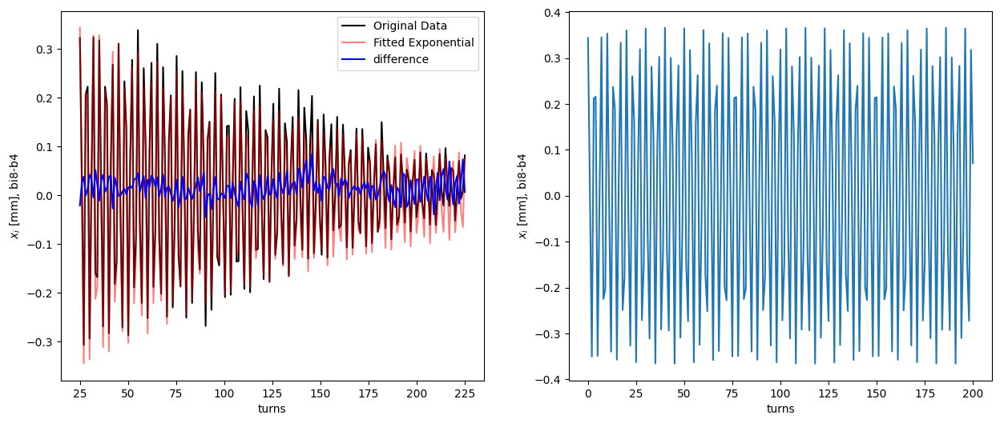

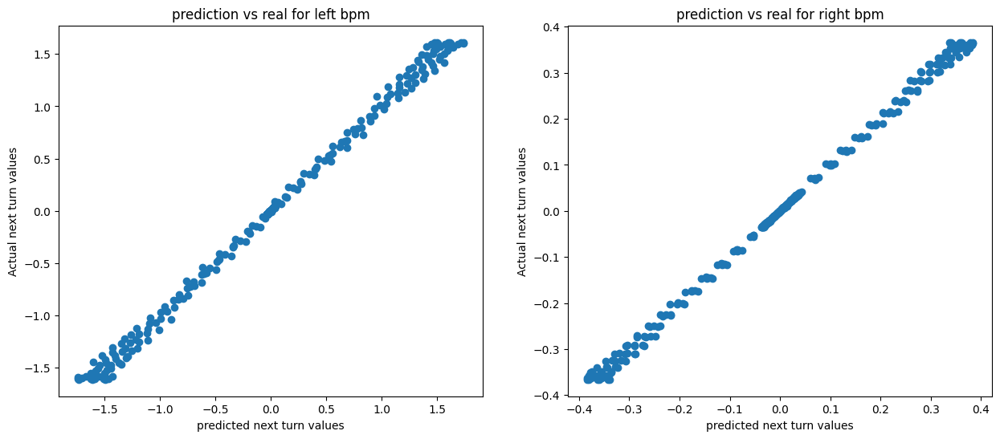

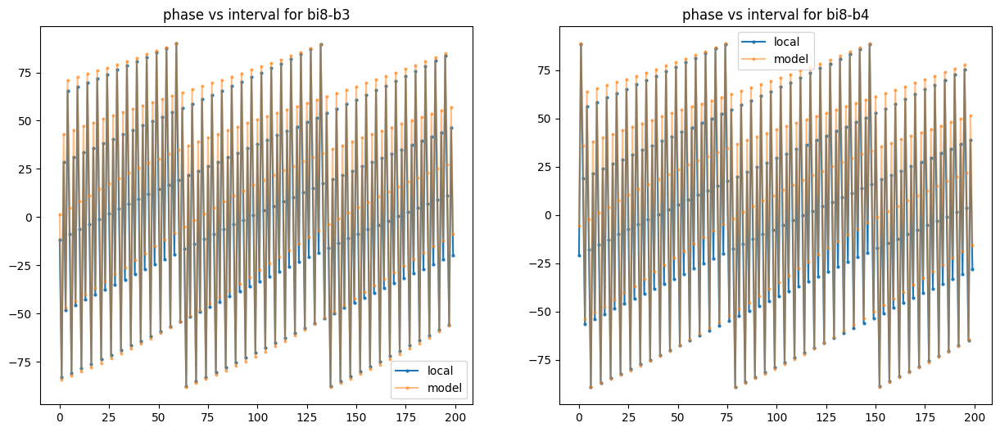

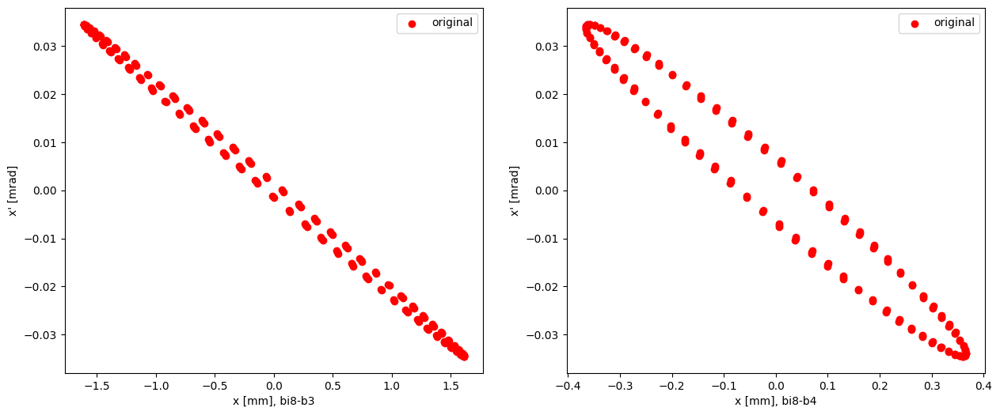

r1 mean, std: 0.048615600519128 0.00189153116758048
r2 mean, std: 0.0492042998400834 0.0014345187992565545
['bi8-b3', 30, 0.6985376294394354, 4.389041369805919, 23.498447644622548, 1099.1276214060945, 1327.140496, 0.1718076385138846]
['bi8-b4', 32, 0.698573046622015, 4.389263902527125, 5.119976667770326, 55.360428859079015, 63.14342524, 0.12325901471671549]


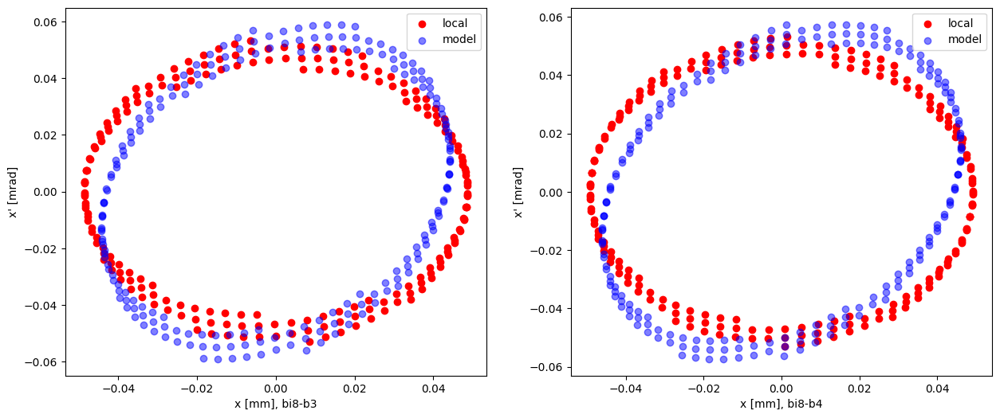

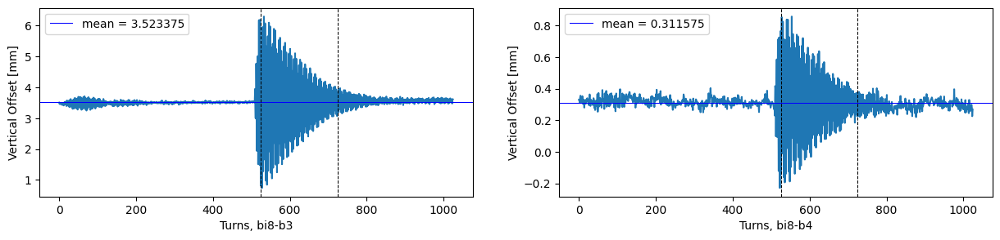

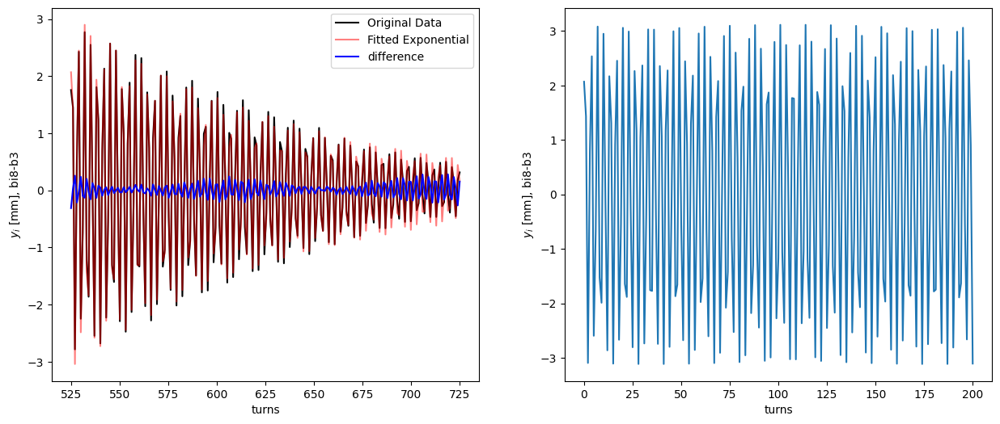

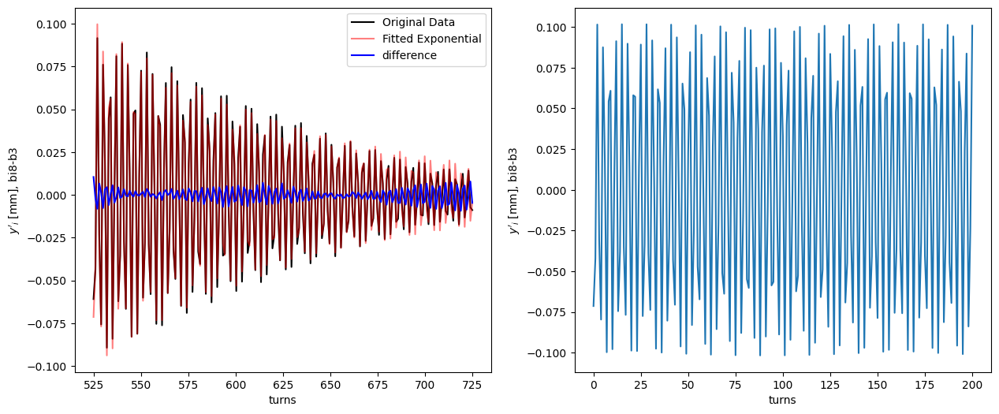

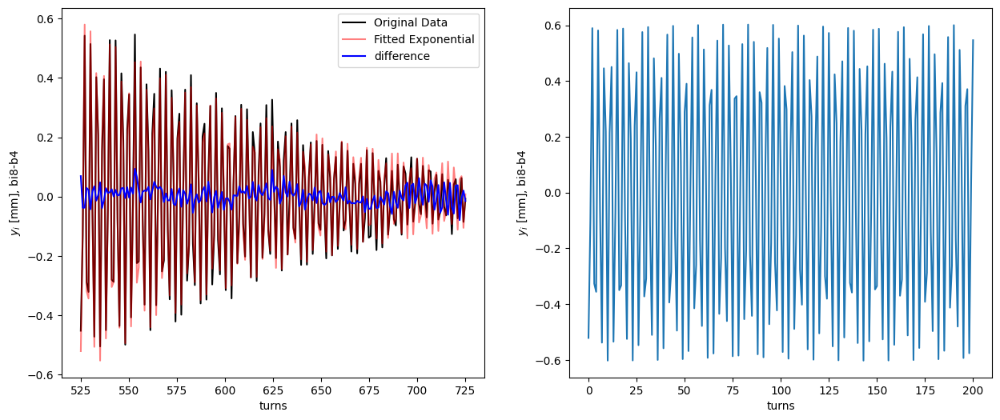

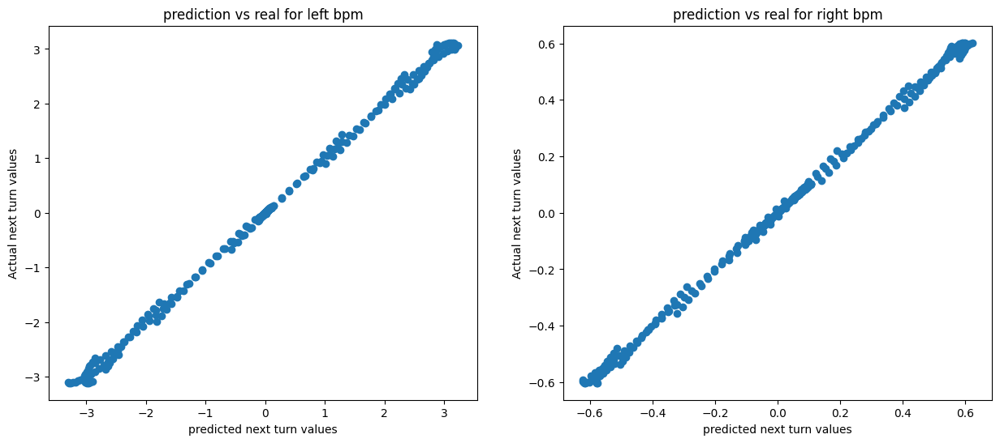

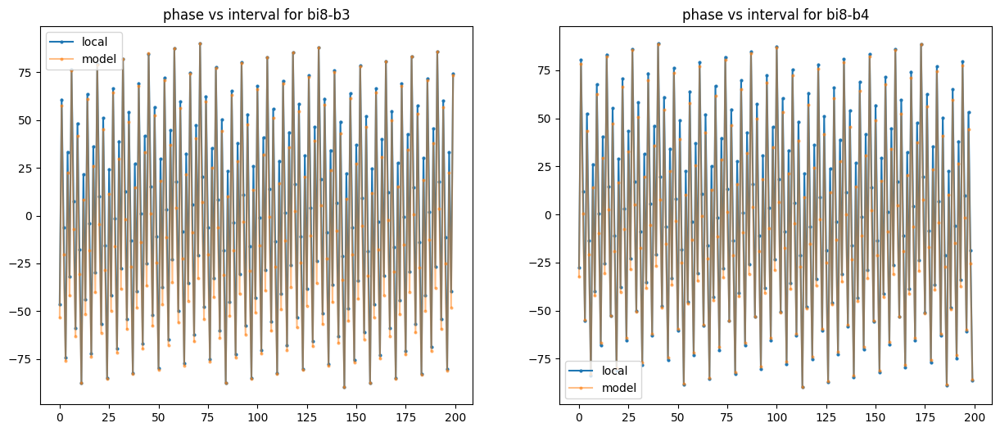

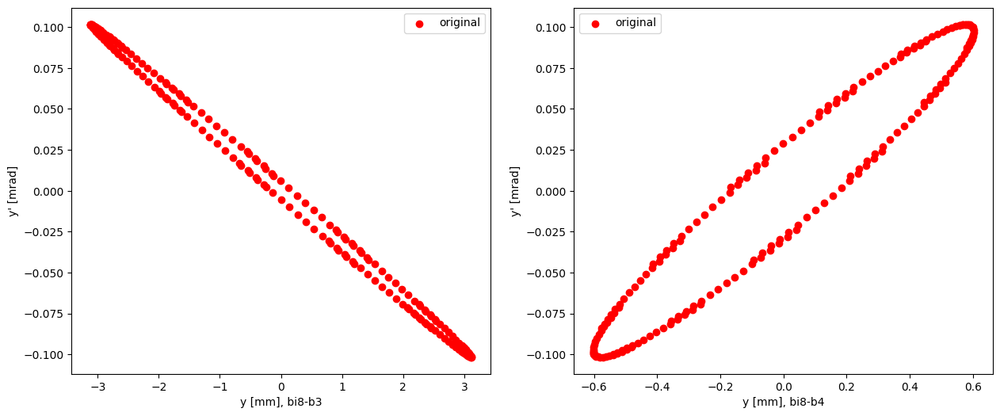

r1 mean, std: 0.1320726892076491 0.0034203679506717133
r2 mean, std: 0.13145076569387718 0.0029317723245087532
['bi8-b3', 31, 0.69174281691409, 4.346348303581629, 18.118733397325922, 555.7178210983682, 570.7027462, 0.02625697037802655]
['bi8-b4', 33, 0.6917235642092312, 4.346227335269337, -3.4015844391530443, 21.00894275788985, 18.2136177, -0.1534744554284705]


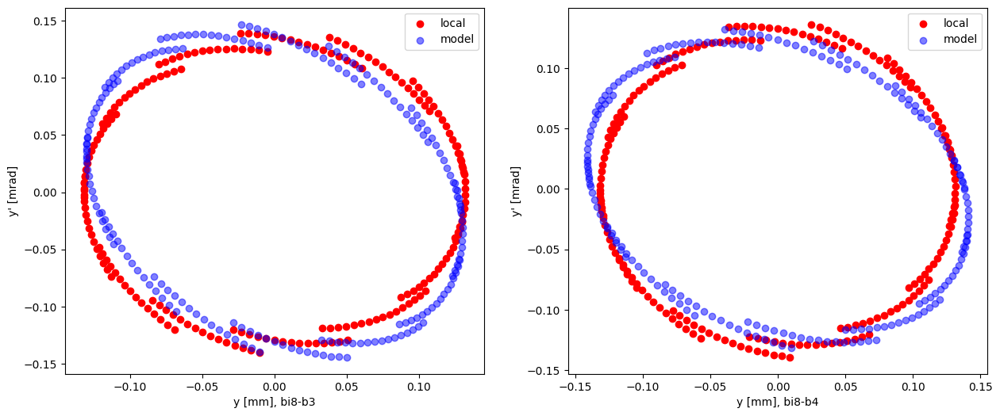

In [15]:
intervalx = 200
intervaly = 200
print("Bad Horizontal BPMs:", Bad_Bpms(BPMx_Tune_Map, nu_x, N_BPMx))
print("Bad Vertical BPMs:", Bad_Bpms(BPMy_Tune_Map, nu_y, N_BPMy))

unexp = True
############ downstream of IP8 ############
Intervalsx = (25, intervalx)
Intervalsy = (525, intervaly)
Bpmsx = 23, 25
Bpmsy = 24, 26
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_d8x, Data2_d8x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
print(Data1_d8x)
print(Data2_d8x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_d8y, Data2_d8y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
print(Data1_d8y)
print(Data2_d8y)

############ at IP8 ############
Intervalsx = (25, intervalx)
Intervalsy = (525, intervaly)
Bpmsx = 27, 28
Bpmsy = 28, 29
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_8x, Data2_8x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
print(Data1_8x)
print(Data2_8x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_8y, Data2_8y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
print(Data1_8x)
print(Data2_8x)


############ upstream of IP8 ############
Intervalsx = (25, intervalx)
Intervalsy = (525, intervaly)
Bpmsx = 30, 32
Bpmsy = 31, 33
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_u8x, Data2_u8x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
print(Data1_u8x)
print(Data2_u8x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_u8y, Data2_u8y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
print(Data1_u8y)
print(Data2_u8y)


### Around IP10

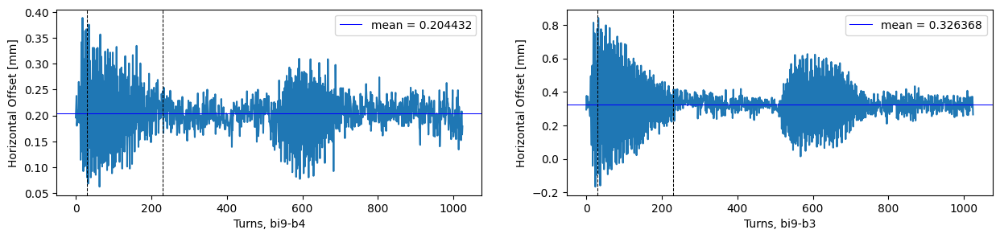

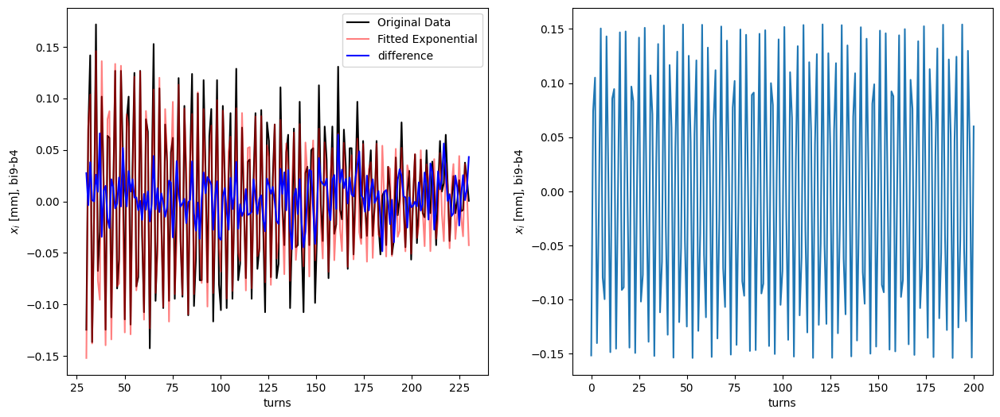

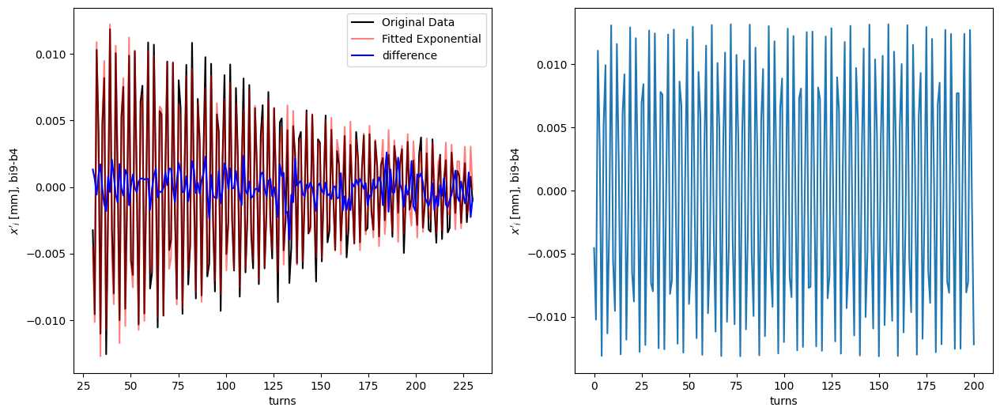

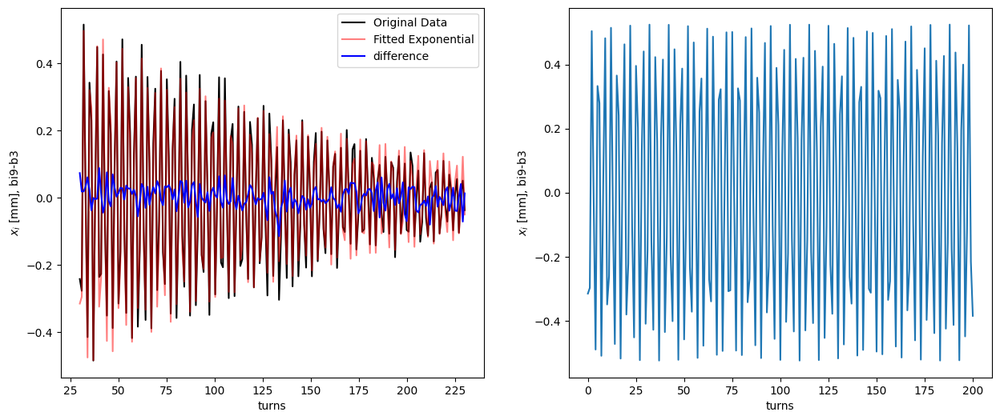

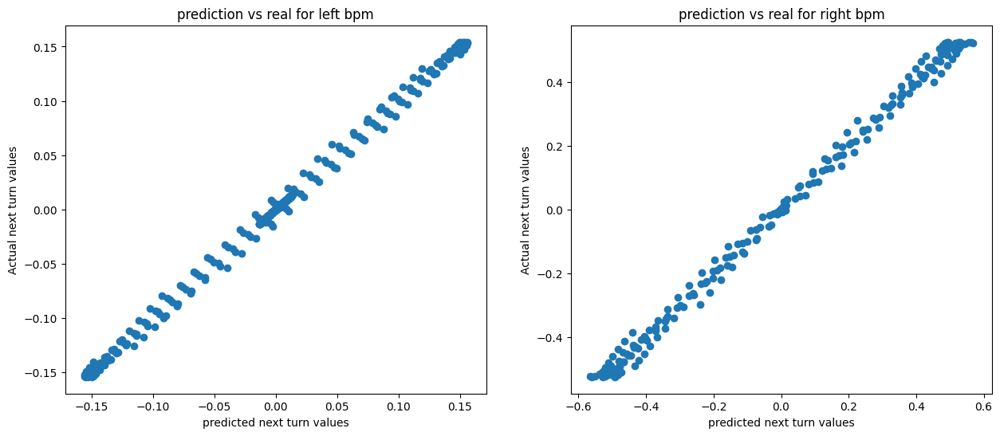

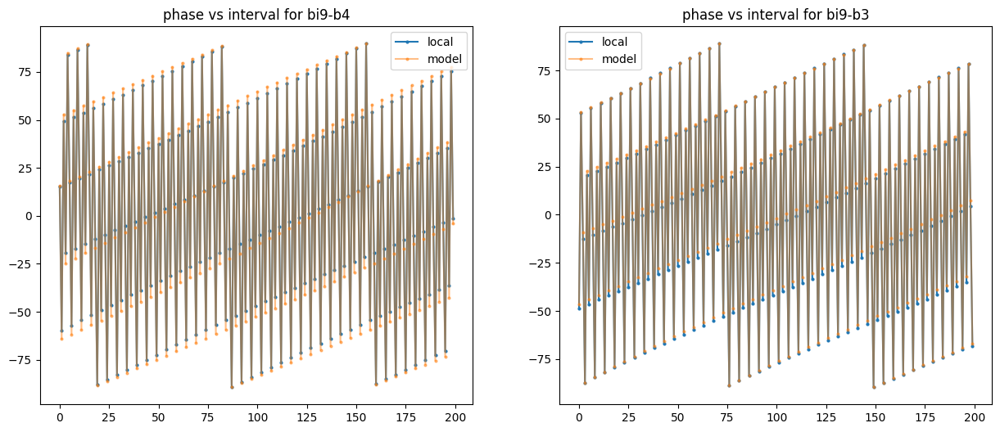

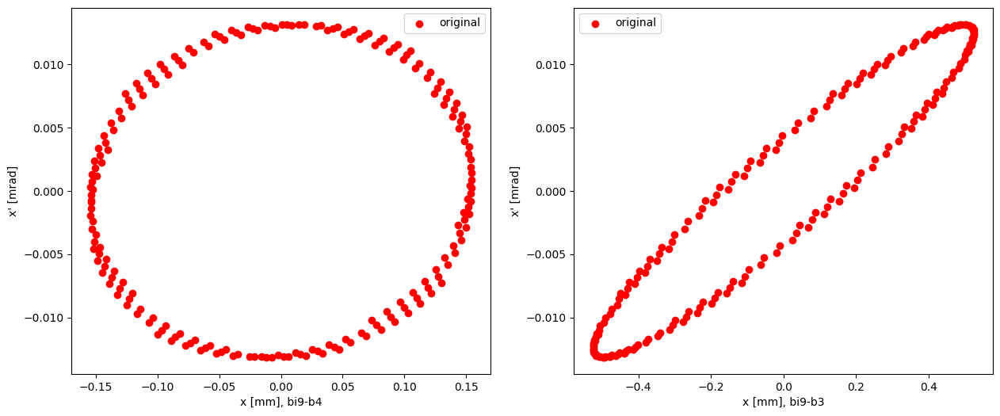

r1 mean, std: 0.044919414599213905 0.0009119190278501229
r2 mean, std: 0.04712571940865092 0.0019047536725930372


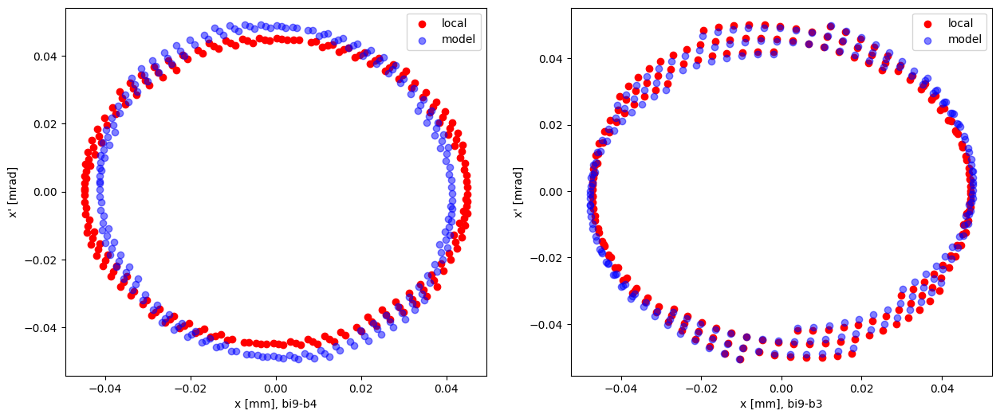

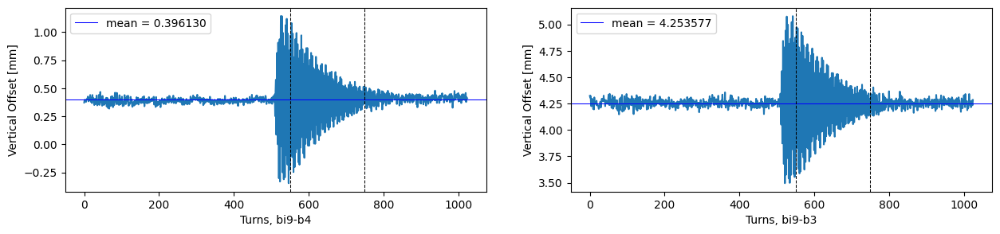

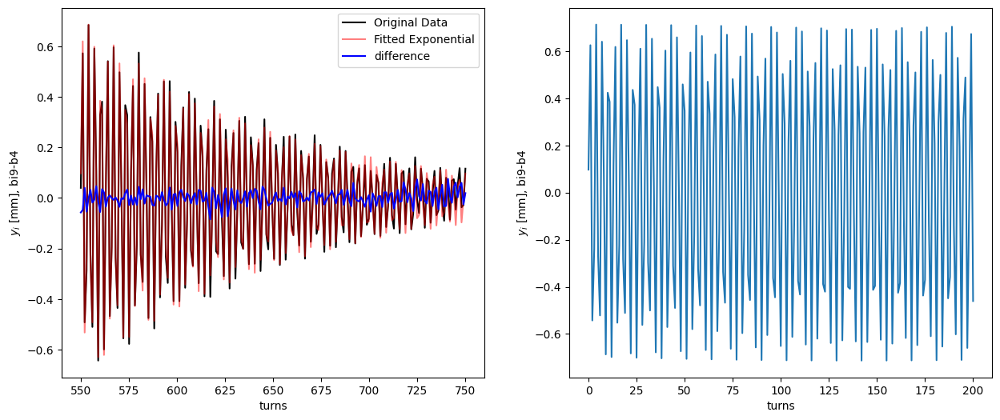

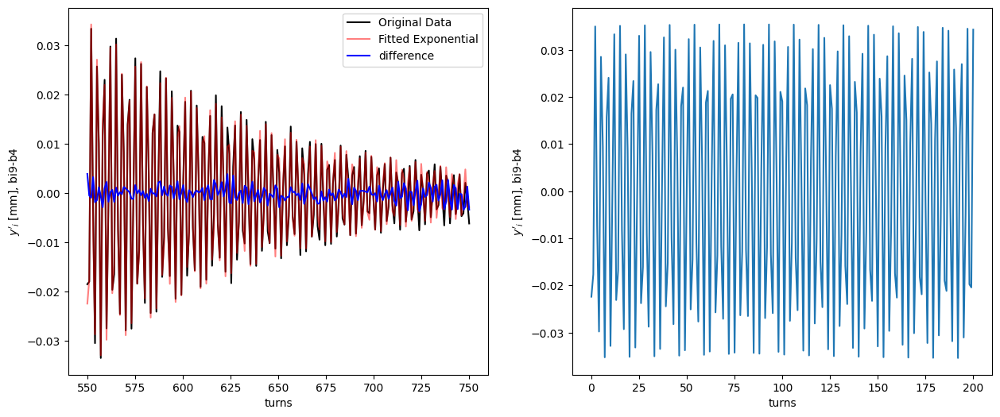

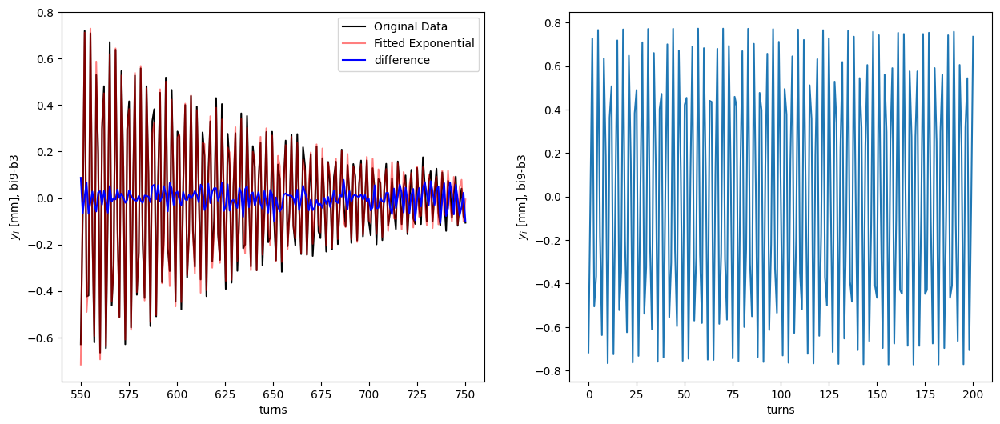

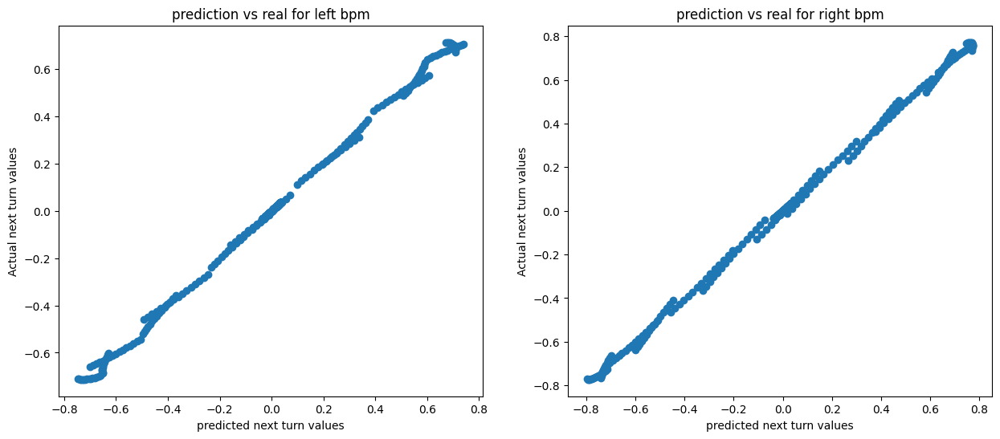

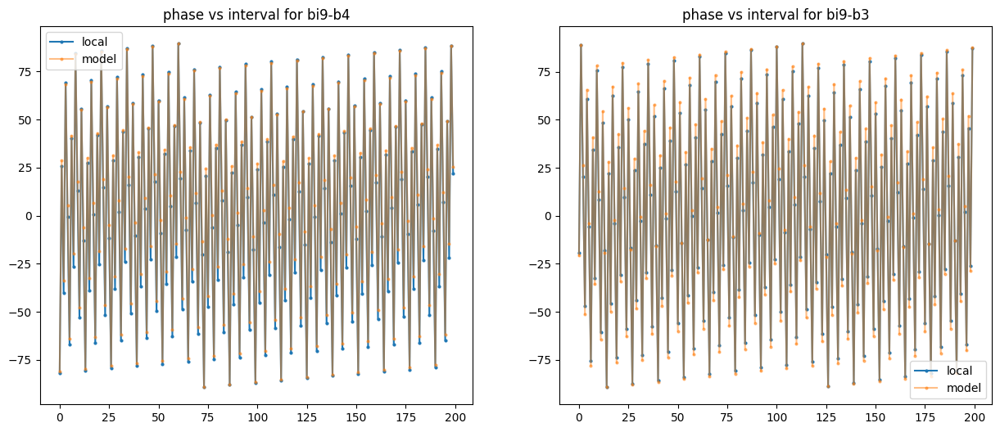

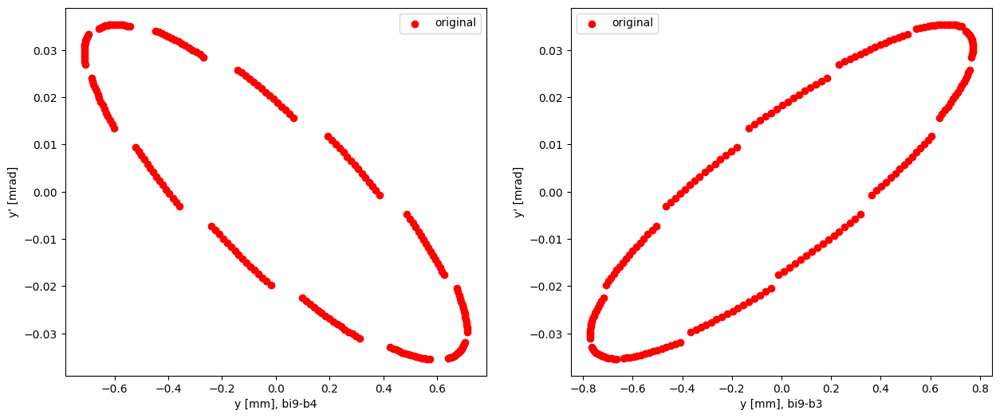

r1 mean, std: 0.11788335268995623 0.002408780460887086
r2 mean, std: 0.11792878703802778 0.0021476018691256905


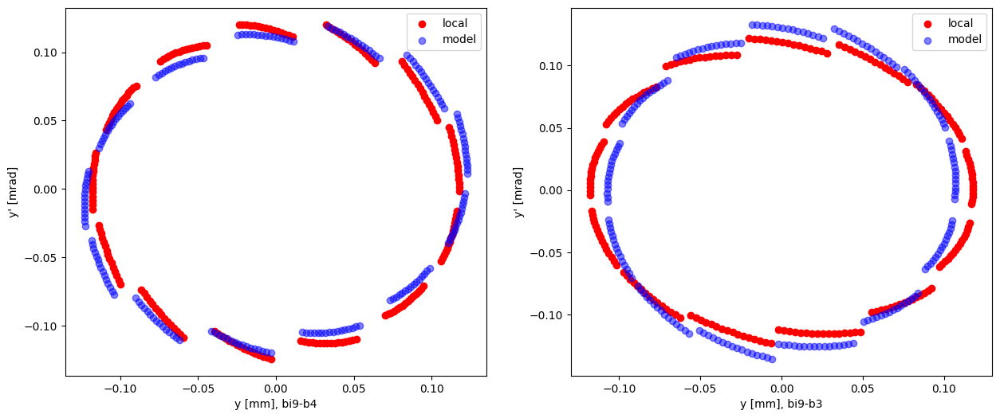

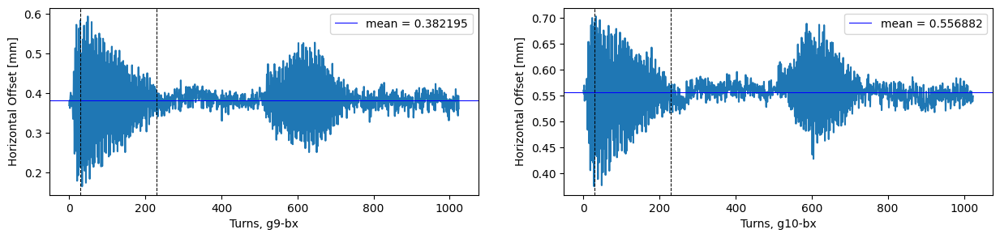

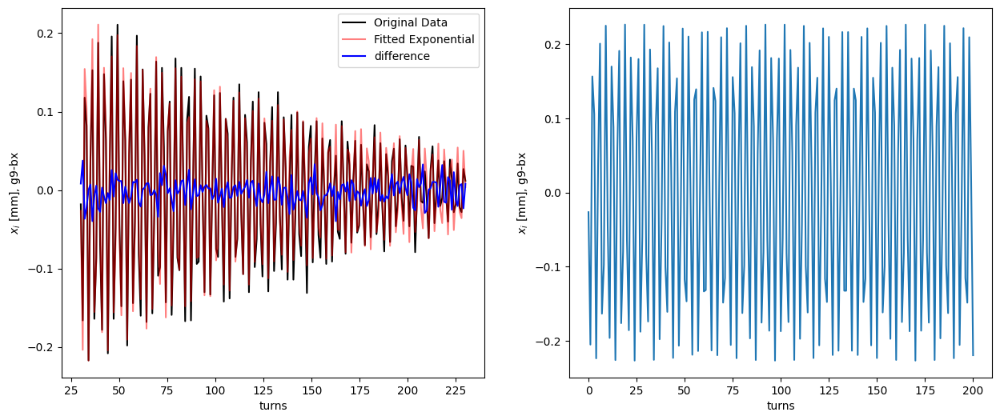

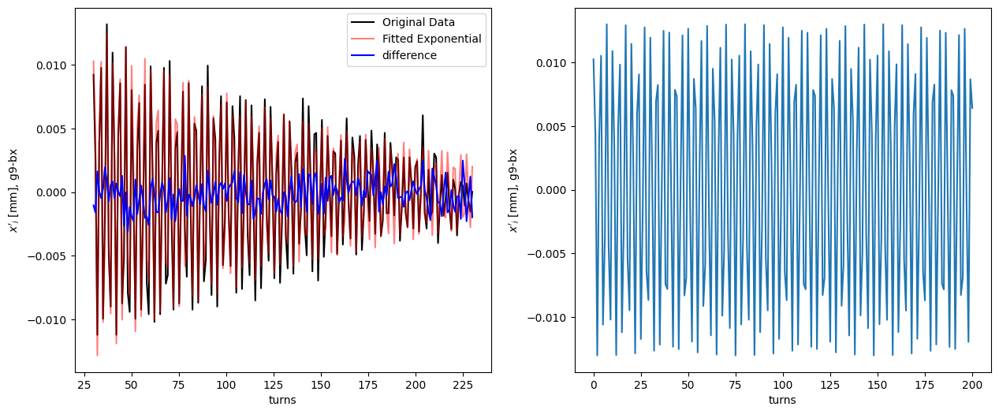

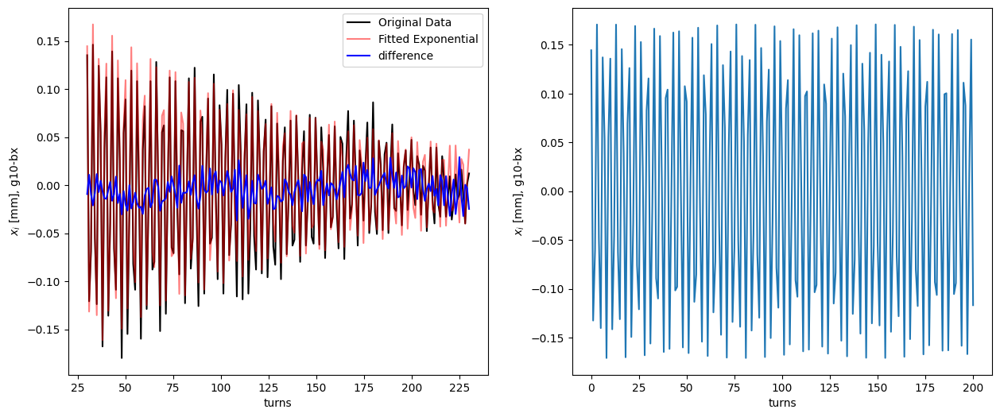

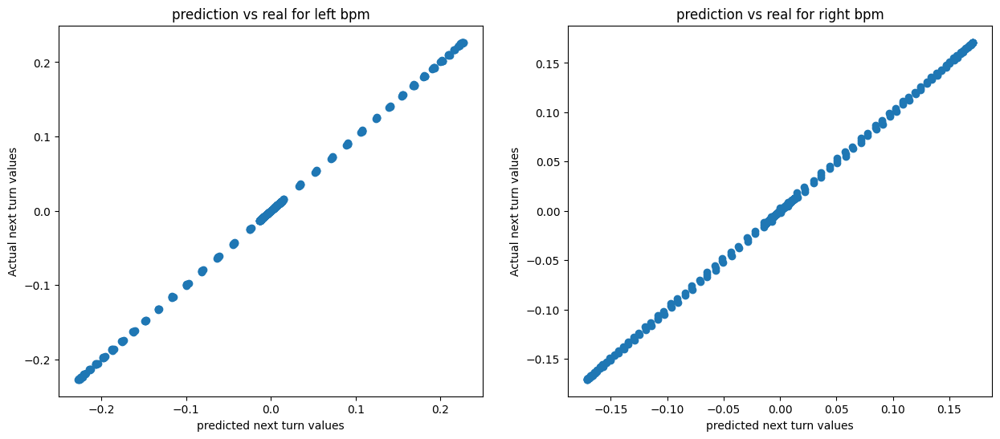

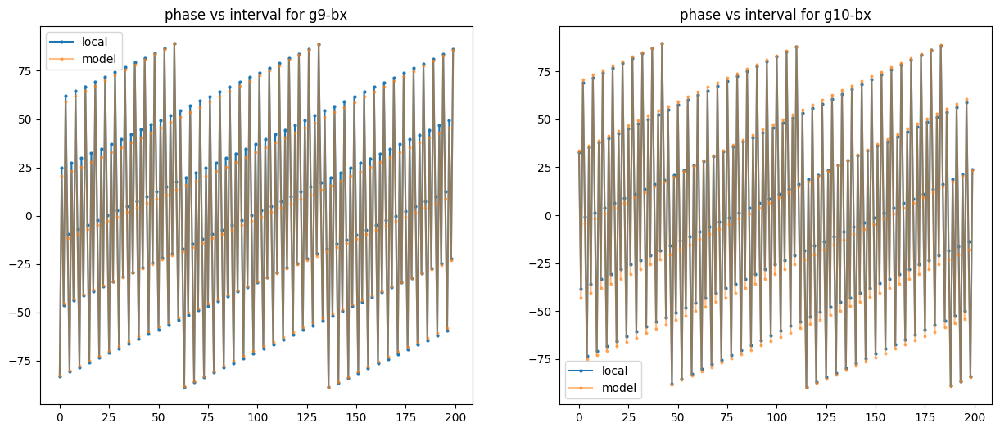

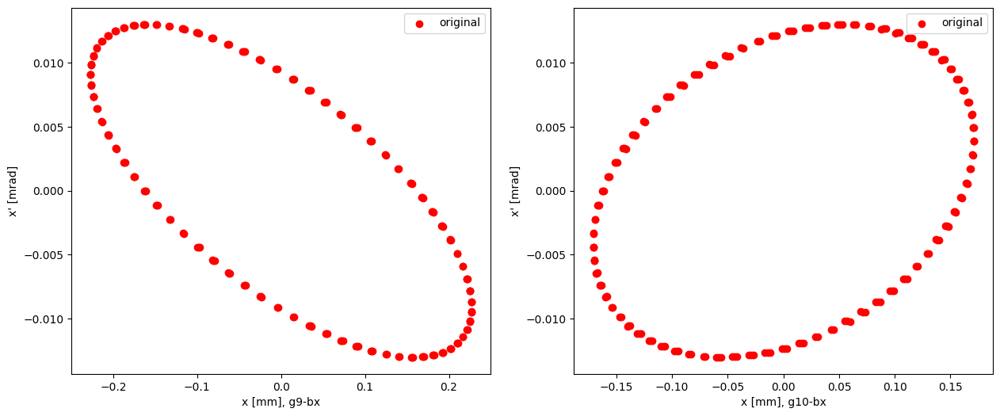

r1 mean, std: 0.04591414613420019 9.251787621628769e-05
r2 mean, std: 0.04593874728137186 0.00022453716301084036


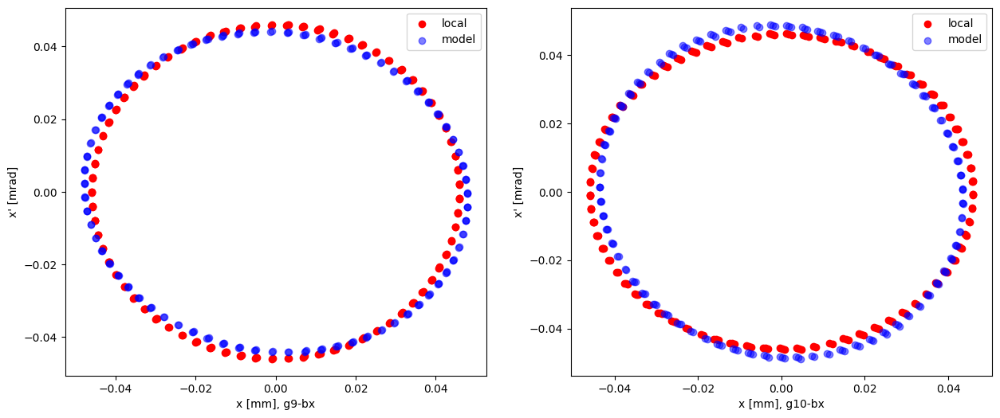

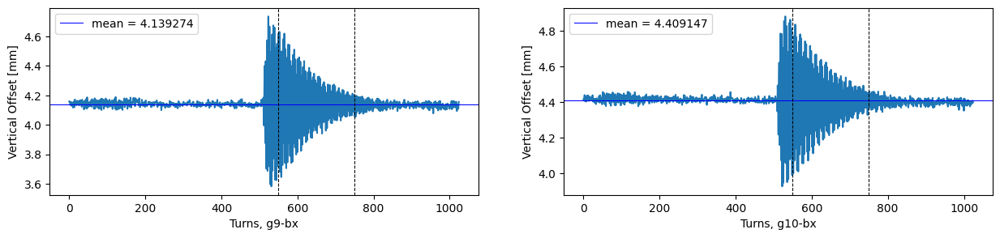

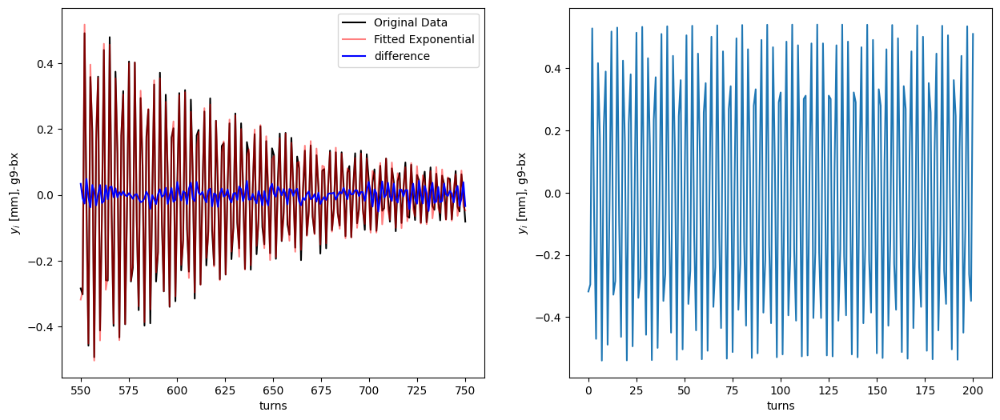

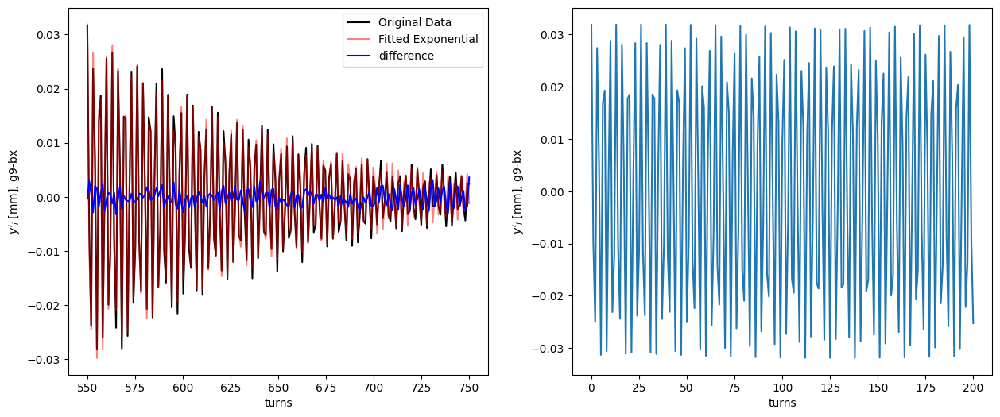

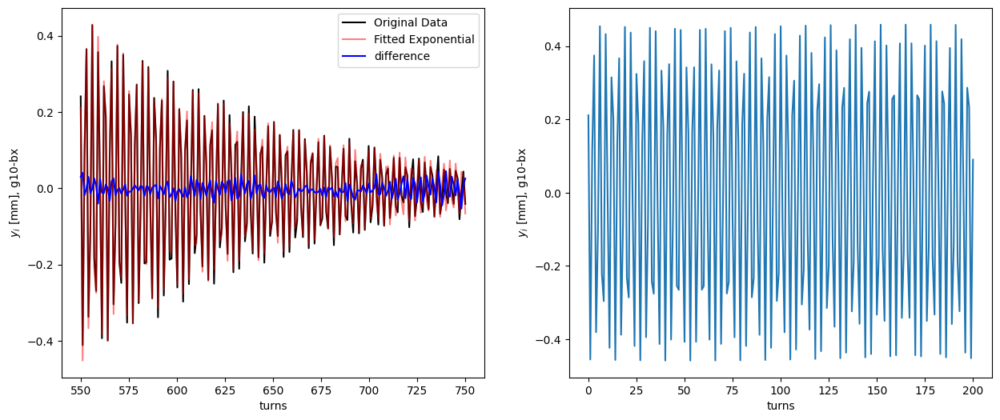

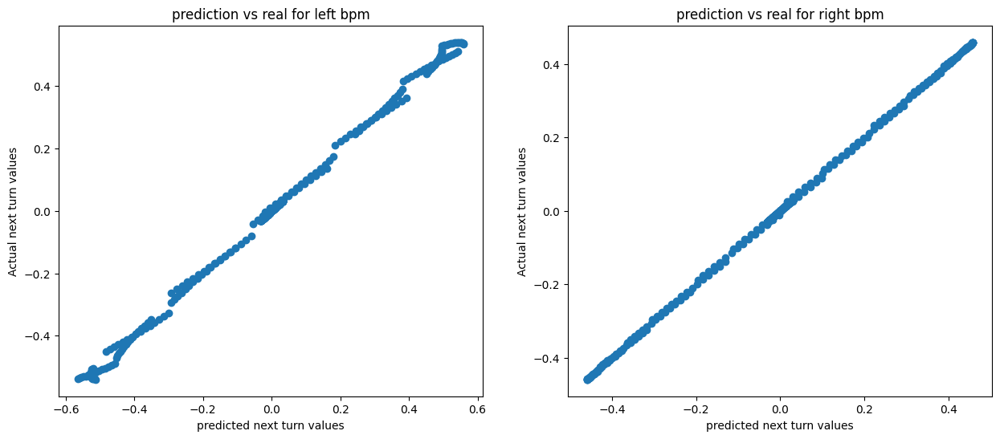

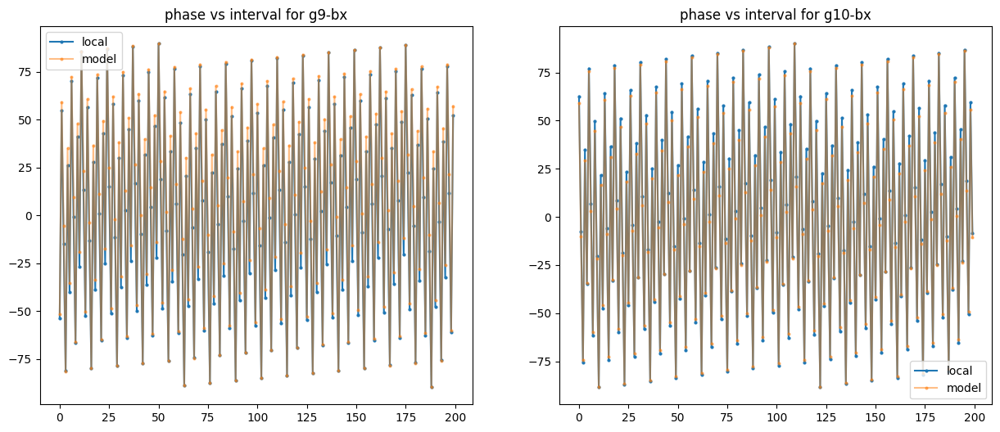

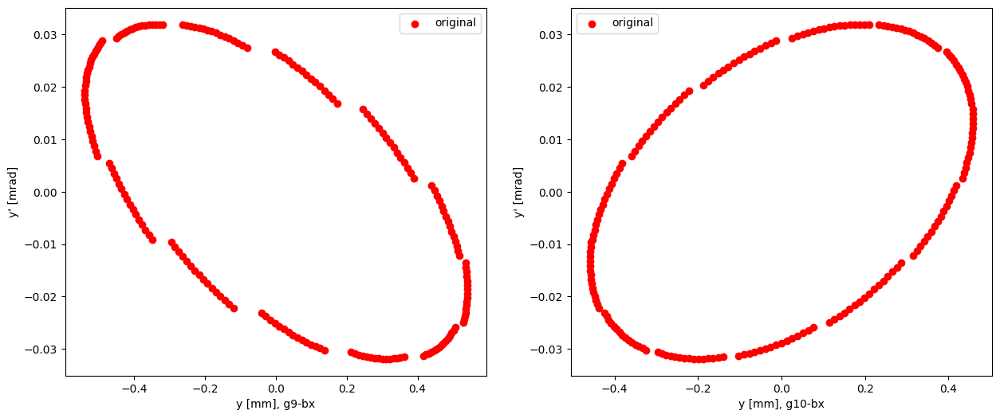

r1 mean, std: 0.11790524842847688 0.0021876063257655998
r2 mean, std: 0.1151616965889717 0.0006363182906470875


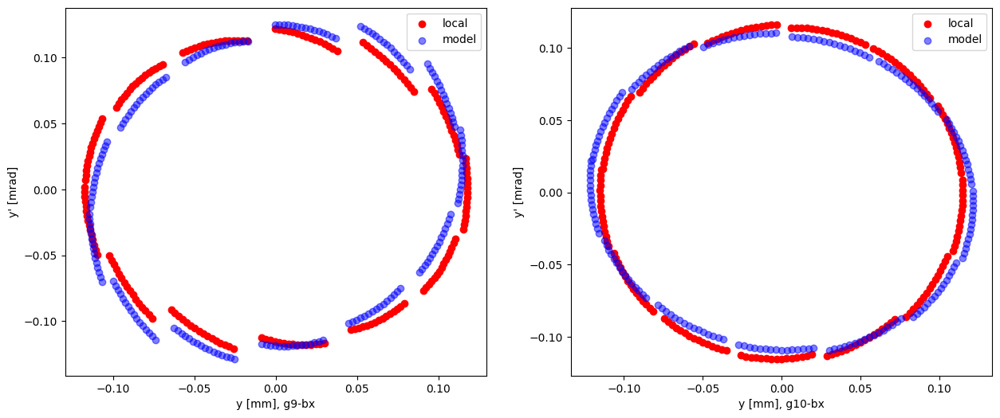

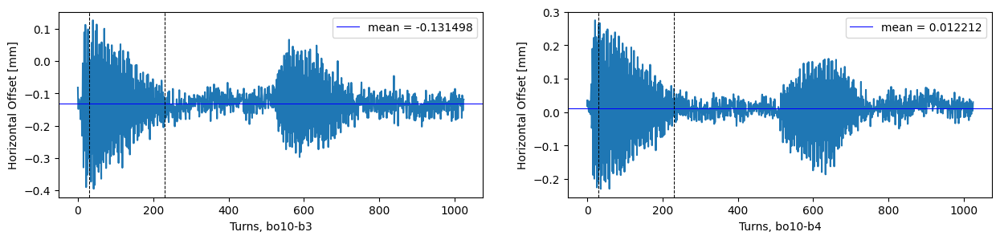

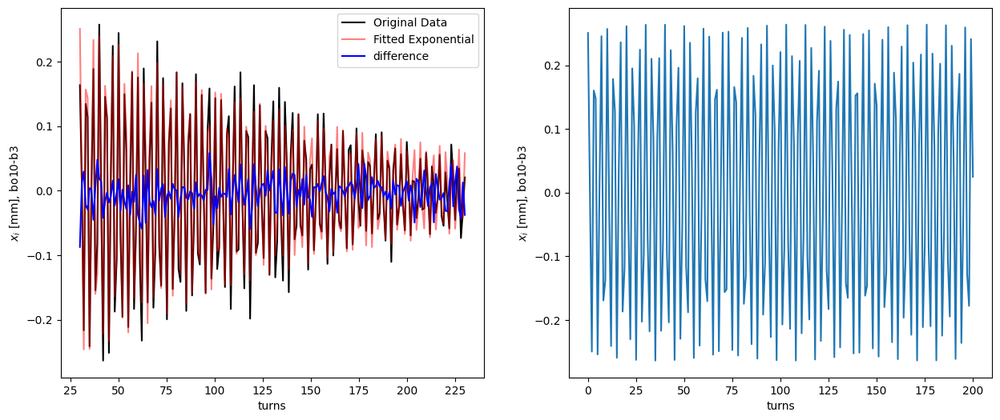

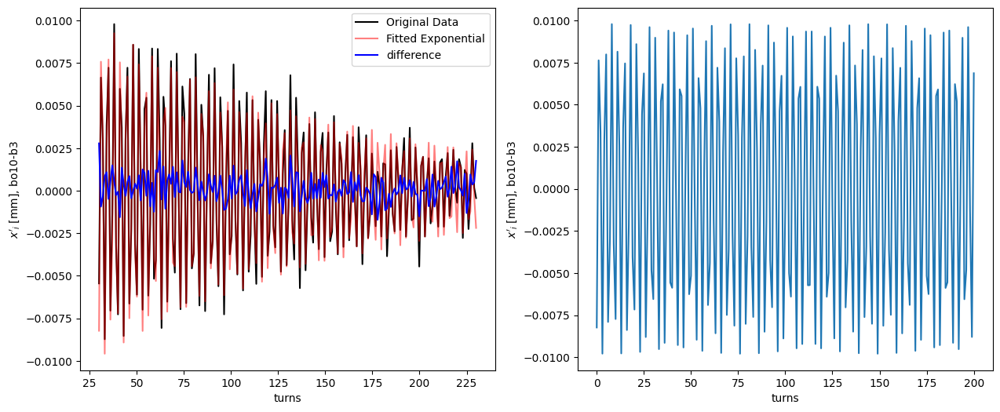

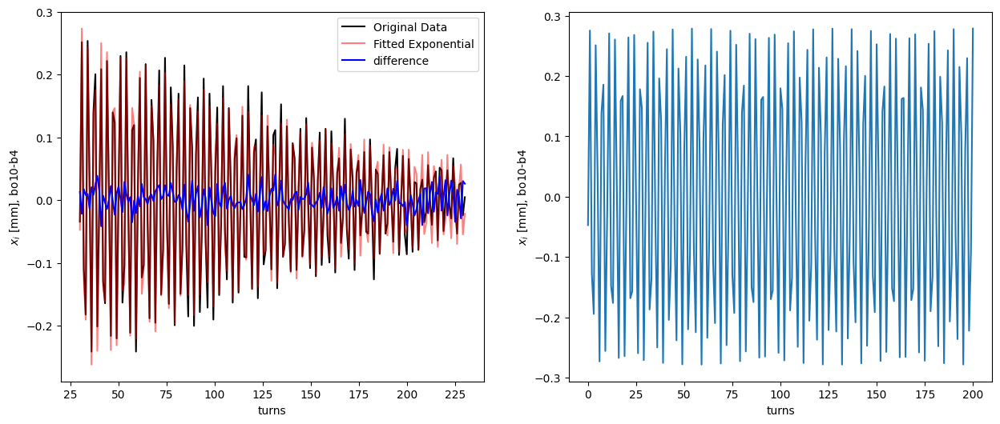

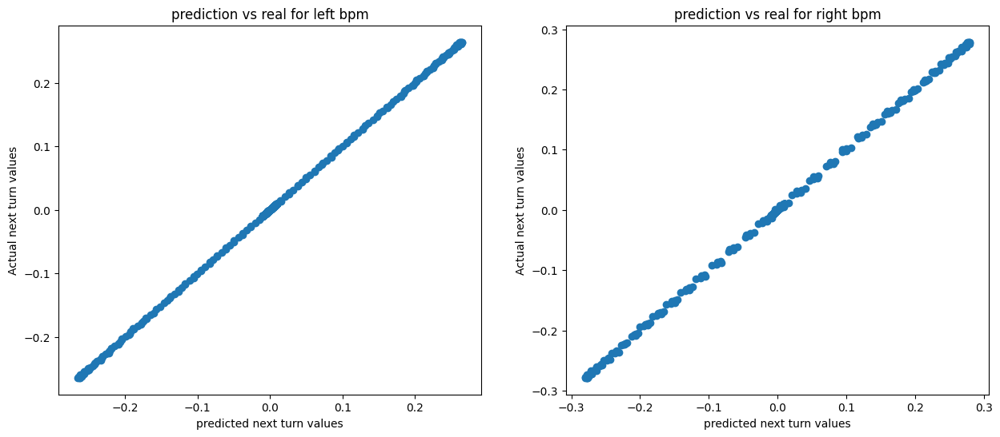

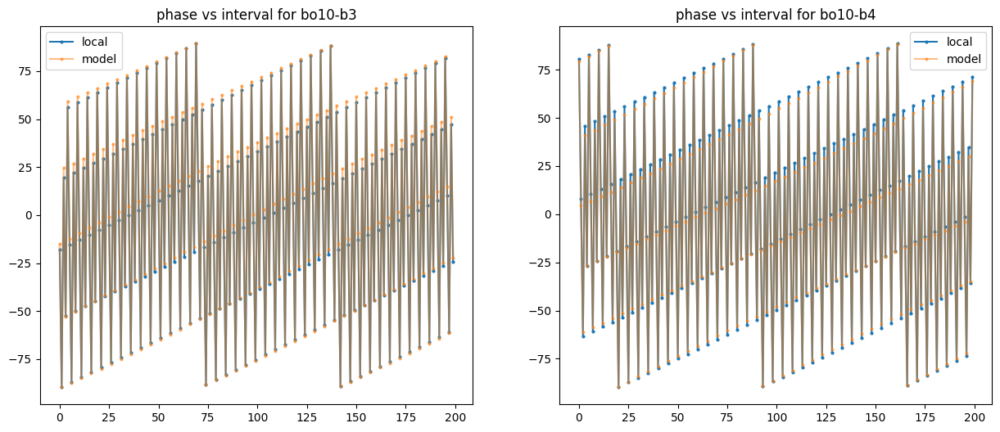

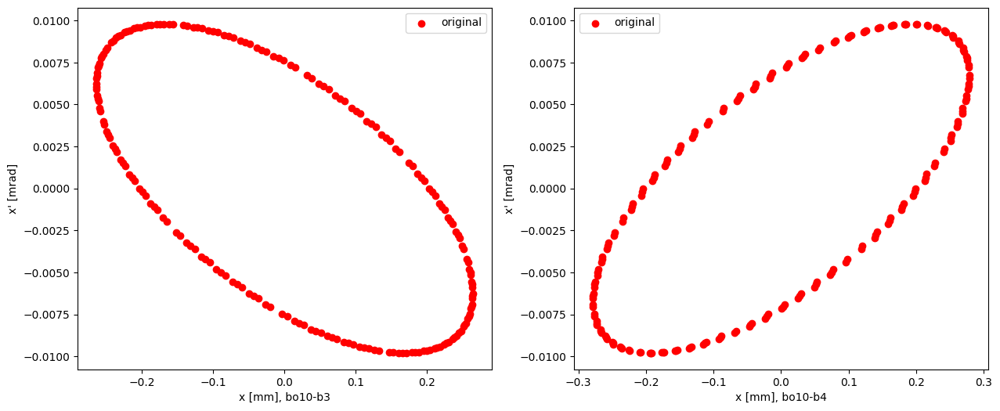

r1 mean, std: 0.04464012407539114 0.00013428877439579221
r2 mean, std: 0.04446529420141299 0.00031221219454803916


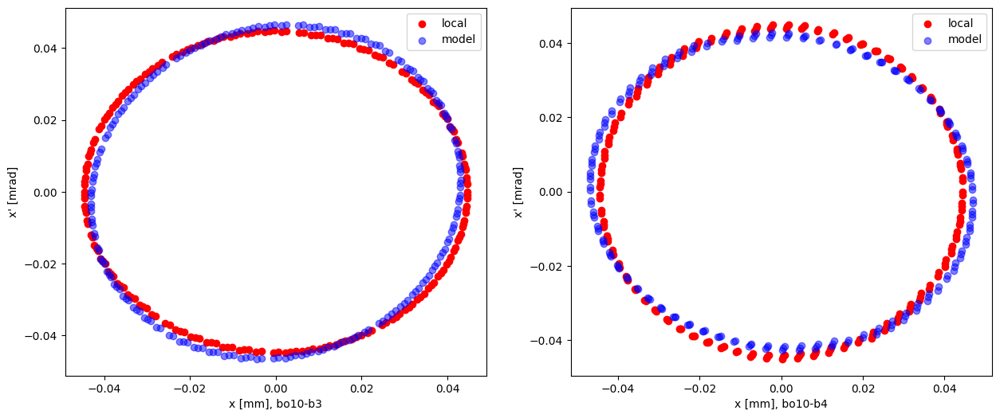

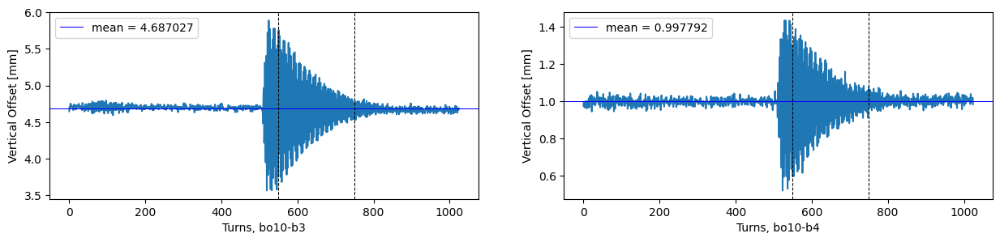

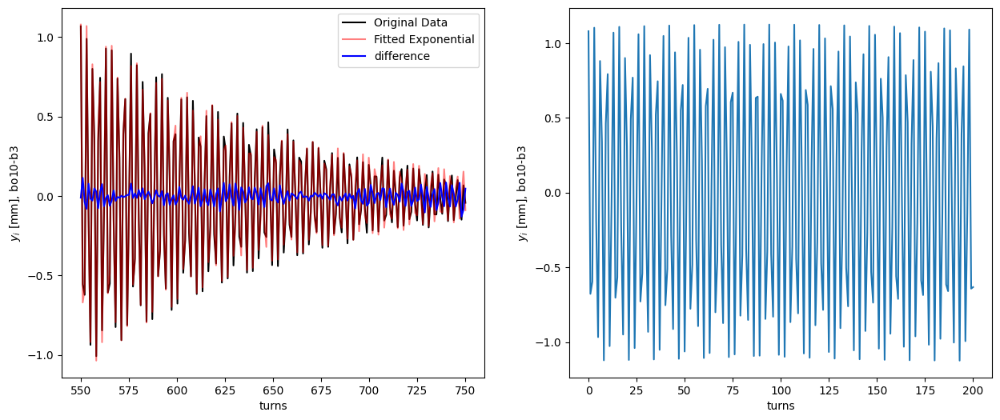

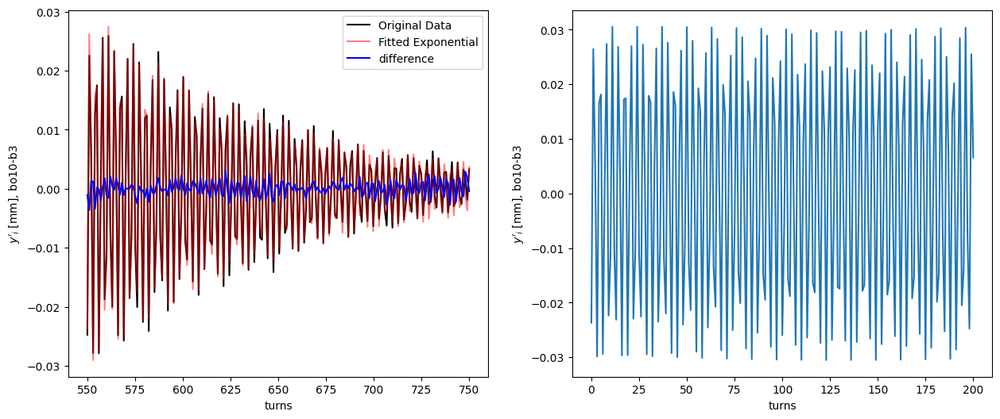

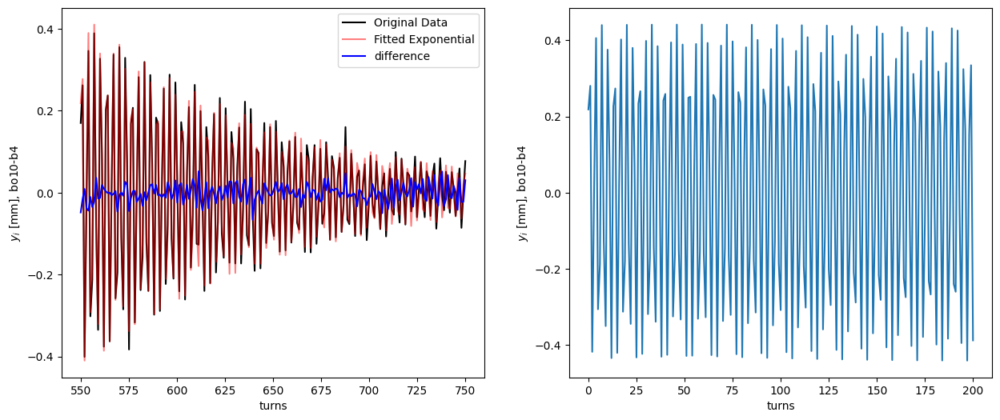

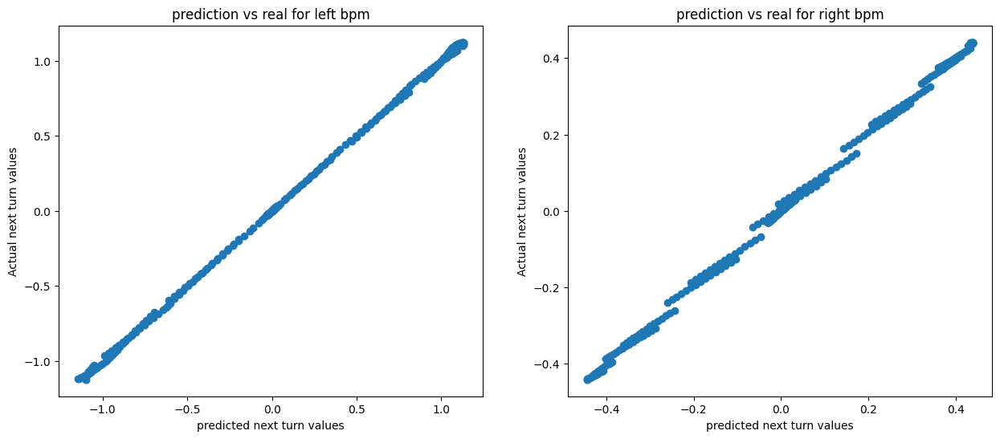

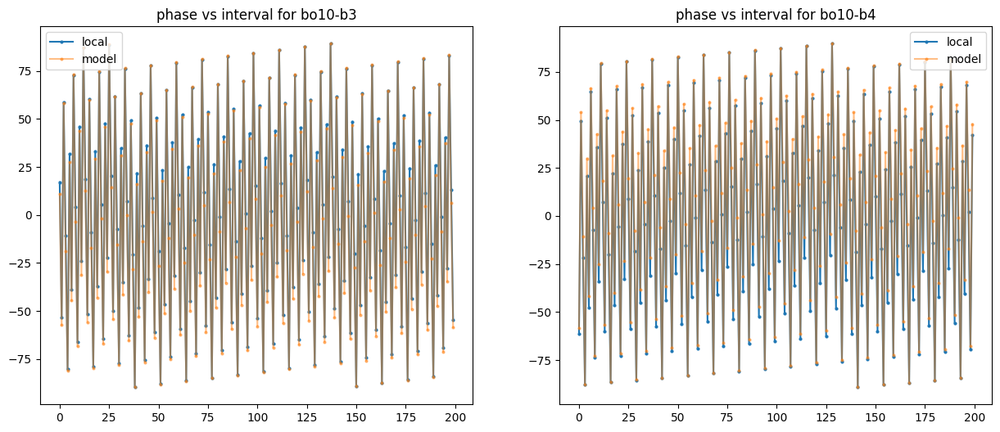

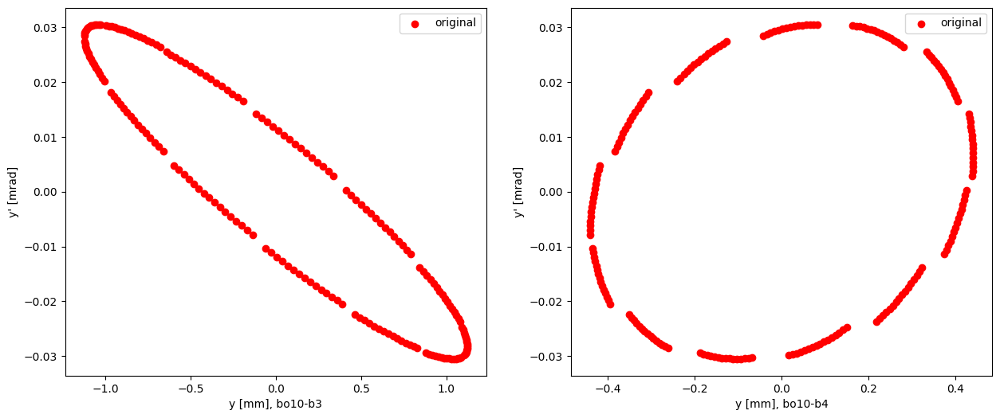

r1 mean, std: 0.11427456518814996 0.0010063128818100636
r2 mean, std: 0.11462123855447989 0.001445152876520384


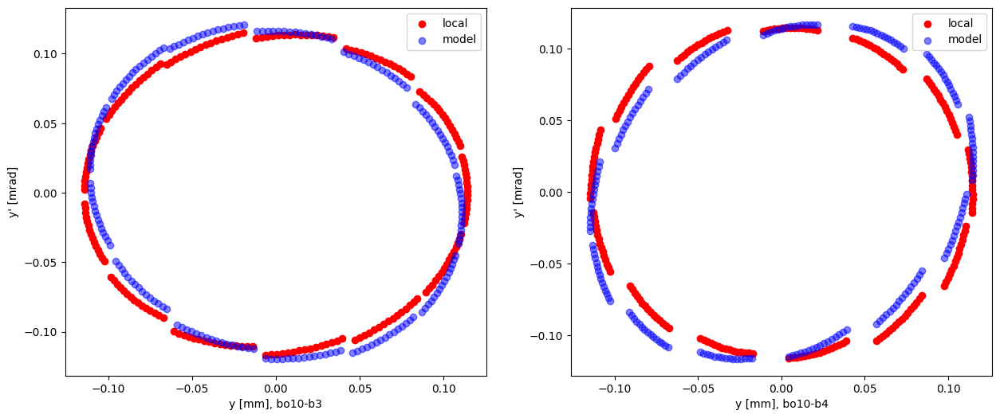

In [16]:
intervalx = 200
intervaly = 200

############ downstream of IP10 ############
Intervalsx = (30, intervalx)
Intervalsy = (550, intervaly)
Bpmsx = 53, 55
Bpmsy = 53, 54
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_d10x, Data2_d10x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
# print(Data1_d10x)
# print(Data2_d10x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_d10y, Data2_d10y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
# print(Data1_d10y)
# print(Data2_d10y)

############ at IP10 ############
Intervalsx = (30, intervalx)
Intervalsy = (550, intervaly)
Bpmsx = 57, 60
Bpmsy = 56, 59
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_10x, Data2_10x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
# print(Data1_10x)
# print(Data2_10x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_10y, Data2_10y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
# print(Data1_10y)
# print(Data2_10y)

############ upstream of IP10 ############
Intervalsx = (30, intervalx)
Intervalsy = (550, intervaly)
Bpmsx = 62, 64
Bpmsy = 61, 63
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_u10x, Data2_u10x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
# print(Data1_u10x)
# print(Data2_u10x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_u10y, Data2_u10y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
# print(Data1_u10y)
# print(Data2_u10y)


### Around IP12 

Bad Horizontal BPMs: [18, 58, 59, 75, 102, 113, 114, 122, 137, 140, 142]
Bad Vertical BPMs: [27, 57, 58, 62, 71, 111, 112, 113, 125, 140]


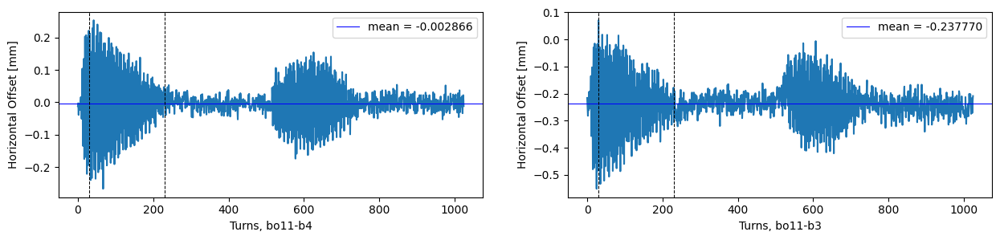

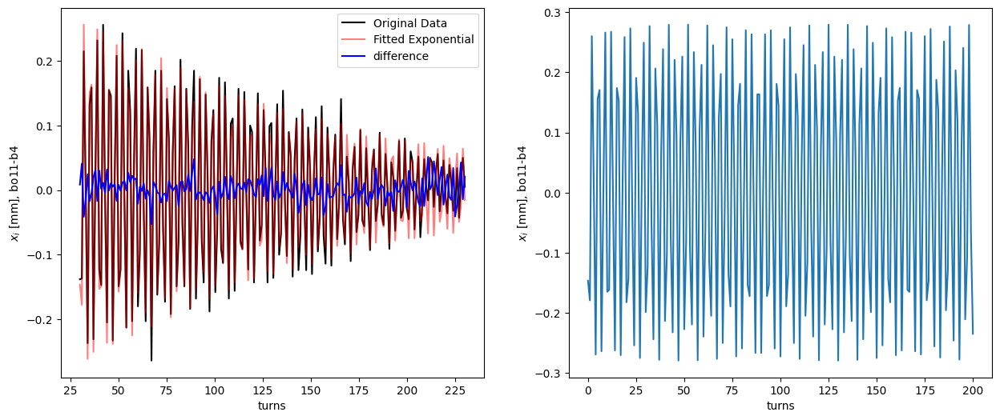

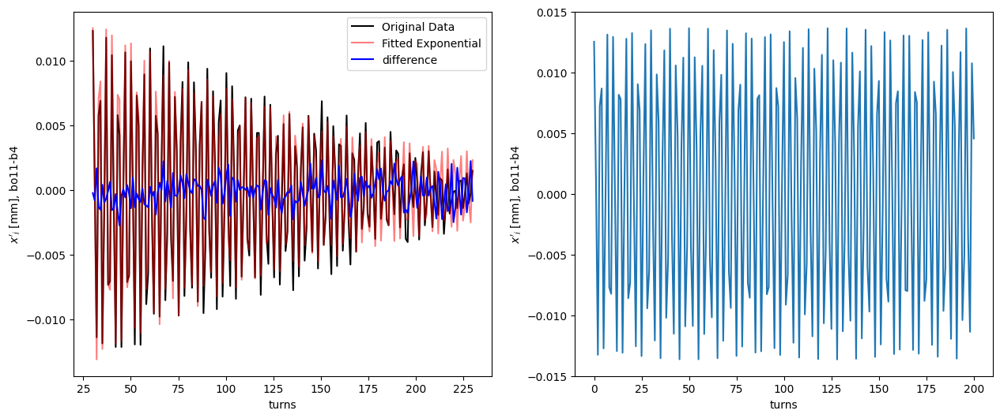

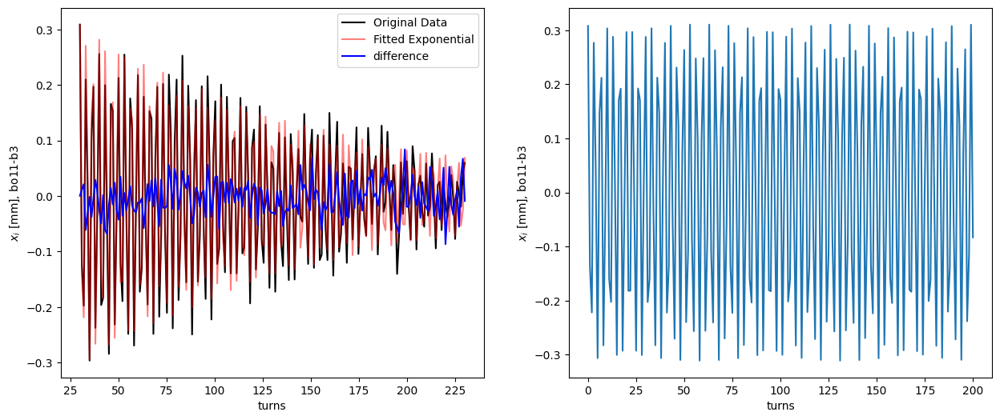

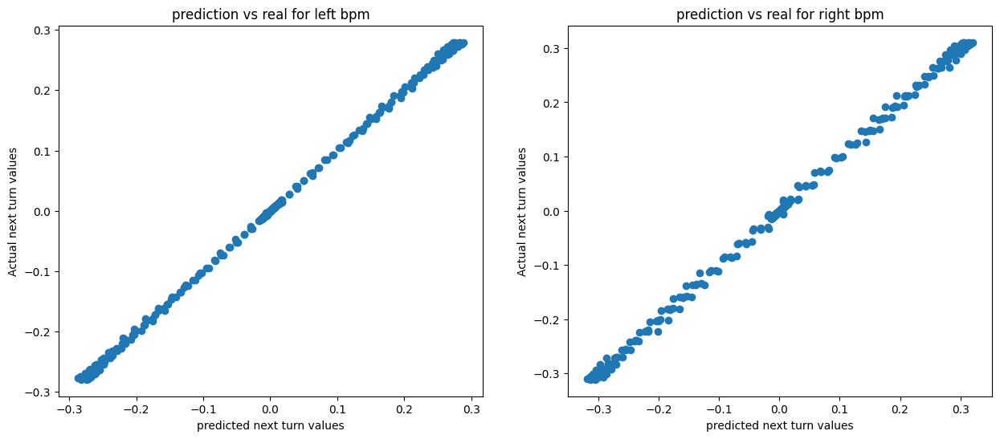

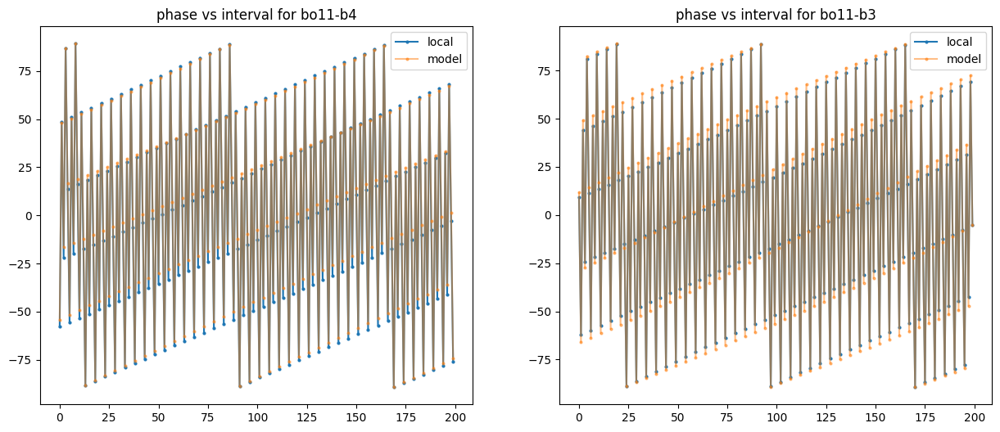

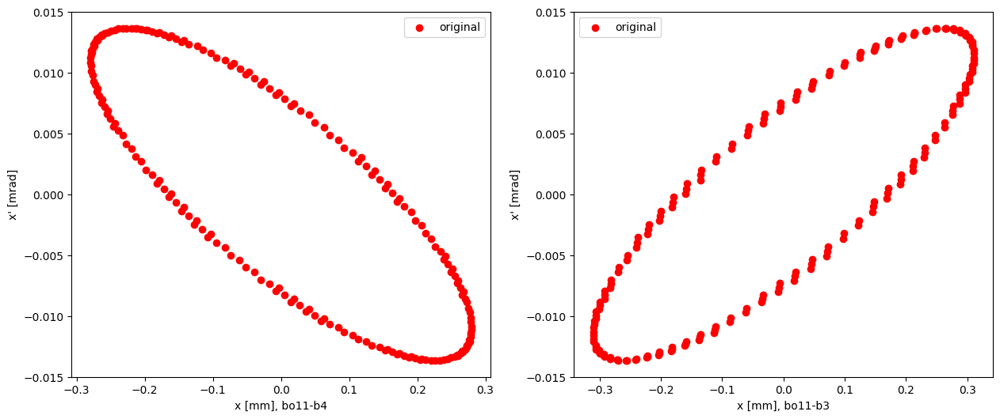

r1 mean, std: 0.04753261043986482 0.0005787562861711362
r2 mean, std: 0.04801926387050858 0.0010016940304434752


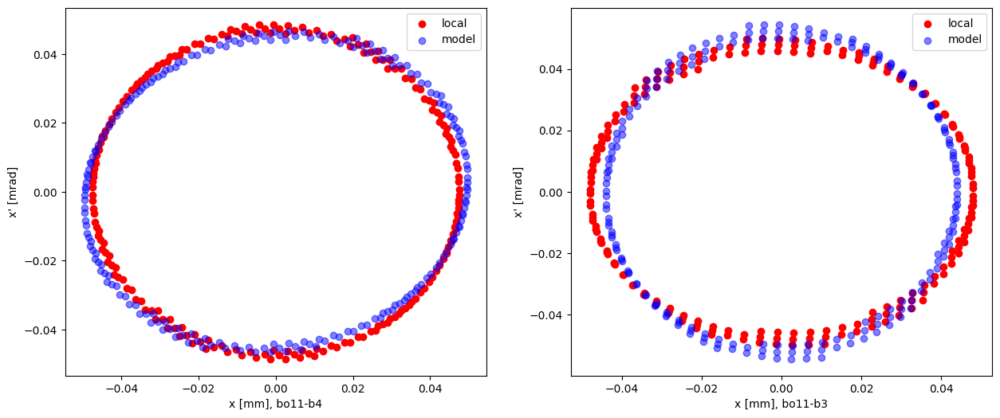

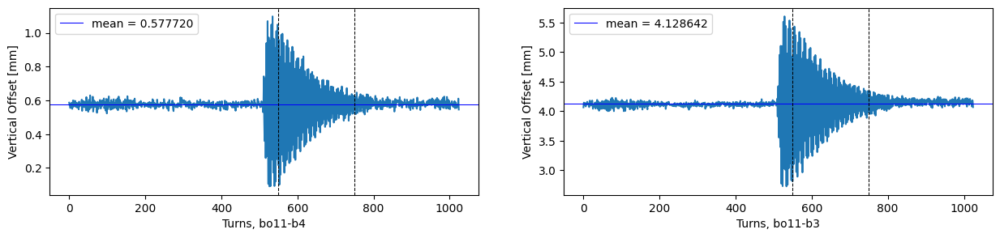

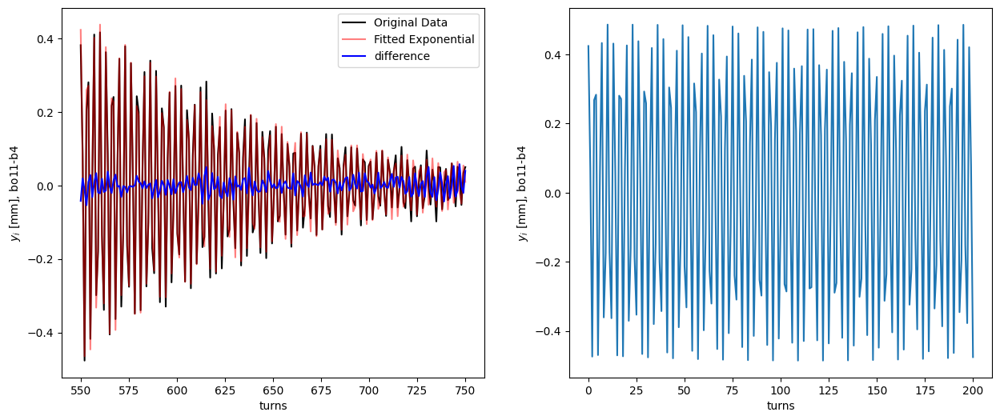

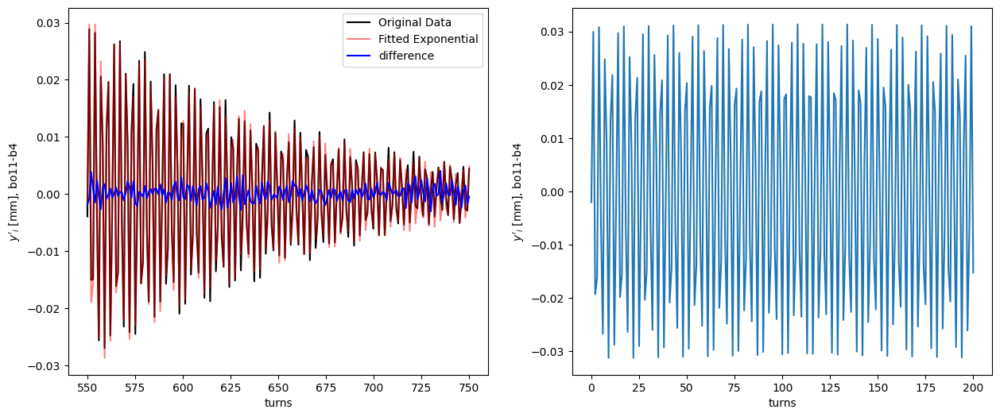

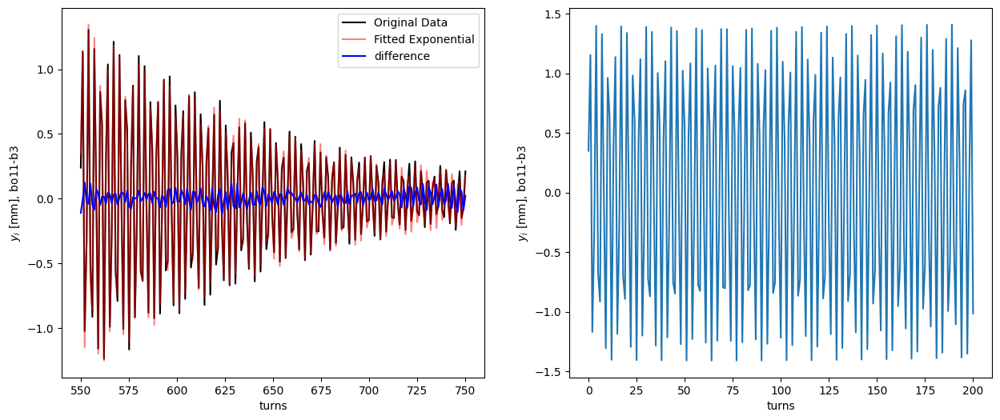

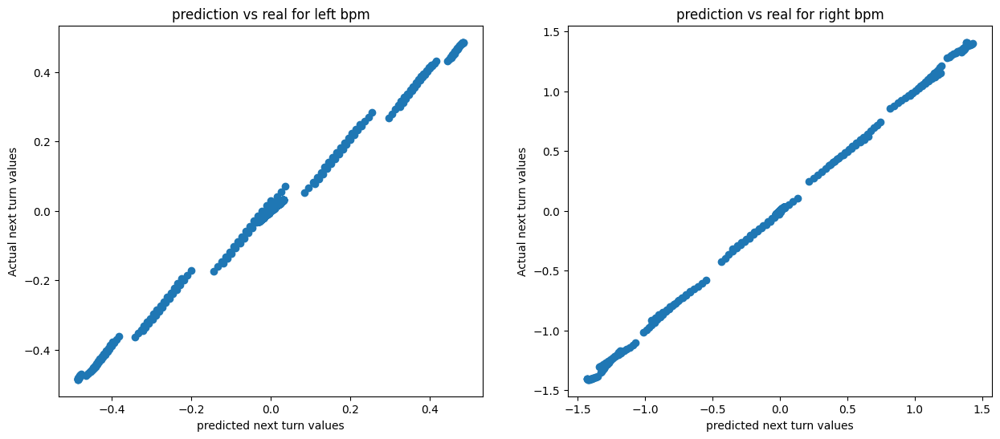

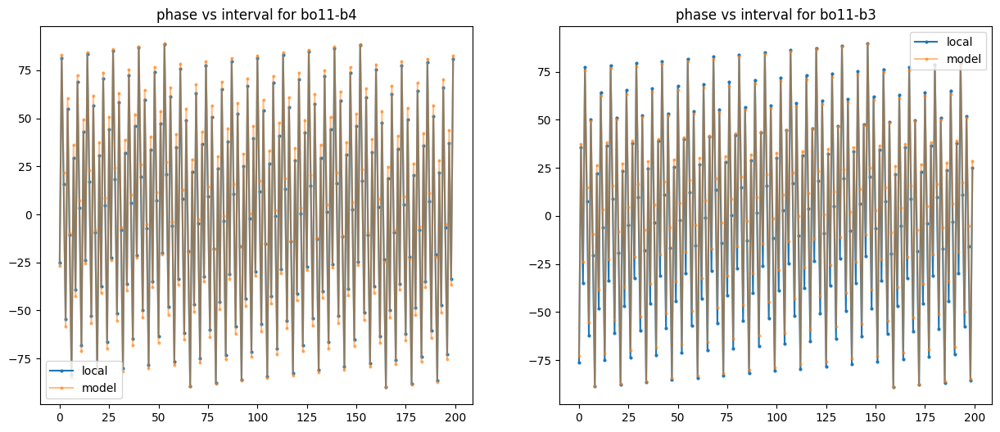

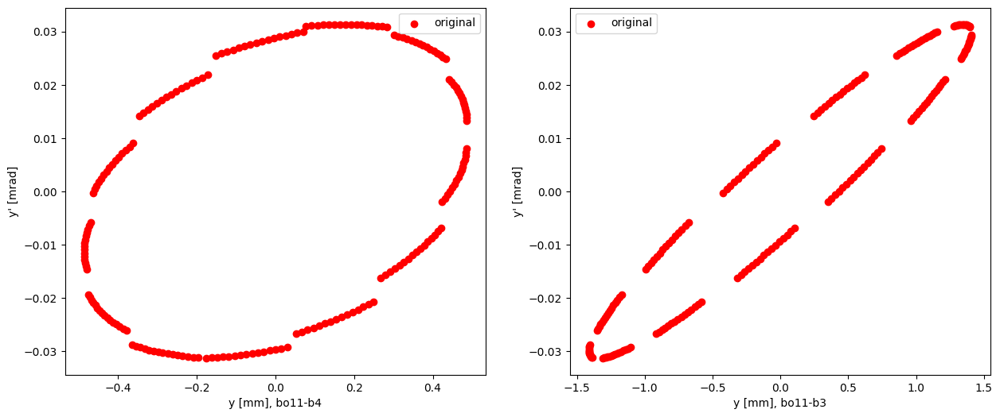

r1 mean, std: 0.11902828283567662 0.002107605246565522
r2 mean, std: 0.11532102953256768 0.0012225585521156643


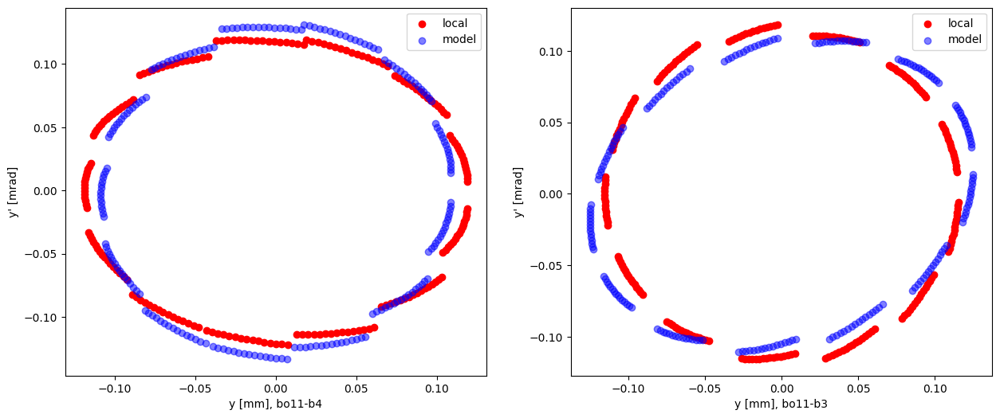

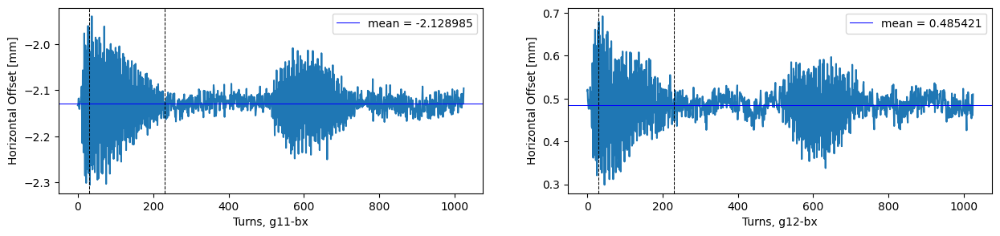

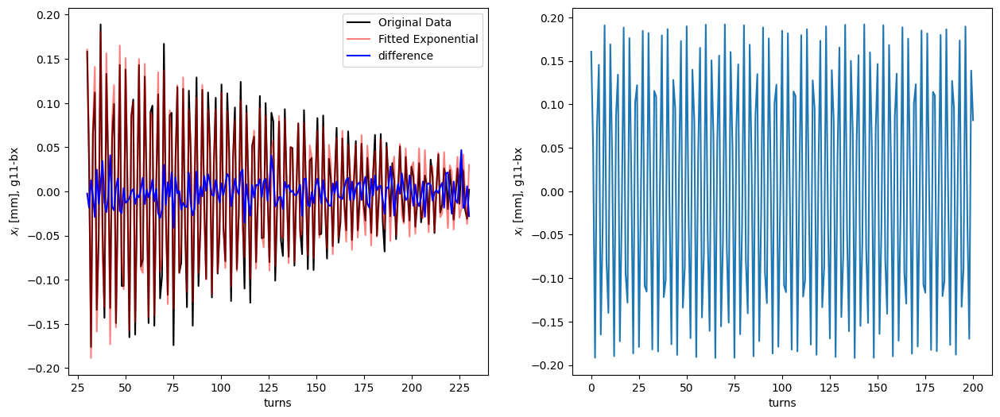

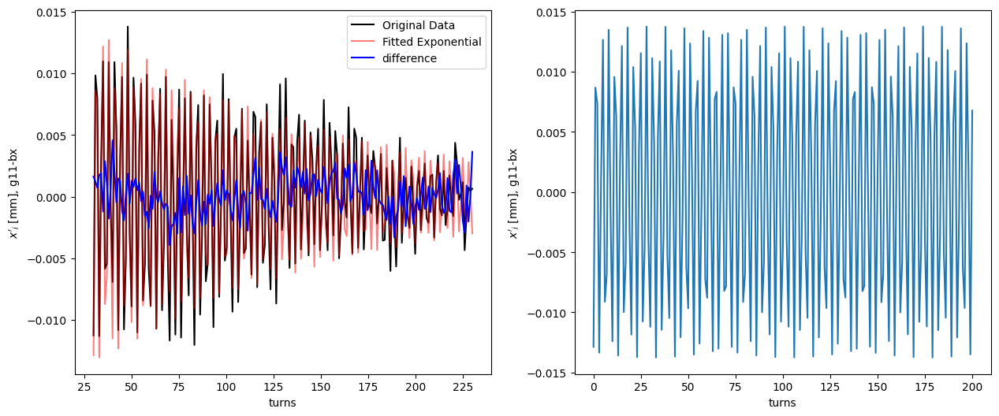

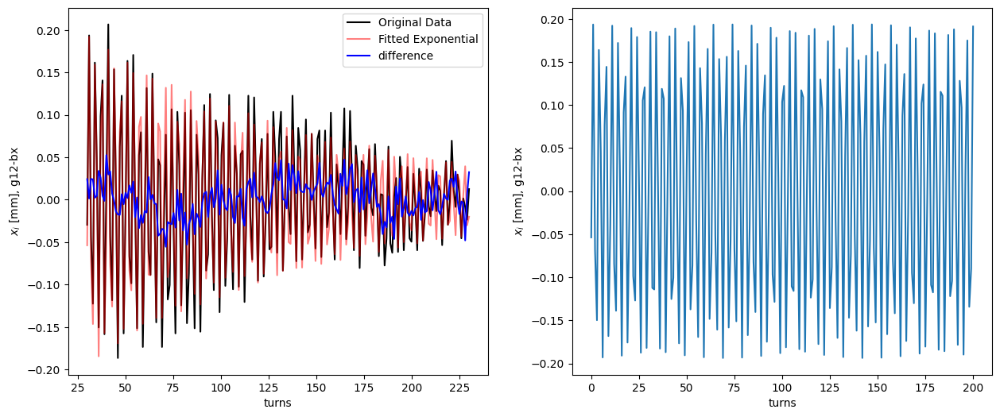

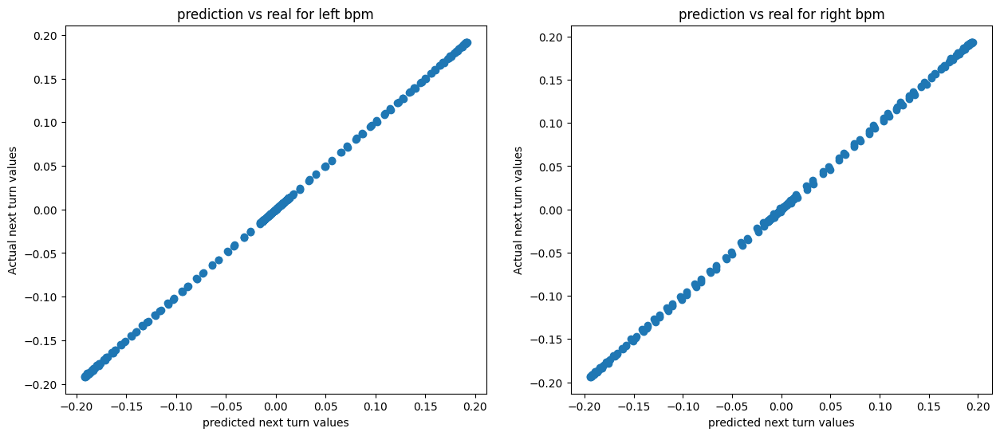

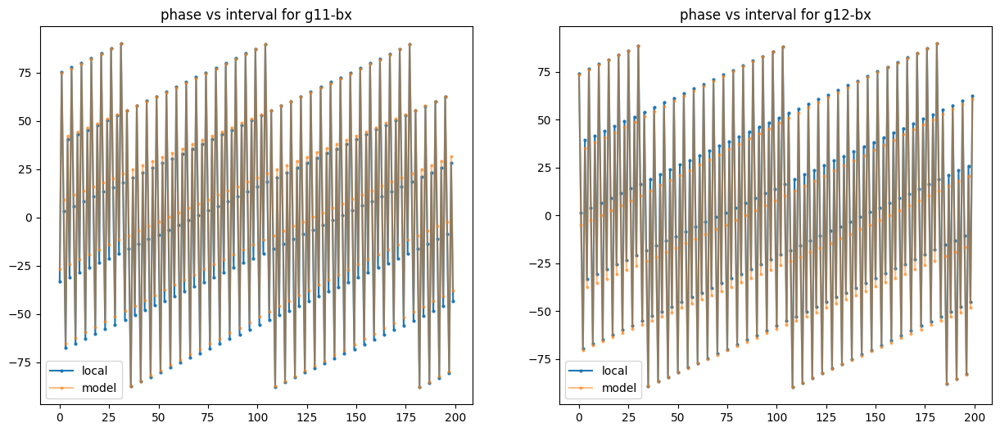

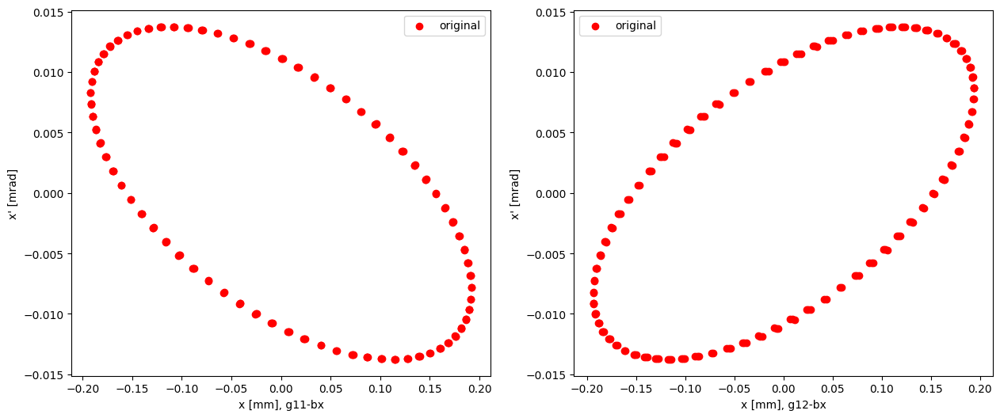

r1 mean, std: 0.046274695612417795 0.00010562812935759943
r2 mean, std: 0.045909627531048776 0.00026316654252357924


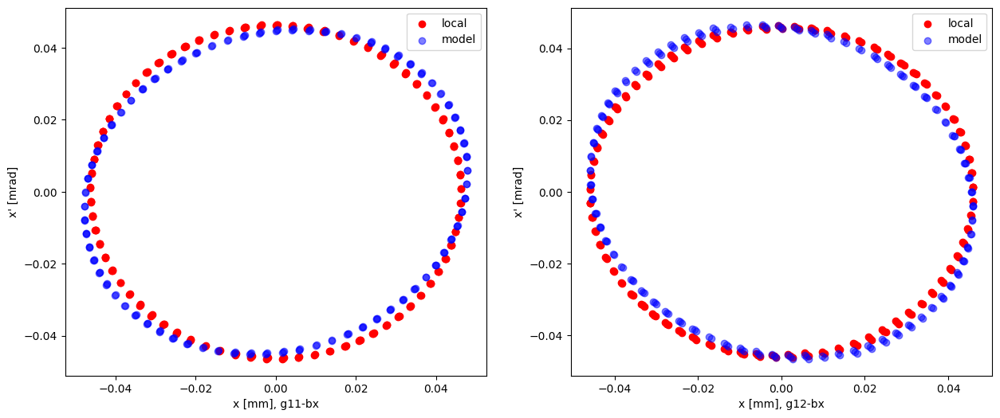

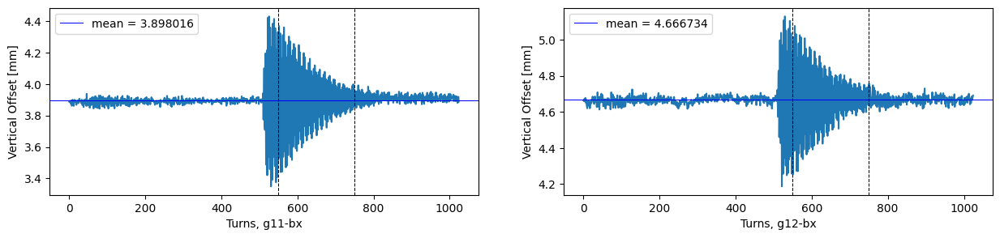

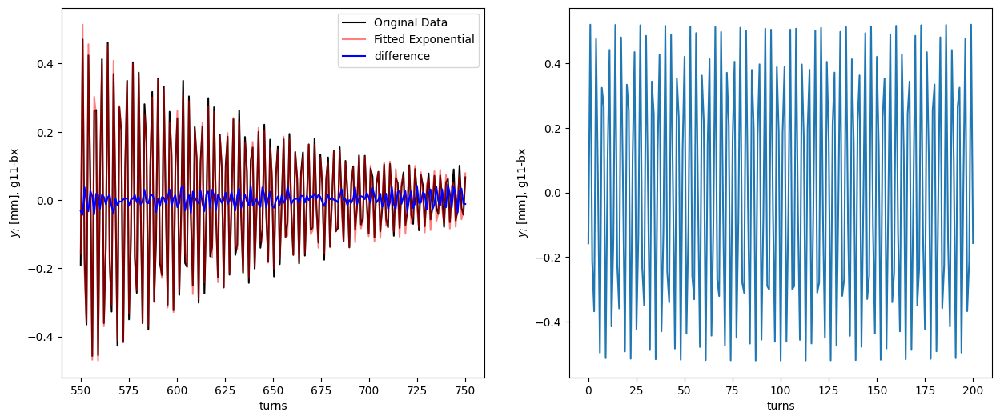

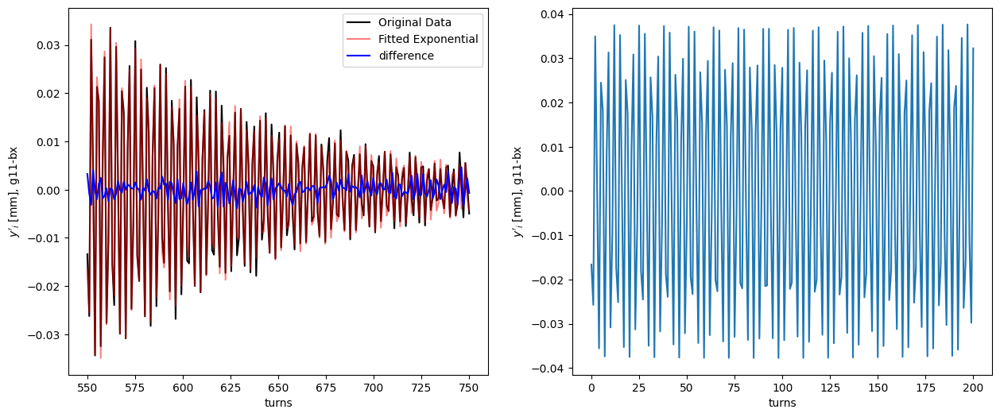

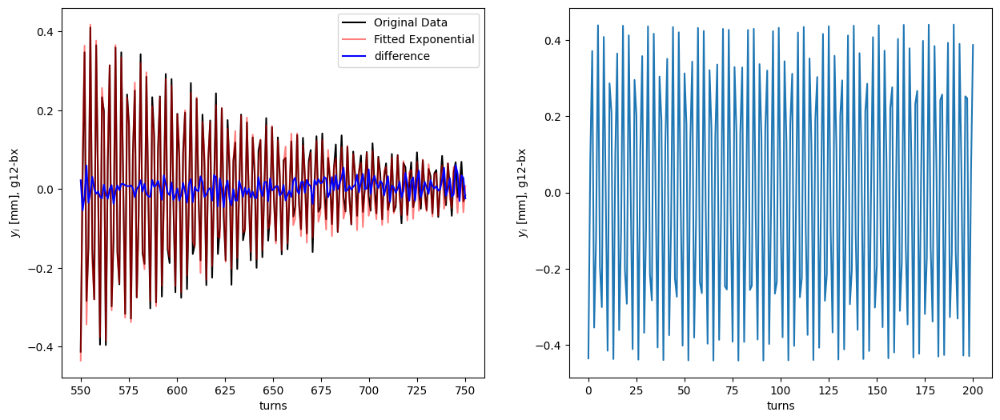

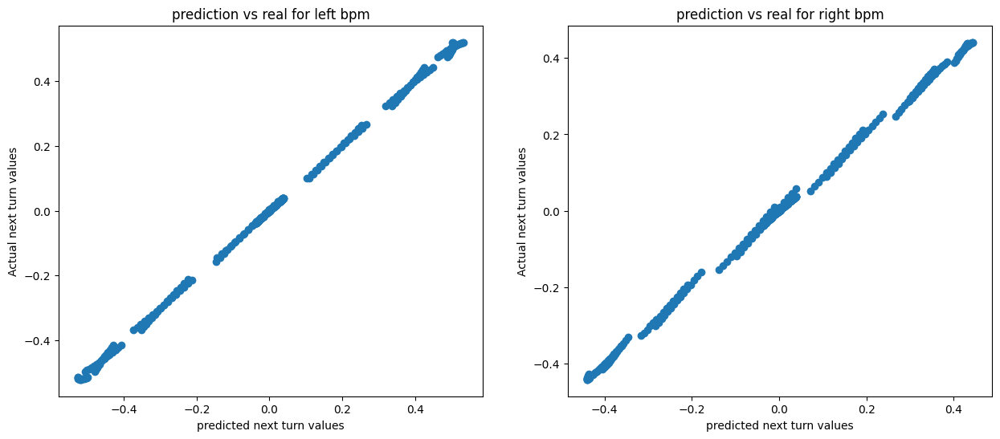

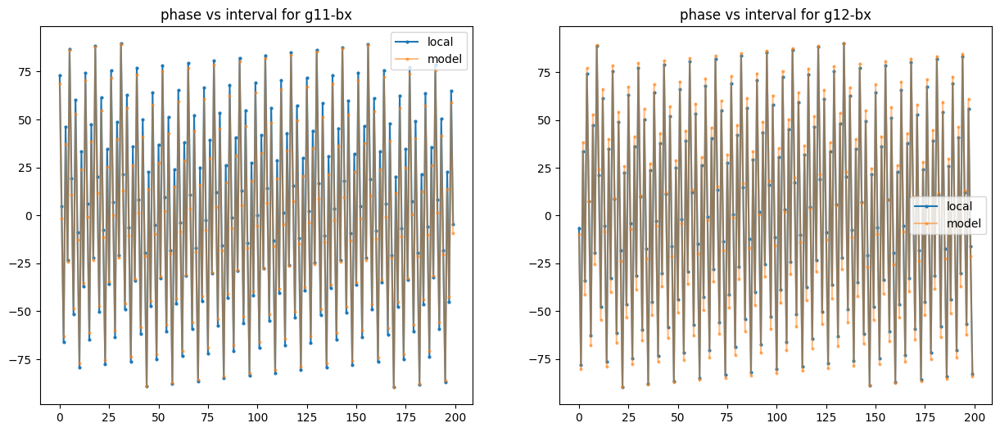

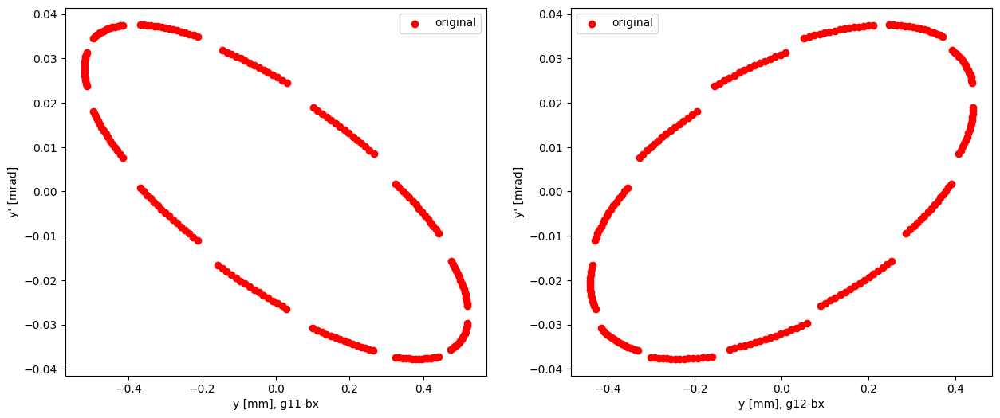

r1 mean, std: 0.11512435551619013 0.0011592565737948317
r2 mean, std: 0.11825097245545341 0.001627541226378745


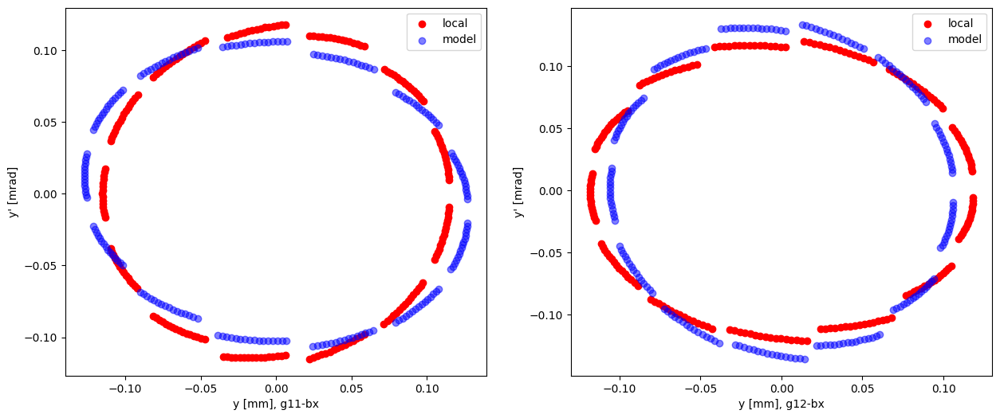

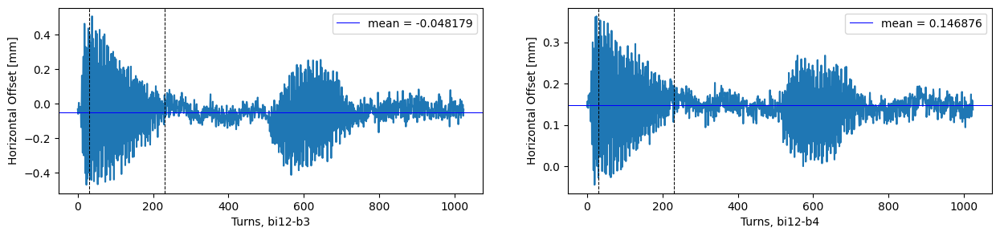

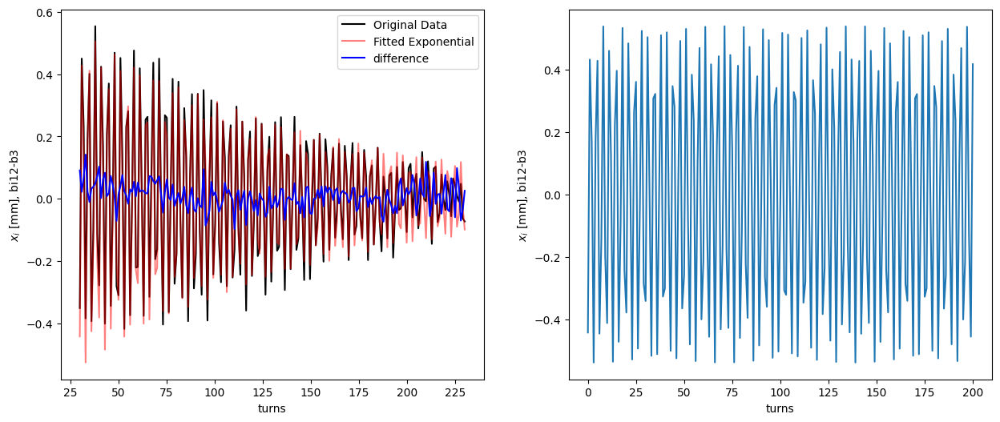

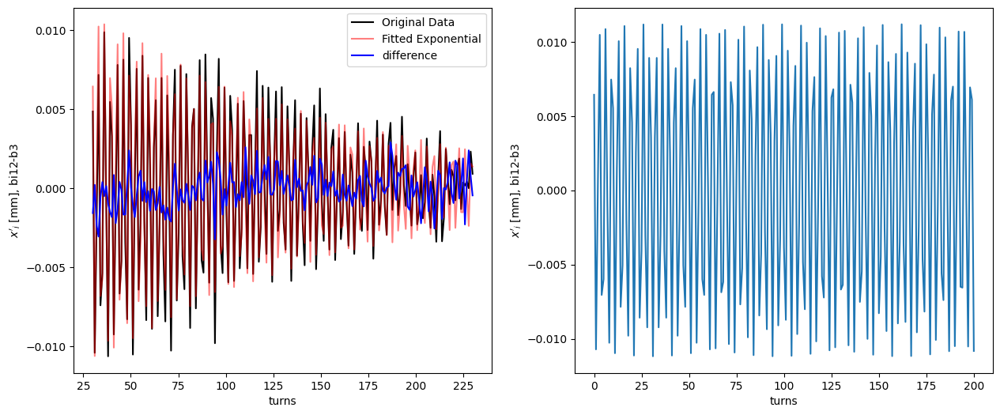

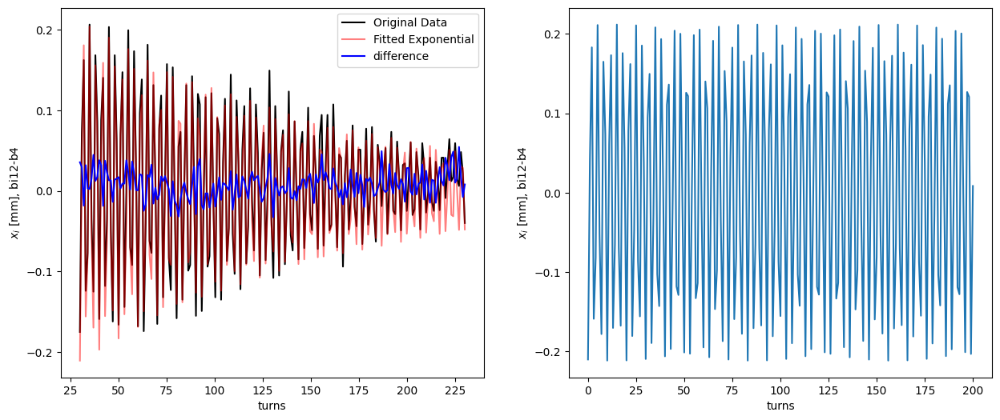

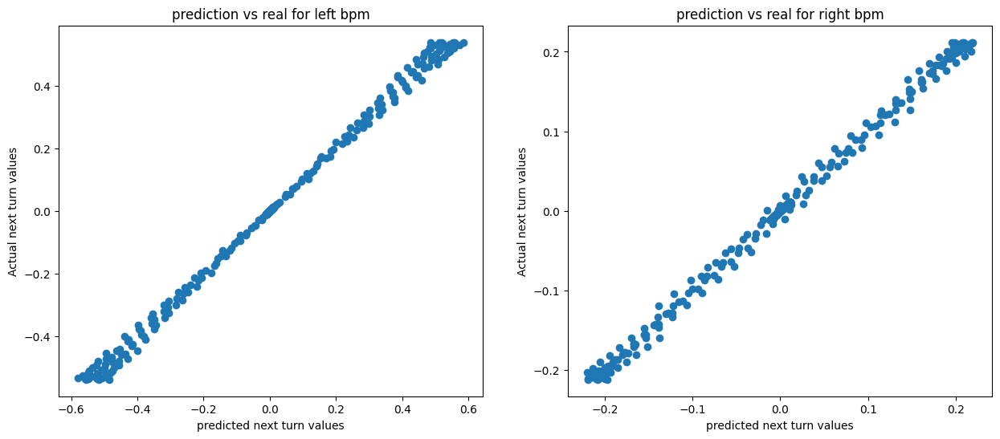

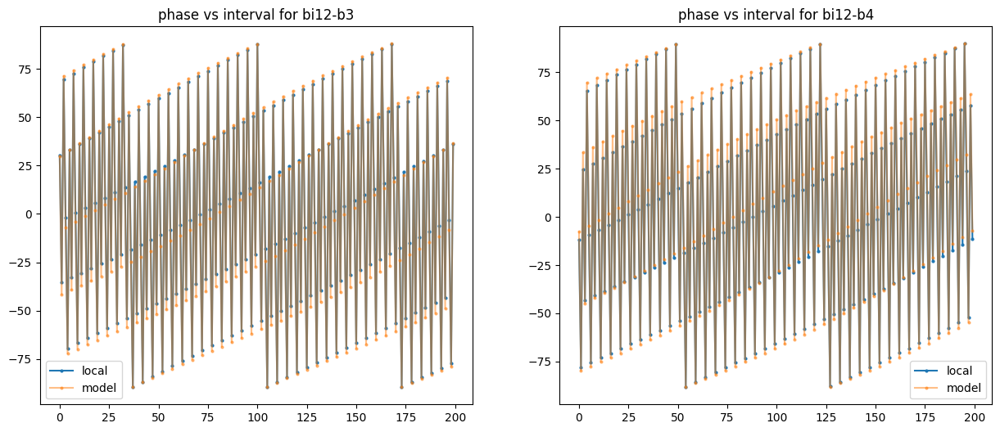

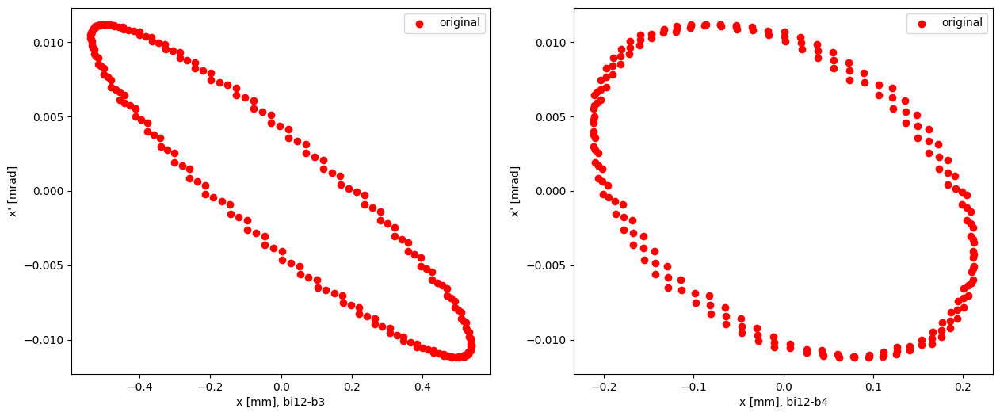

r1 mean, std: 0.04785559784363426 0.0016756830531504544
r2 mean, std: 0.04673435350167823 0.001170826167399319


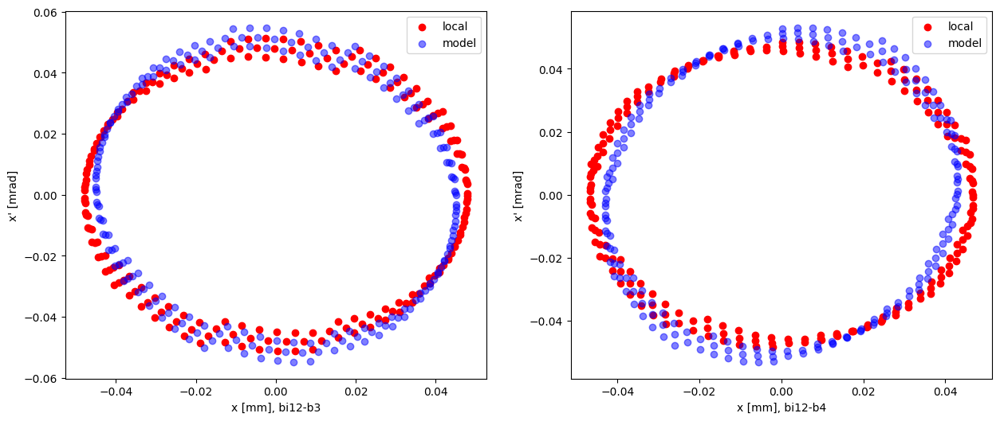

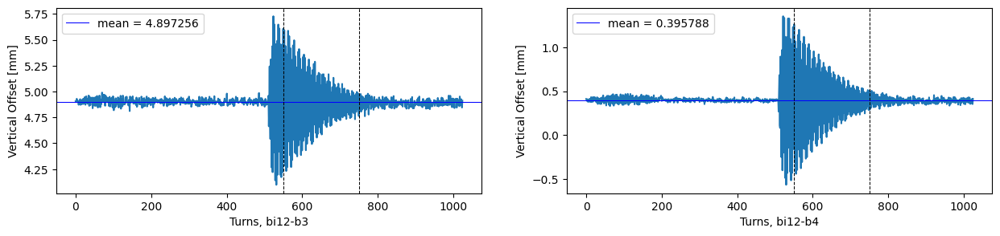

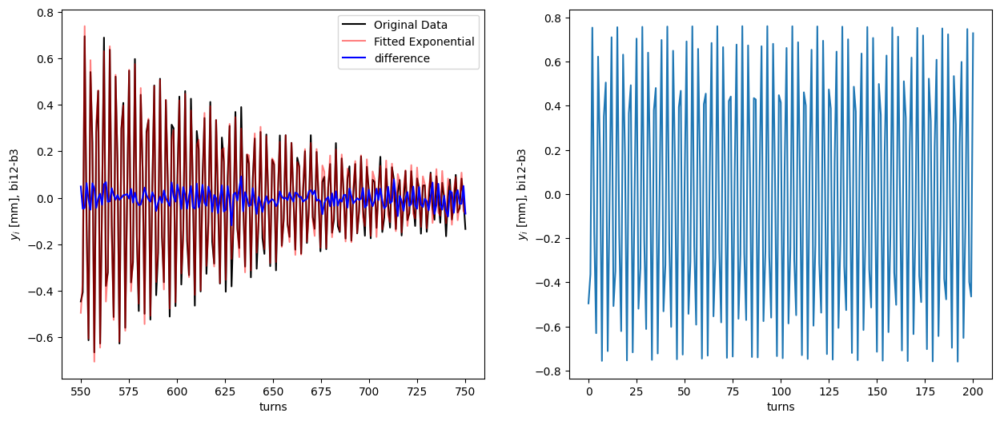

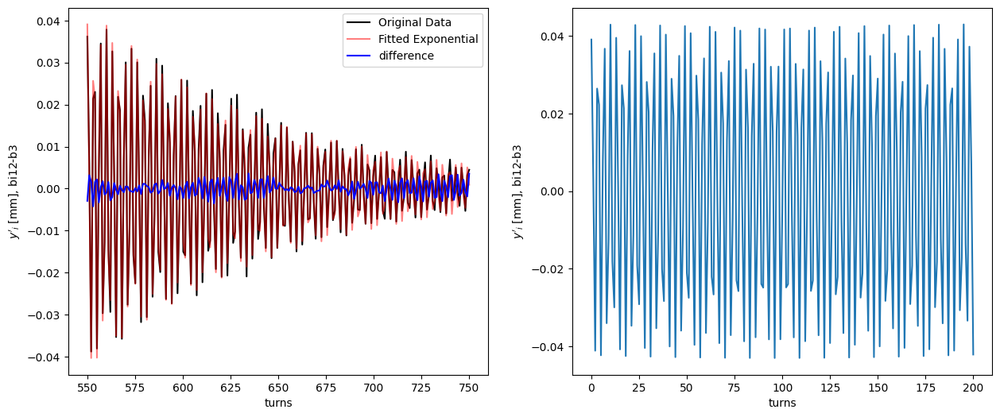

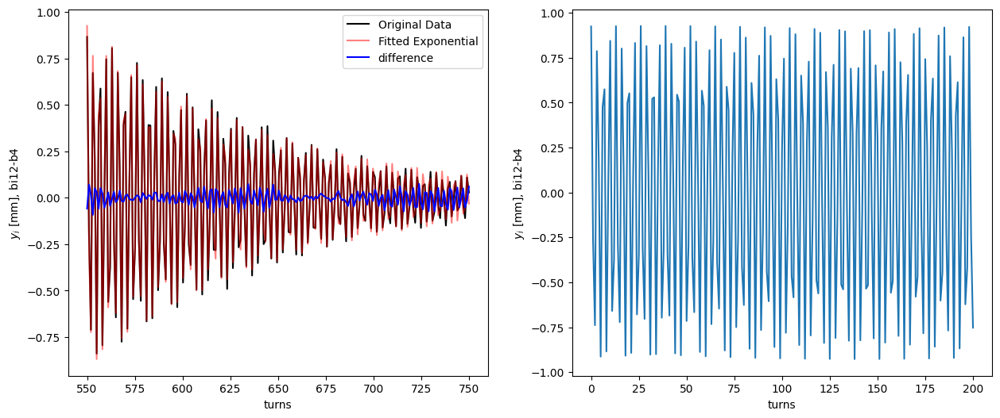

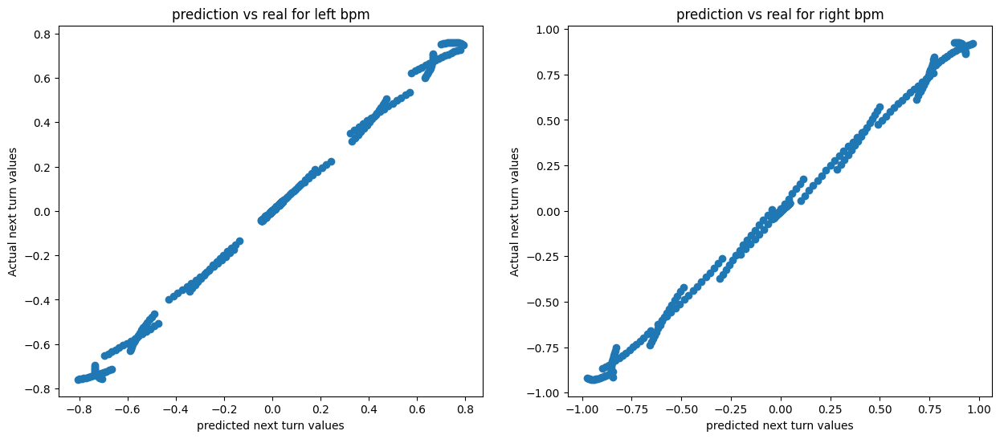

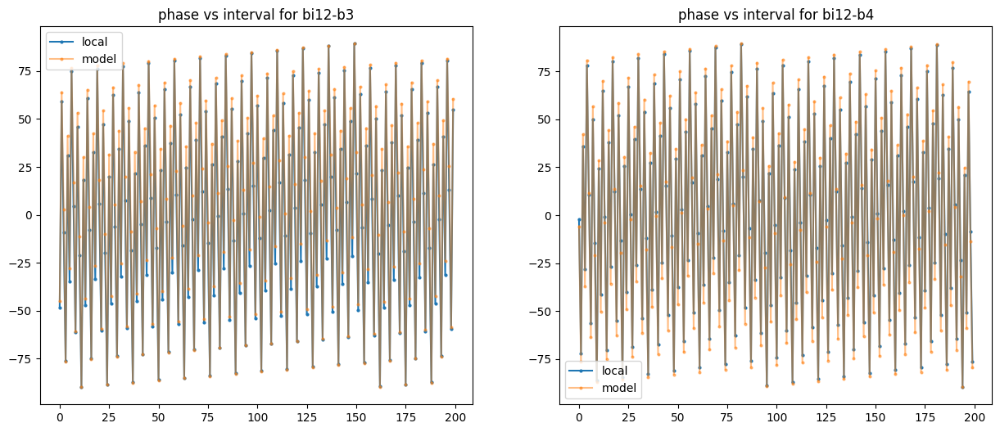

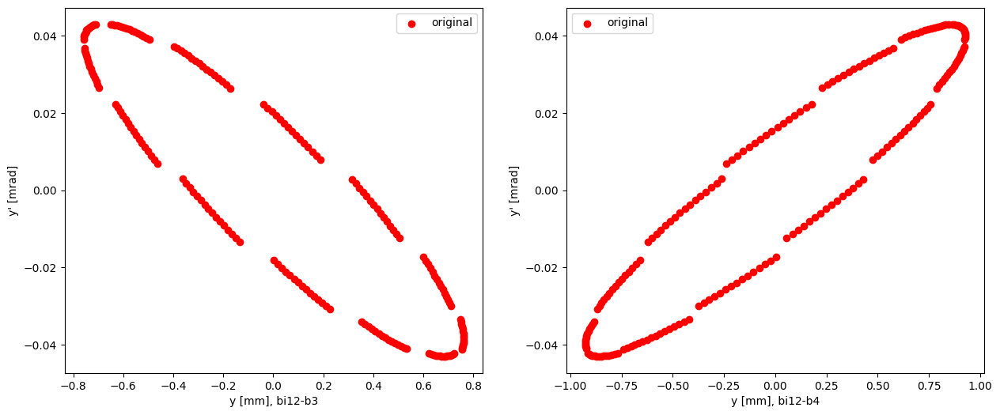

r1 mean, std: 0.12092986786762641 0.002959481472105929
r2 mean, std: 0.12246054169236956 0.0037831134280695124


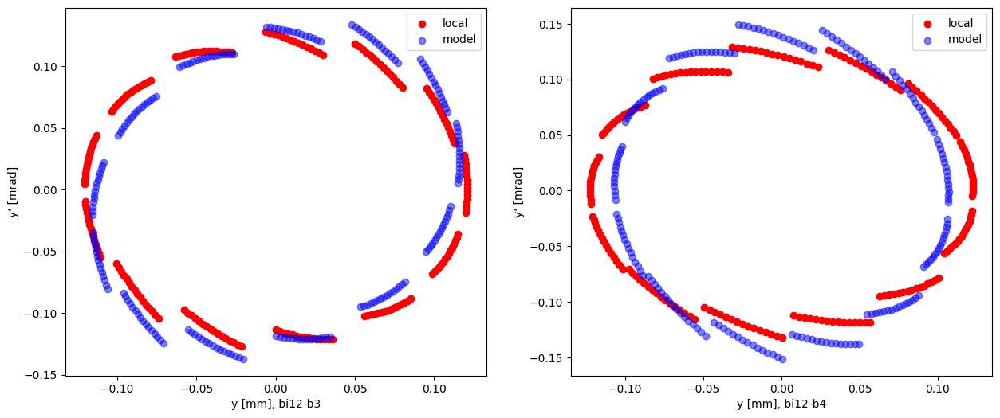

In [17]:
intervalx = 200
intervaly = 200
print("Bad Horizontal BPMs:", Bad_Bpms(BPMx_Tune_Map, nu_x, N_BPMx))
print("Bad Vertical BPMs:", Bad_Bpms(BPMy_Tune_Map, nu_y, N_BPMy))

############ downstream of IP12 ############
Intervalsx = (30, intervalx)
Intervalsy = (550, intervaly)
Bpmsx = 83, 84
Bpmsy = 83, 84
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_d12x, Data2_d12x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
# print(Data1_d12x)
# print(Data2_d12x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_d12y, Data2_d12y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
# print(Data1_d12y)
# print(Data2_d12y)

############ at IP12 ############
Intervalsx = (30, intervalx)
Intervalsy = (550, intervaly)
Bpmsx = 86, 87
Bpmsy = 86, 87
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_12x, Data2_12x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
# print(Data1_12x)
# print(Data2_12x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_12y, Data2_12y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
# print(Data1_12y)
# print(Data2_12y)

############ upstream of IP12 ############
Intervalsx = (30, intervalx)
Intervalsy = (550, intervaly)
Bpmsx = 89, 90
Bpmsy = 89, 90
bpm_signals(Bpmsx, BPMx, Intervalsx, Name_xbpms, True)
Data1_u12x, Data2_u12x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp, True)
# print(Data1_u12x)
# print(Data2_u12x)

bpm_signals(Bpmsy, BPMy, Intervalsy, Name_ybpms, False)
Data1_u12y, Data2_u12y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp, True)
# print(Data1_u12y)
# print(Data2_u12y)


# Vary Number of turns used in LR

## Produce Excel File of all data

Run LR calculation and store variables into excel file for a selection of intervals

In [18]:
Drift_bpmx = [(163, 165), (167, 0), (2, 4), (23, 25), (27, 28), (30, 32),
              (53, 55), (57, 60), (62, 64), (83, 84), (86, 87), (89, 90)]
Drift_bpmy = [(162, 164), (166, 0), (2, 4), (24, 26), (28, 29), (31, 33),
              (53, 54), (56, 59), (61, 63), (83, 84), (86, 87), (89, 90)]
Intervalnumbers = np.array([i*5 for i in range(10, 40 + 1)])
print(Intervalnumbers)

[ 50  55  60  65  70  75  80  85  90  95 100 105 110 115 120 125 130 135
 140 145 150 155 160 165 170 175 180 185 190 195 200]


In [19]:
BPMNames = []
Beatx_Matrix = np.zeros([24, len(Intervalnumbers)])
Beaty_Matrix = np.zeros([24, len(Intervalnumbers)])

Betx_Matrix = np.zeros([24, len(Intervalnumbers)])
Bety_Matrix = np.zeros([24, len(Intervalnumbers)])

Alfx_Matrix = np.zeros([24, len(Intervalnumbers)])
Alfy_Matrix = np.zeros([24, len(Intervalnumbers)])

for i, interval in enumerate(Intervalnumbers):
    print(interval)
    Intervalsx = (25, interval)
    Intervalsy = (525, interval)
    unexp = True
    for j in range(len(Drift_bpmx)):
        Bpmsx = Drift_bpmx[j]
        Bpmsy = Drift_bpmy[j]
        Data1x, Data2x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp)
        Data1y, Data2y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp)

        if i == 0: 
            BPMNames.append(Data1x[0])
            BPMNames.append(Data2x[0])

        Beatx_Matrix[2*j][i] = Data1x[-1] 
        Beatx_Matrix[2*j + 1][i] = Data2x[-1]
        Beaty_Matrix[2*j][i] = Data1y[-1]
        Beaty_Matrix[2*j + 1][i] = Data2y[-1]
        
        Betx_Matrix[2*j][i] = Data1x[-3]
        Betx_Matrix[2*j + 1][i] = Data2x[-3]
        Bety_Matrix[2*j][i] = Data1y[-3]
        Bety_Matrix[2*j + 1][i] = Data2y[-3]
        
        Alfx_Matrix[2*j][i] = Data1x[-4]
        Alfx_Matrix[2*j + 1][i] = Data2x[-4]
        Alfy_Matrix[2*j][i] = Data1y[-4]
        Alfy_Matrix[2*j + 1][i] = Data2y[-4]

50
55
60
65
70
75
80
85
90
95
100
105
110
115
120
125
130
135
140
145
150
155
160
165
170
175
180
185
190
195
200


In [20]:
def NonlinearityGraph(M, X_axis, name, Model = None):
    nrow = 6
    ncol = 4
    fig, Ax = plt.subplots(nrow, ncol*2, gridspec_kw = {'width_ratios':[4, 1]*ncol}, figsize=(15, 15), layout='constrained')
    fig.suptitle(name)
    
    Center = []
    Stddev = []
    for i in range(nrow):
        for j in range(ncol):
            Matrix_target = M[ncol*i + j]
            if np.isnan(np.sum(Matrix_target)): Matrix_target = np.zeros(len(Matrix_target))
            Ax[i][j*2].plot(X_axis, Matrix_target, '-ok', ms = 3)
            Ax[i][j*2].set_title(BPMNames[ncol*i + j])
            center, stddev = np.mean(Matrix_target), np.std(Matrix_target)
            Ax[i][j*2].axhline(y = center, color = 'r', label = "mean")
            if isinstance(Model, np.ndarray): Ax[i][j*2].axhline(y = Model[ncol*i + j], color = 'b', label = "model")
            Ax[i][j*2].legend()
            Center.append(center)
            Stddev.append(stddev)
            
            hist_data,_,_ = Ax[i][j*2 + 1].hist(Matrix_target, orientation='horizontal', density=True, color='c', bins=10)
            Ax[i][j*2 + 1].get_yaxis().set_visible(False)
            
    
    plt.show()

    print("Name \t", "Mean \t \t", "Stddev")
    for i in range(len(BPMNames)):
        print(BPMNames[i], Center[i], Stddev[i])
    return Center, Stddev

In [21]:
def driftModel(Model):
    ModelDrift = np.zeros(len(BPMNames))
    for i, bpmName in enumerate(BPMNames):
        elem = (bpmName.upper()).replace('-', '_')
        ModelDrift[i] = Model[elem]
    return ModelDrift

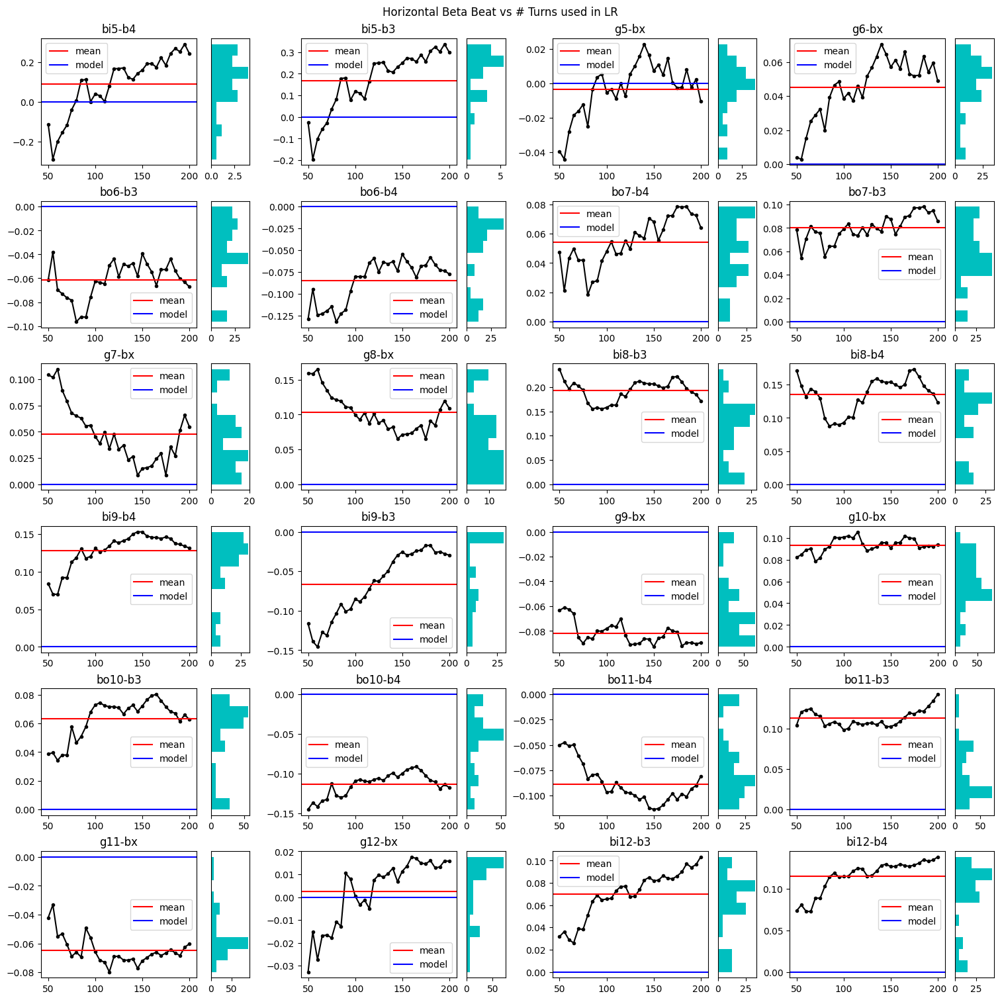

Name 	 Mean 	 	 Stddev
bi5-b4 0.0897188955160524 0.1439653201039338
bi5-b3 0.16752107511534145 0.13543768457563118
g5-bx -0.0034060799181624213 0.015400138256775848
g6-bx 0.04499965083912002 0.01735468933400818
bo6-b3 -0.06133220125958115 0.014938407129639904
bo6-b4 -0.08486240764762819 0.02432082583667373
bo7-b4 0.05429915028452859 0.01651347344728096
bo7-b3 0.08007517222417673 0.010987620353181547
g7-bx 0.04779374593732095 0.027388035836808784
g8-bx 0.10308396156434046 0.027358623022736686
bi8-b3 0.1926151419815526 0.021592281473886477
bi8-b4 0.1353079957970207 0.025377840030668616
bi9-b4 0.12777558873268405 0.02290185677356559
bi9-b3 -0.06669723056394805 0.040664776499820865
g9-bx -0.08193636556390925 0.009014879008135421
g10-bx 0.09330786864483892 0.0063404483326569075
bo10-b3 0.06332465316103575 0.013416302062177504
bo10-b4 -0.11353782464410982 0.014379529626289763
bo11-b4 -0.0884871060133248 0.019137353380886978
bo11-b3 0.11290162276463046 0.010388046344694885
g11-bx -0.064714836

In [22]:
# Beat x
name = "Horizontal Beta Beat vs # Turns used in LR"
Beatx_mean, Beatx_stdv = NonlinearityGraph(Beatx_Matrix, Intervalnumbers, name, np.zeros(24))

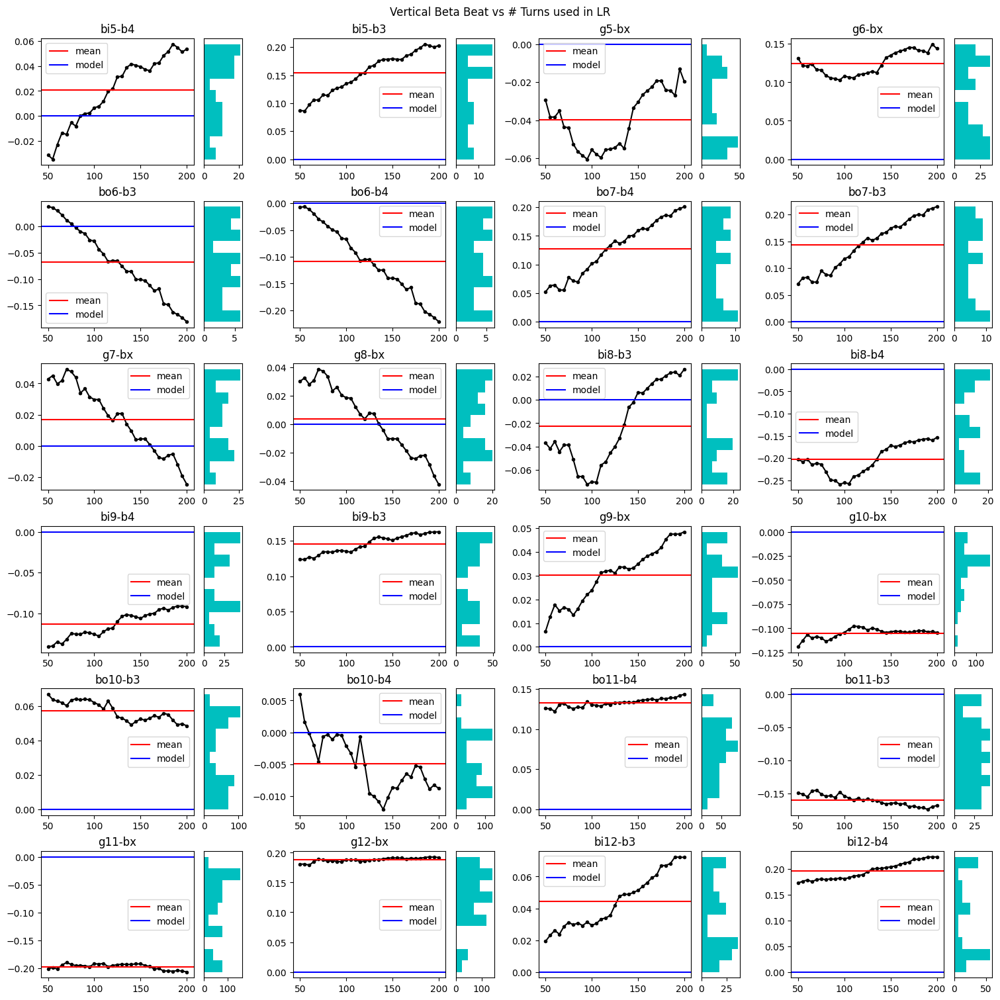

Name 	 Mean 	 	 Stddev
bi5-b4 0.020631972627597975 0.027058561346562905
bi5-b3 0.15439171370184693 0.03689140734272862
g5-bx -0.03972621543177599 0.014916869094726793
g6-bx 0.12416408379421841 0.014986910336258713
bo6-b3 -0.06810498838453828 0.06563692585466827
bo6-b4 -0.10815678939275913 0.06489613531493722
bo7-b4 0.12796485300441404 0.048031119556339714
bo7-b3 0.14375015036820452 0.04656910109803498
g7-bx 0.016876396880301445 0.02121351412542263
g8-bx 0.0035569351751299173 0.023289219538690446
bi8-b3 -0.022731992551591702 0.03348375037858717
bi8-b4 -0.20225220075624134 0.03453759001907995
bi9-b4 -0.1128674641625852 0.01588018598796334
bi9-b3 0.14540315575418475 0.012986254387438083
g9-bx 0.03016745608627356 0.011804126688670683
g10-bx -0.10492642287775399 0.004724166750333003
bo10-b3 0.05725597598347997 0.005637891103402648
bo10-b4 -0.004951102894641929 0.004283751061732482
bo11-b4 0.13274086847413272 0.0050935514730203095
bo11-b3 -0.16005627598458824 0.008005184555550328
g11-bx -0.1

In [23]:
# Beat y
name = "Vertical Beta Beat vs # Turns used in LR"
Beaty_mean, Beaty_stdv = NonlinearityGraph(Beaty_Matrix, Intervalnumbers, name, np.zeros(24))

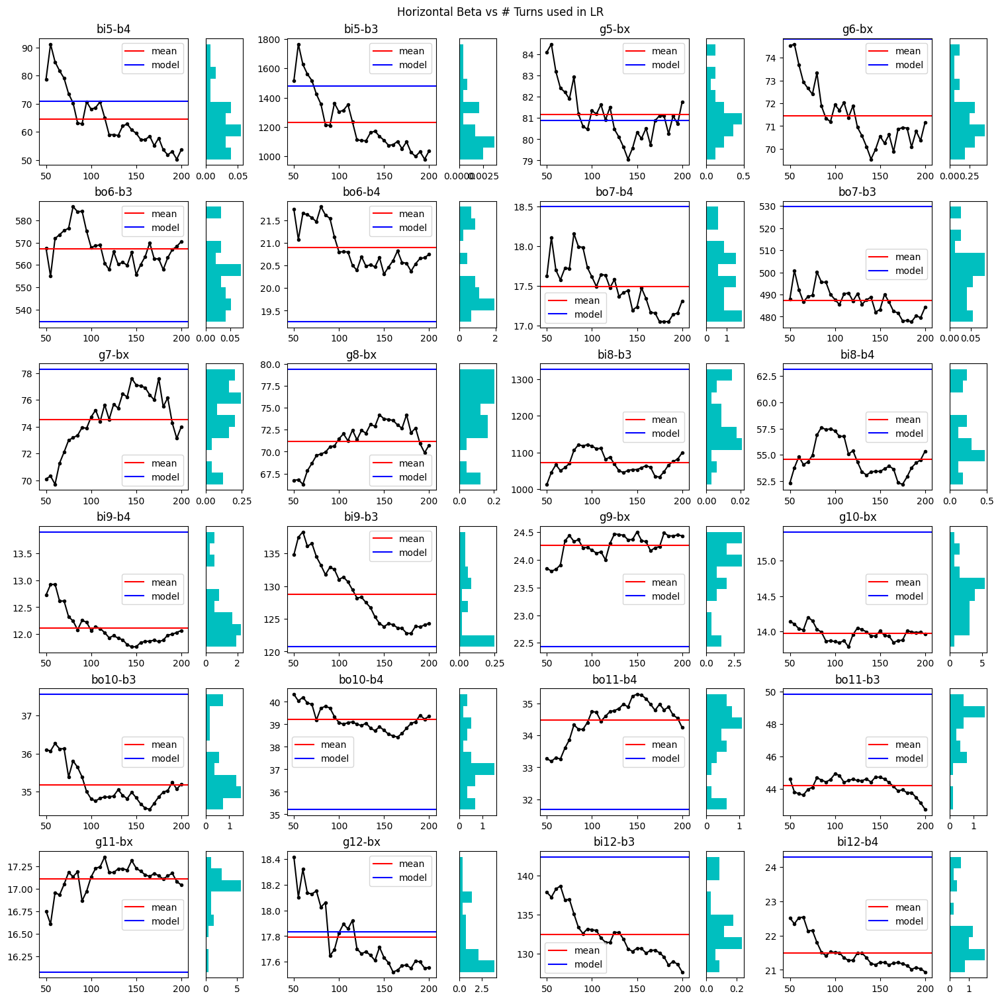

Name 	 Mean 	 	 Stddev
bi5-b4 64.43987564817972 10.191475226114047
bi5-b3 1229.8484460152101 200.0865378427646
g5-bx 81.17369715954716 1.2458427192036108
g6-bx 71.44967863980659 1.2984152067568244
bo6-b3 567.3387455218506 7.98537644572203
bo6-b4 20.890014945284616 0.4683196796462332
bo7-b4 17.491849028691615 0.30543610547251965
bo7-b3 487.288612182779 5.820195424052458
g7-bx 74.54363389241362 2.144077197288592
g8-bx 71.19712527023242 2.171725364581691
bi8-b3 1071.513140933492 28.65599114502531
bi8-b4 54.599614923016595 1.6024437447292028
bi9-b4 12.117687543586758 0.31817218248549006
bi9-b3 128.75703784053 4.9084932598878055
g9-bx 24.26484419824698 0.20217883561427638
g10-bx 13.970987872758945 0.09769835173379893
bo10-b3 35.17530419874714 0.5038271882055911
bo10-b4 39.21632285859284 0.5064150169838265
bo11-b4 34.48827044996086 0.6063592443587689
bo11-b3 44.19795495635077 0.5175642479001966
g11-bx 17.115588761825773 0.15564408121266216
g12-bx 17.789948848927207 0.25179790671234165
bi12-b

In [24]:
# Beta x
name = "Horizontal Beta vs # Turns used in LR"
Betx_mean, Betx_stdv = NonlinearityGraph(Betx_Matrix, Intervalnumbers, name, driftModel(BetxModel))


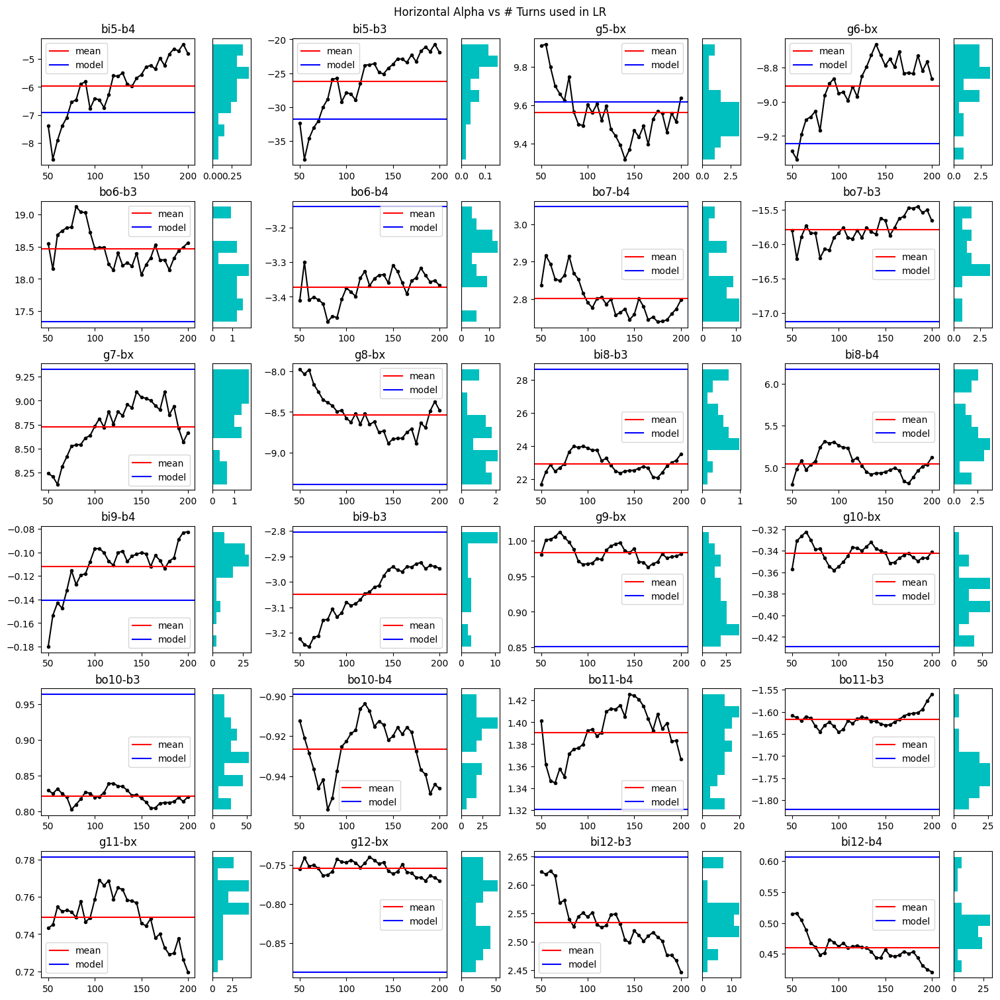

Name 	 Mean 	 	 Stddev
bi5-b4 -5.969519164206469 0.984471346541715
bi5-b3 -26.20500195226627 4.276429488661573
g5-bx 9.561662441718846 0.1394157241738065
g6-bx -8.91070230668329 0.17016206128917247
bo6-b3 18.471084958488596 0.27798298698127294
bo6-b4 -3.3724788310409237 0.04315628728785178
bo7-b4 2.8014720656553105 0.05136283110766968
bo7-b3 -15.787517664137127 0.19554943604049516
g7-bx 8.727119108372587 0.262135736485098
g8-bx -8.535140247173821 0.2513948990412277
bi8-b3 22.91389982142016 0.609013804981628
bi8-b4 5.04282600166011 0.1447593103038191
bi9-b4 -0.11199812215194853 0.020593033146401755
bi9-b3 -3.0502997666410834 0.10652983023087752
g9-bx 0.9831945703991656 0.013407358620092479
g10-bx -0.3426596529747339 0.008659184144771886
bo10-b3 0.8209435957262758 0.009586485455749779
bo10-b4 -0.926717272154519 0.014327698093940792
bo11-b4 1.39027911418475 0.0226319013930845
bo11-b3 -1.6168637787053226 0.01759465545135129
g11-bx 0.748874348736917 0.012611281550913614
g12-bx -0.7545758550

In [25]:
# Alpha x
name = "Horizontal Alpha vs # Turns used in LR"
Alfx_mean, Alfx_stdv = NonlinearityGraph(Alfx_Matrix, Intervalnumbers, name, driftModel(AlfxModel))

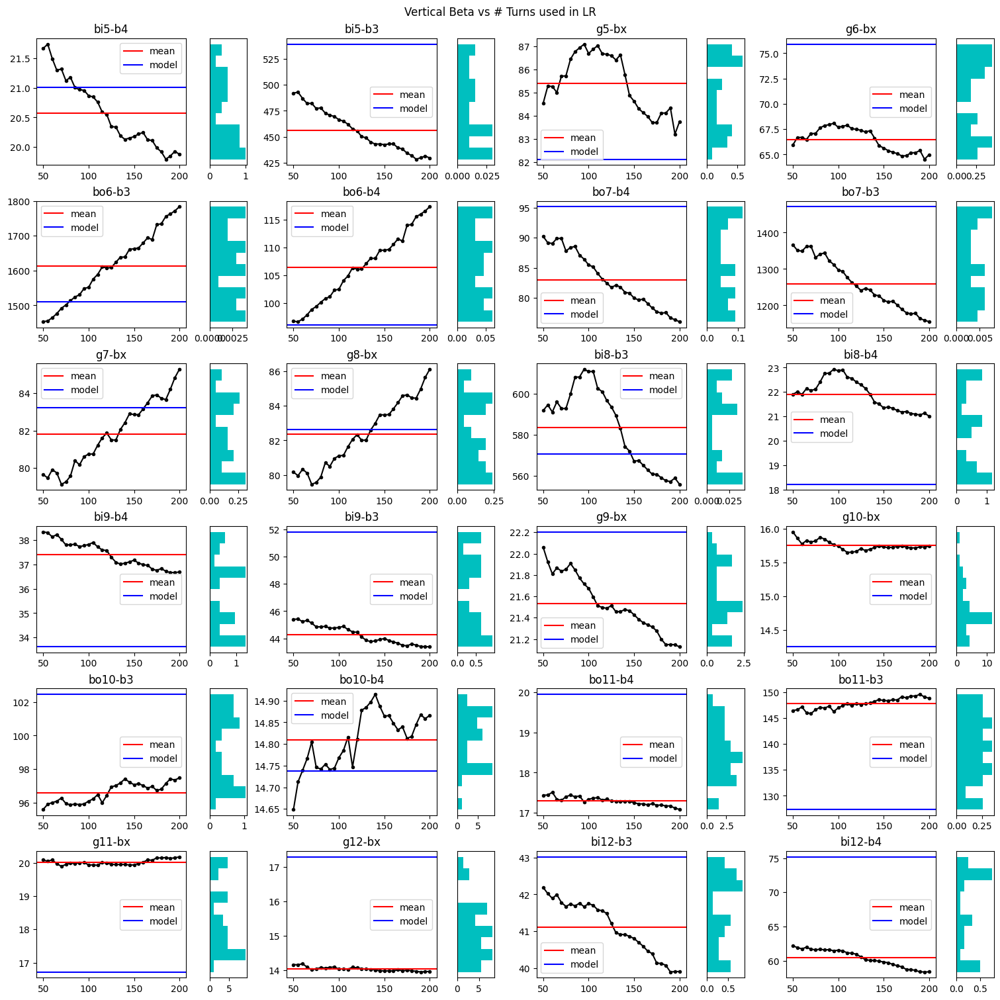

Name 	 Mean 	 	 Stddev
bi5-b4 20.57125773081879 0.5683549224888675
bi5-b3 455.9390263190302 19.891281360329245
g5-bx 85.38148664186072 1.2249613796848355
g6-bx 66.47576390994006 1.137503377994032
bo6-b3 1612.9313219453084 99.11746011720886
bo6-b4 106.41135767437083 6.231686646495474
bo7-b4 82.980549169098 4.570513805232952
bo7-b3 1259.506425789887 68.50112978292069
g7-bx 81.8203997657189 1.7654933730306113
g8-bx 82.34894727234038 1.9246887047607175
bi8-b3 583.6759567757914 19.10926829413498
bi8-b4 21.897361963557827 0.6290544608868579
bi9-b4 37.40740526147996 0.5337891276446141
bi9-b3 44.28505368423771 0.6729453502866468
g9-bx 21.534704009340707 0.2621054283283517
g10-bx 15.749384136587683 0.06733725914754535
bo10-b3 96.59102152730253 0.5776431852808117
bo10-b4 14.809773683738028 0.06312882642647509
bo11-b4 17.29746209574433 0.10159075913363691
bo11-b3 147.771078777804 1.0197218721868313
g11-bx 20.020852492718813 0.08211480654917169
g12-bx 14.038035527910852 0.05986770822335757
bi12-b3

In [26]:
# Beta y
name = "Vertical Beta vs # Turns used in LR"
Bety_mean, Bety_stdv = NonlinearityGraph(Bety_Matrix, Intervalnumbers, name, driftModel(BetyModel))

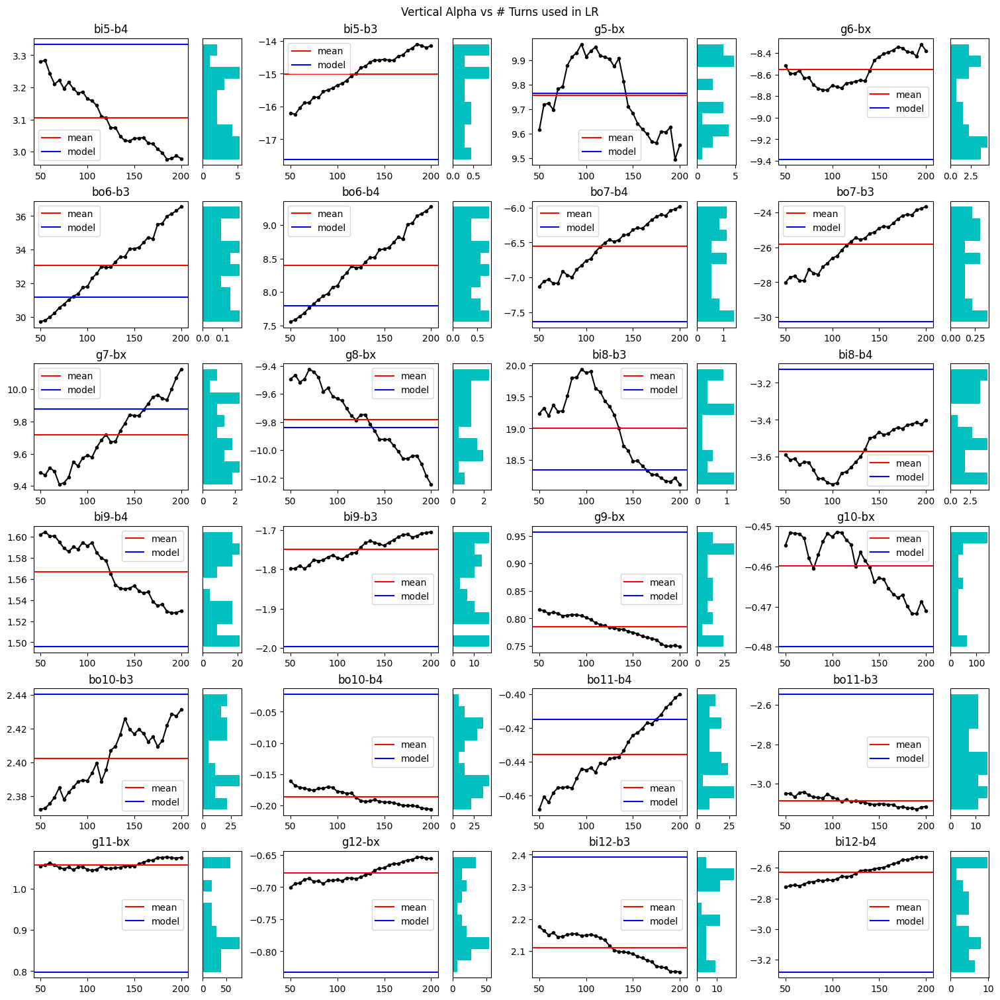

Name 	 Mean 	 	 Stddev
bi5-b4 3.1052106345309625 0.0949096152828048
bi5-b3 -15.007209244094673 0.6571649938450441
g5-bx 9.75593670611802 0.14671489557214787
g6-bx -8.553910652577333 0.14082972871768668
bo6-b3 33.0427294351933 2.043818686453902
bo6-b4 8.39570463264325 0.5118637044550878
bo7-b4 -6.551005827324654 0.3636793776250715
bo7-b3 -25.822872669025813 1.4020102927947347
g7-bx 9.718336697883142 0.2044076804393169
g8-bx -9.782867802334085 0.2380255864074646
bi8-b3 19.0072143226547 0.6101535042368996
bi8-b4 -3.5713150523170873 0.11339002181440483
bi9-b4 1.5666419918956394 0.02605537173912161
bi9-b3 -1.7489744085072048 0.030430800340222268
g9-bx 0.7843292080934475 0.02151700869240619
g10-bx -0.45978366152754996 0.006918521542078195
bo10-b3 2.4020898466712874 0.018301093026237274
bo10-b4 -0.18609771995109795 0.012866219114046474
bo11-b4 -0.4356383160541118 0.019249868340591128
bo11-b3 -3.0874287577758786 0.025735687234553235
g11-bx 1.0592069095905845 0.010327388601802772
g12-bx -0.6774

In [27]:
# Alpha y
name = "Vertical Alpha vs # Turns used in LR"
Alfy_mean, Alfy_stdv = NonlinearityGraph(Alfy_Matrix, Intervalnumbers, name, driftModel(AlfyModel))

The claim is that the actual beta that the beam sees at each bpm is the mean of the beta for all LR. This mean and standard deviation of beta can be used to calculate $\beta^*$ and $s^*$ at the IPs that the beam sees. We can use the orbit display to update where the star locations are. This can also be done for all linear optics and beta beat.

The nonlinearity graph before getting rid of the exponential looked like they had less variation in beta/beat, while getting rid of the exponential shows more variation. This can be explained/ shown by the PS as well; the more turns you use, the lesser the similarity between the model and LR PS. When there is an exponential, the LR and model PS become more similar since they both spiral down to the center quickly. 

Another claim is that the actual beta that the beam sees at each bpm is time dependent due to the beam's behavior. Since the beta function depends on both the beam and the machine, if the beam is changing (due to exposure to nonlinear effects), so is the beta function. Therefore, $\beta^*$ and $s^*$ will also change, and this method can calculate how they all change. The time dependence could be due to a changing emittance from nonlinear effects or collision experiments, or due to magnet changes around the drift spaces.

For most locations, they follow certain symmetric trends to their counterpart (g7/g8, b4/b3). If both are positive (beta), the trends will follow similar directions. If one is positive and the other is negative (alpha), the trends will follow opposing directions. Also, each bpm's beta function follows the same trend as its alpha function


## Star values from average and standard deviation of beta function at IP8

In [28]:
# Determine Betatron function:
def Betatron_function(s1, s2, sIP, b1, b1_m, b2, b2_m, a1, a1_m, b1_err, b2_err, a1_err, Name1, Name2, title, axis):
    print(title + ':')
    print("Experimental Values:")
    display(Math(r"\beta^{%s}_{%s} = %f \pm %f"%(axis, Name1, b1, b1_err)))
    display(Math(r"\alpha^{%s}_{%s} = %f \pm %f"%(axis, Name1, a1, a1_err)))
    display(Math(r"\beta^{%s}_{%s} = %f \pm %f"%(axis, Name2, b2, b2_err)))
     
    s_star = s1 + a1*b1/(a1**2 + 1)
    beta_star = b1/(a1**2 + 1)

    s_star_m = s1 + a1_m*b1_m/(a1_m**2 + 1)
    beta_star_m = b1_m/(a1_m**2 + 1)

    # Guillaume's Method of calculation s*/b*
    # doesn't use alpha so will be different experimentally
    def fit_beta(x, b1, s1):
        if b1 == 0: return b1
        return b1 + ((x-s1)**2)/b1
    tB = [s1 - sIP, s2 - sIP]
    print(tB)
    xB = [b1, b2]
    pB = [beta_star, 0]
    parB, covB = optimize.curve_fit(fit_beta, tB, xB, p0=pB)
    print("LR values curve fit", parB)
    
    s_points = [s1, s_star, s2]
    b_points = [b1, beta_star, b2]

    s_points_m = [s1, s_star_m, s2]
    b_points_m = [b1_m, beta_star_m, b2_m]
    
    dbsdb27 = 1/(a1**2 + 1)
    dbsda27 = -2*a1*b1/(a1**2 + 1)**2
    dssdb27 = a1/(a1**2 + 1)
    dssda27 = -(a1**2 - 1)*b1/(a1**2 + 1)**2
    
    b_star_err_prop = np.sqrt((dbsdb27*b1_err)**2 + (dbsda27*a1_err)**2)
    s_star_err_prop = np.sqrt((dssdb27*b1_err)**2 + (dssda27*a1_err)**2)
    
    display(Math(r"\beta^*_{%s} = %f \pm %f"%(axis, beta_star, b_star_err_prop)))
    display(Math(r"s^*_{%s} = %f \pm %f"%(axis, s_star, s_star_err_prop)))
    display(Math(r"\Delta s^*_{%s} = %f \pm %f"%(axis, s_star - sIP, s_star_err_prop)))
    
    err_xpoints = [0, s_star_err_prop, 0]
    err_ypoints = [b1_err, b_star_err_prop, b2_err]

    print()
    print("Madx Values:")
    display(Math(r"\beta^{%s}_{%s} = %f"%(axis, Name1, b1_m)))
    display(Math(r"\alpha^{%s}_{%s} = %f"%(axis, Name1, a1_m)))
    display(Math(r"\beta^{%s}_{%s} = %f"%(axis, Name2, b2_m)))

    tB = [s1 - sIP, s2 - sIP]
    xB = [b1_m, b2_m]
    pB = [beta_star_m, 0]
    parB, covB = optimize.curve_fit(fit_beta, tB, xB, p0=pB)
    print("MADx curve fit", parB)

    display(Math(r"\beta^*_{%s} = %f"%(axis, beta_star_m)))
    display(Math(r"s^*_{%s} = %f"%(axis, s_star_m)))
    display(Math(r"\Delta s^*_{%s} = %f"%(axis, s_star_m - sIP)))
    
    def calc_parabola_vertex(x1, y1, x2, y2, x3, y3):
        if x1 == 0 or x3 == 0: return 0, 0, 0
        denom = (x1-x2) * (x1-x3) * (x2-x3)
        A     = (x3 * (y2-y1) + x2 * (y1-y3) + x1 * (y3-y2)) / denom
        B     = (x3*x3 * (y1-y2) + x2*x2 * (y3-y1) + x1*x1 * (y2-y3)) / denom
        C     = (x2 * x3 * (x2-x3) * y1+x3 * x1 * (x3-x1) * y2+x1 * x2 * (x1-x2) * y3) / denom
        return A,B,C
    A, B, C = calc_parabola_vertex(s1, b1, s_star, beta_star, s2, b2)
    A_shift, B_shift, C_shift = calc_parabola_vertex(s1 - s_star, b1, 0, beta_star, s2 - s_star, b2)
    A_m, B_m, C_m = calc_parabola_vertex(s1, b1_m, s_star_m, beta_star_m, s2, b2_m)
    A_m_shift, B_m_shift, C_m_shift = calc_parabola_vertex(s1 - s_star_m, b1_m, 0, beta_star_m, s2 - s_star_m, b2_m)
    
    print("Experimental Betatron Function:")
    display(Math(r"%fx^2 + %dx + %f"%(A_shift, B_shift, C_shift)))

    print("MADx Betatron Function:")
    display(Math(r"%fx^2 + %dx + %f"%(A_m_shift, B_m_shift, C_m_shift)))
    print()
    print()

    s_space = np.linspace(s1, s2, 1000)
    Betatron = A*s_space**2 + B*s_space + C
    Betatron_m = A_m*s_space**2 + B_m*s_space + C_m
    
    return s_points, b_points, err_xpoints, err_ypoints, s_points_m, b_points_m, Betatron, Betatron_m


In [29]:
def IP_calculation(Betx_mean, Betx_stdv, Alfx_mean, Alfx_stdv,
                   Bety_mean, Bety_stdv, Alfy_mean, Alfy_stdv):
    Datax = []
    Datay = []
    def onlyIP(M):
        res = np.zeros(8)
        res[::2] = M[2::6]
        res[1::2] = M[3::6]
        return res
        
    Betx_IP_mean = onlyIP(Betx_mean)
    Betx_IP_stdv = onlyIP(Betx_stdv)
    Alfx_IP_mean = onlyIP(Alfx_mean)
    Alfx_IP_stdv = onlyIP(Alfx_stdv)
    
    Bety_IP_mean = onlyIP(Bety_mean)
    Bety_IP_stdv = onlyIP(Bety_stdv)
    Alfy_IP_mean = onlyIP(Alfy_mean)
    Alfy_IP_stdv = onlyIP(Alfy_stdv)
    
    xIPs = Drift_bpmx[1::3]
    yIPs = Drift_bpmy[1::3]
    sIPs = [0, 639.445027949618, 1277.94839381844, 1917.39342276804]
    print(Betx_IP_mean)
    
    # Determine Betatron function:
    nrow = 2
    ncol = 4
    fig, Ax = plt.subplots(nrow, ncol, figsize=(15, 8), layout='constrained', dpi = 75)
    for i in range(ncol):
        sIP = sIPs[i]
        C = 3833.845181
        
        xtitle = "Horizontal Betatron function at IP%s"%(6 + i*2)
        x1, x2 = xIPs[i]
        if i == 0: sx1 = S_xbpms[0][x1] - C
        else: sx1 = S_xbpms[0][x1]
        sx2 = S_xbpms[0][x2]
        bx1, bx2 = Betx_IP_mean[i*2: i*2 + 2]
        bx1_m = BetxBPMModel[x1]
        bx2_m = BetxBPMModel[x2]
        ax1 = Alfx_IP_mean[i*2]
        ax1_m = AlfxBPMModel[x1]
        bx1_err, bx2_err = Betx_IP_stdv[i*2: i*2 + 2]
        ax1_err = Alfx_IP_stdv[i*2]
        Namex1 = Name_xbpms[x1]
        Namex2 = Name_xbpms[x2]
        sx_points, bx_points, errx_xpoints, errx_ypoints, sx_points_m, bx_points_m, Betatronx, Betatronx_m = Betatron_function(sx1, sx2, sIP, bx1, bx1_m, bx2, bx2_m, ax1, ax1_m, bx1_err, bx2_err, ax1_err, Namex1, Namex2, xtitle, 'x')
        Datax.append([sx_points, errx_xpoints, bx_points, errx_ypoints])
        ytitle = "Vertical Betatron function at IP%s"%(6 + i*2)
        y1, y2 = yIPs[i]
        if i == 0: sy1 = S_ybpms[0][y1] - C
        else: sy1 = S_ybpms[0][y1]
        sy2 = S_ybpms[0][y2]
        by1, by2 = Bety_IP_mean[i*2: i*2 + 2]
        by1_m = BetyBPMModel[y1]
        by2_m = BetyBPMModel[y2]
        ay1 = Alfy_IP_mean[i*2]
        ay1_m = AlfyBPMModel[y1]
        by1_err, by2_err = Bety_IP_stdv[i*2: i*2 + 2]
        ay1_err = Alfy_IP_stdv[i*2]
        Namey1 = Name_ybpms[y1]
        Namey2 = Name_ybpms[y2]
        sy_points, by_points, erry_xpoints, erry_ypoints, sy_points_m, by_points_m, Betatrony, Betatrony_m = Betatron_function(sy1, sy2, sIP, by1, by1_m, by2, by2_m, ay1, ay1_m, by1_err, by2_err, ay1_err, Namey1, Namey2, ytitle, 'y')
        Datay.append([sy_points, erry_xpoints, by_points, erry_ypoints])
        s_space = np.linspace(sx1, sx2, 1000)
        Ax[0][i].plot(sx_points, bx_points, 'o')
        Ax[0][i].plot(sx_points_m, bx_points_m, 'ok')
        for x, y, text in zip(sx_points, bx_points, [Namex1, r"$\beta^*$", Namex2]):
            Ax[0][i].annotate(text, # this is the text
                         (x,y), # these are the coordinates to position the label
                         textcoords="offset points", # how to position the text
                         xytext=(0,10), # distance from text to points (x,y)
                         ha='center') # horizontal alignment can be left, right or center
        
        Ax[0][i].plot(s_space, Betatronx_m, 'k', label = "MADx")
        Ax[0][i].plot(s_space, Betatronx, label = "Experiment")
        Ax[0][i].errorbar(sx_points, bx_points, xerr = errx_xpoints, yerr = errx_ypoints, fmt = 'x', ecolor = 'r', capsize = 2)
        Ax[0][i].set_title(xtitle)
        Ax[0][i].set_xlabel("s")
        Ax[0][i].set_ylabel(r"$\beta$(s)")
        Ax[0][i].legend()
        
        Ax[1][i].plot(sy_points, by_points, 'o')
        Ax[1][i].plot(sy_points_m, by_points_m, 'ok')
        for x, y, text in zip(sy_points, by_points, [Namey1, r"$\beta^*$", Namey2]):
            Ax[1][i].annotate(text, # this is the text
                         (x,y), # these are the coordinates to position the label
                         textcoords="offset points", # how to position the text
                         xytext=(0,10), # distance from text to points (x,y)
                         ha='center') # horizontal alignment can be left, right or center
        
        Ax[1][i].plot(s_space, Betatrony_m, 'k', label = "MADx")
        Ax[1][i].plot(s_space, Betatrony, label = "Experiment")
        Ax[1][i].errorbar(sy_points, by_points, xerr = erry_xpoints, yerr = erry_ypoints, fmt = 'x', ecolor = 'r', capsize = 2)
        Ax[1][i].set_title(ytitle)
        Ax[1][i].set_xlabel("s")
        Ax[1][i].set_ylabel(r"$\beta$(s)")
        Ax[1][i].legend()
    
    plt.show()
    return Datax, Datay

[81.17369716 71.44967864 74.54363389 71.19712527 24.2648442  13.97098787
 17.11558876 17.78994885]
Horizontal Betatron function at IP6:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.32638100000031, 7.99309015]
LR values curve fit [0.88363127 0.09661209]


/Users/GrandmasterFung/env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 0.86511765 -0.00544415]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP6:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.32638100000031, 7.99309015]
LR values curve fit [0.89085209 0.34937015]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 0.85222597 -0.00425222]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Horizontal Betatron function at IP8:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326314949617995, 8.326334050382002]
LR values curve fit [0.9642723  0.09689941]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 0.88947654 -0.02922758]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP8:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326314949617995, 8.326334050382002]
LR values curve fit [ 0.85346338 -0.01353472]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [0.84454163 0.01476852]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Horizontal Betatron function at IP10:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326323818440187, 8.326386181559883]
LR values curve fit [12.31018613  3.80479591]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [13.01221991  2.74211256]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP10:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326323818440187, 8.326386181559883]
LR values curve fit [12.86494034  2.23473637]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [11.58435535  2.76548459]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Horizontal Betatron function at IP12:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326402768039998, 8.326427231959997]
LR values curve fit [11.32792057 -0.22935111]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 9.98043243 -0.52709441]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP12:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326402768039998, 8.326427231959997]
LR values curve fit [9.18486862 1.64992362]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [10.21493908 -0.17435963]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>

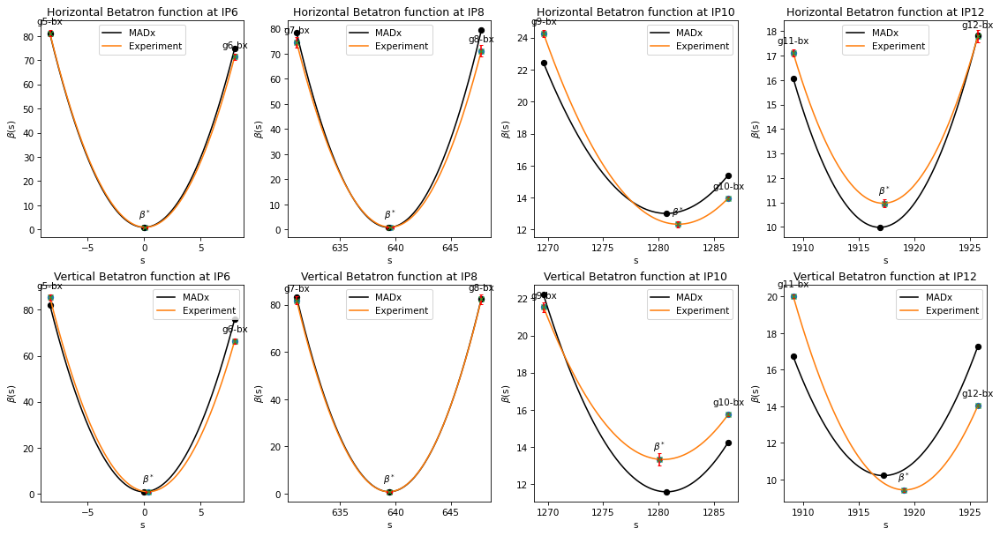

In [30]:
Datax, Datay = IP_calculation(Betx_mean, Betx_stdv, Alfx_mean, Alfx_stdv,
                              Bety_mean, Bety_stdv, Alfy_mean, Alfy_stdv)

# Vary Initial turn used in LR
keep # turns at 100, start at 25/525 turns

In [31]:
InitialTurns = np.array([3*i for i in range(len(Intervalnumbers))], dtype = int)
InitialTurns

array([ 0,  3,  6,  9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48,
       51, 54, 57, 60, 63, 66, 69, 72, 75, 78, 81, 84, 87, 90])

In [32]:
BPMNames = []
Beatx_Matrix2 = np.zeros([24, len(InitialTurns)])
Beaty_Matrix2 = np.zeros([24, len(InitialTurns)])

Betx_Matrix2 = np.zeros([24, len(InitialTurns)])
Bety_Matrix2 = np.zeros([24, len(InitialTurns)])

Alfx_Matrix2 = np.zeros([24, len(InitialTurns)])
Alfy_Matrix2 = np.zeros([24, len(InitialTurns)])

for i, initialTurns in enumerate(InitialTurns):
    interval = 100
    initial_x0 = 25
    initial_y0 = 525
    print(initial_x0 + initialTurns, "to", initial_x0 + initialTurns + interval, "|", 
          initial_y0 + initialTurns, "to", initial_y0 + initialTurns + interval)
    Intervalsx = (initial_x0 + initialTurns, interval)
    Intervalsy = (initial_y0 + initialTurns, interval)
    unexp = True
    for j in range(len(Drift_bpmx)):
        Bpmsx = Drift_bpmx[j]
        Bpmsy = Drift_bpmy[j]
        Data1x, Data2x = LR_calculation(Intervalsx, Bpmsx, True, BPMx, S_xbpms, Name_xbpms, BetxBPMModel, AlfxBPMModel, unexp)
        Data1y, Data2y = LR_calculation(Intervalsy, Bpmsy, False, BPMy, S_ybpms, Name_ybpms, BetyBPMModel, AlfyBPMModel, unexp)
        bpmy1, bpmy2 = Bpmsy
        # Data1y = [Name_ybpms[bpmy1], bpmy1, 0, 0, 0, 0, BetyBPMModel[bpmy1], 1]
        # Data2y = [Name_ybpms[bpmy2], bpmy2, 0, 0, 0, 0, BetyBPMModel[bpmy2], 1]
        if i == 0: 
            BPMNames.append(Data1x[0])
            BPMNames.append(Data2x[0])

        Beatx_Matrix2[2*j][i] = Data1x[-1] 
        Beatx_Matrix2[2*j + 1][i] = Data2x[-1]
        Beaty_Matrix2[2*j][i] = Data1y[-1]
        Beaty_Matrix2[2*j + 1][i] = Data2y[-1]
        
        Betx_Matrix2[2*j][i] = Data1x[-3]
        Betx_Matrix2[2*j + 1][i] = Data2x[-3]
        Bety_Matrix2[2*j][i] = Data1y[-3]
        Bety_Matrix2[2*j + 1][i] = Data2y[-3]
        
        Alfx_Matrix2[2*j][i] = Data1x[-4]
        Alfx_Matrix2[2*j + 1][i] = Data2x[-4]
        Alfy_Matrix2[2*j][i] = Data1y[-4]
        Alfy_Matrix2[2*j + 1][i] = Data2y[-4]


25 to 125 | 525 to 625
28 to 128 | 528 to 628
31 to 131 | 531 to 631
34 to 134 | 534 to 634
37 to 137 | 537 to 637
40 to 140 | 540 to 640
43 to 143 | 543 to 643
46 to 146 | 546 to 646
49 to 149 | 549 to 649
52 to 152 | 552 to 652
55 to 155 | 555 to 655
58 to 158 | 558 to 658
61 to 161 | 561 to 661
64 to 164 | 564 to 664
67 to 167 | 567 to 667
70 to 170 | 570 to 670
73 to 173 | 573 to 673
76 to 176 | 576 to 676
79 to 179 | 579 to 679
82 to 182 | 582 to 682
85 to 185 | 585 to 685
88 to 188 | 588 to 688
91 to 191 | 591 to 691
94 to 194 | 594 to 694
97 to 197 | 597 to 697
100 to 200 | 600 to 700
103 to 203 | 603 to 703
106 to 206 | 606 to 706
109 to 209 | 609 to 709
112 to 212 | 612 to 712
115 to 215 | 615 to 715


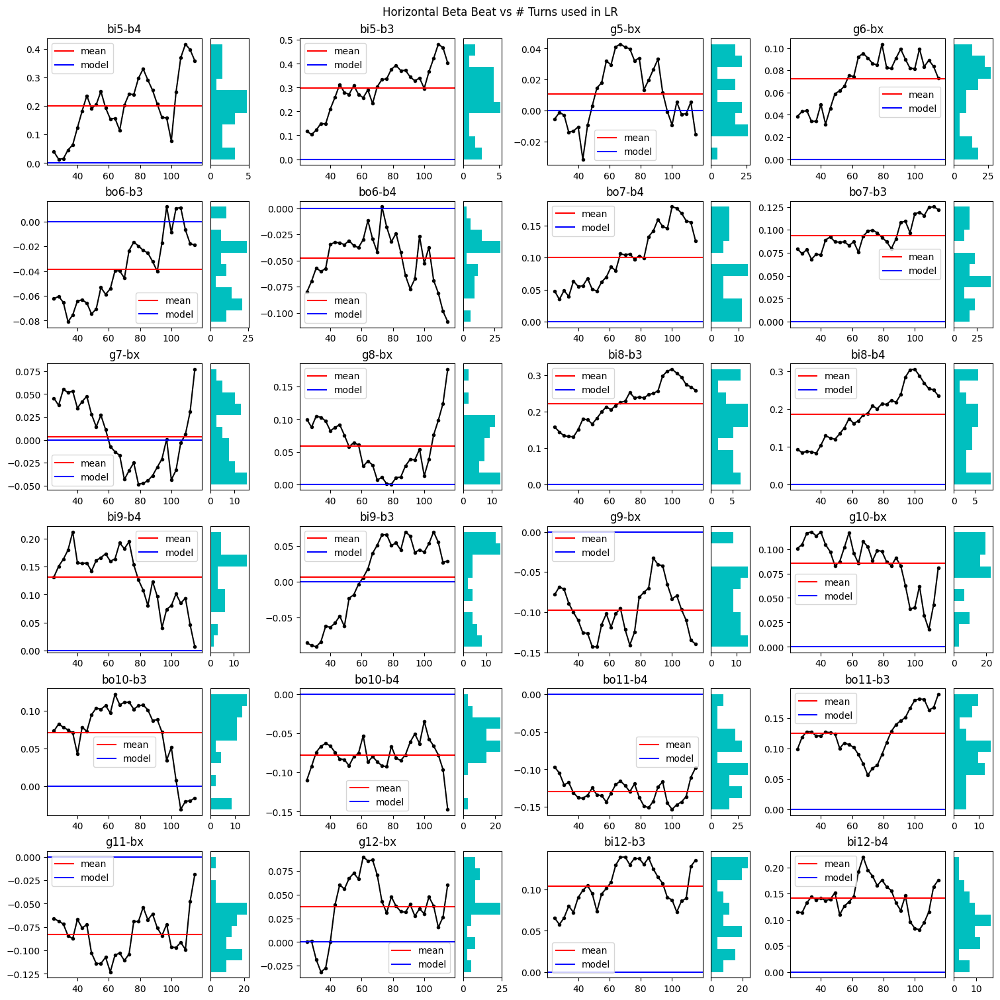

Name 	 Mean 	 	 Stddev
bi5-b4 0.20088621439943305 0.10746387904650198
bi5-b3 0.29933580636632323 0.0968907985900887
g5-bx 0.010469075512120618 0.02011459942613254
g6-bx 0.07239927821744858 0.02167990946664679
bo6-b3 -0.03840053587362428 0.026811963328244516
bo6-b4 -0.047492879970782255 0.024948670417244707
bo7-b4 0.10054830816248582 0.044980957419171956
bo7-b3 0.09382728910808483 0.01627613306250448
g7-bx 0.0035837256400865674 0.036930401165346786
g8-bx 0.05920508432898385 0.04152611708964242
bi8-b3 0.22271763424724975 0.05545752530392607
bi8-b4 0.18574140195704114 0.0686171985880543
bi9-b4 0.1306653818997982 0.04890865121920098
bi9-b3 0.006691560742773168 0.05528529587655495
g9-bx -0.09766375326047261 0.030465824831304424
g10-bx 0.08567504455378991 0.026608254810836368
bo10-b3 0.07072719152773342 0.04307856150511686
bo10-b4 -0.07770168611229931 0.01981466044821306
bo11-b4 -0.12942179545633492 0.014775451880677621
bo11-b3 0.12435017696425779 0.03496072451136633
g11-bx -0.08319516648407

In [33]:
# Beat x
name = "Horizontal Beta Beat vs # Turns used in LR"
Beatx_mean2, Beatx_stdv2 = NonlinearityGraph(Beatx_Matrix2, initial_x0 + InitialTurns, name, np.zeros(24))

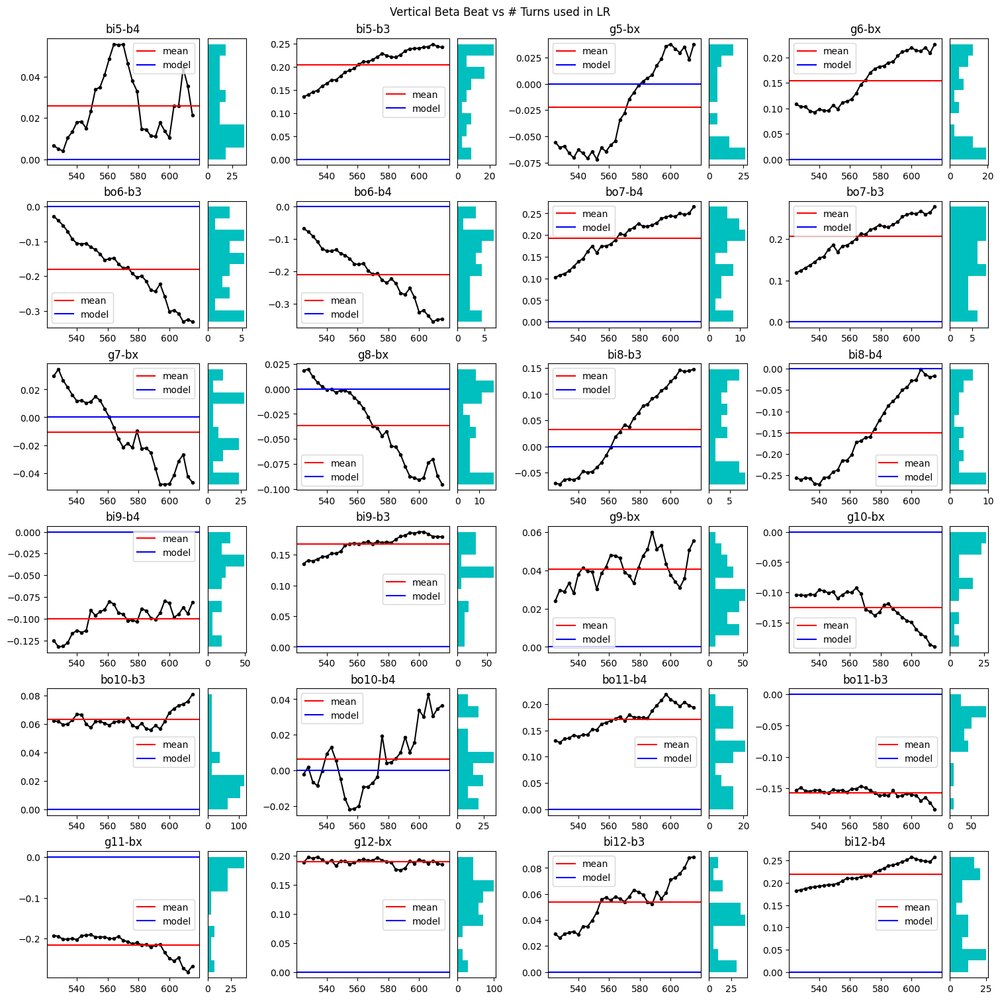

Name 	 Mean 	 	 Stddev
bi5-b4 0.02586443442947373 0.015746303552502526
bi5-b3 0.2043621822159231 0.034772397805936675
g5-bx -0.022099408339116434 0.041193826850890514
g6-bx 0.15446821334934532 0.048614019647002814
bo6-b3 -0.18141786143340424 0.08733872943211388
bo6-b4 -0.21036696330967194 0.08374149738443734
bo7-b4 0.19321268911172296 0.04786931665800973
bo7-b3 0.2062495591318394 0.04723994290254648
g7-bx -0.010588174421629544 0.025402148492105665
g8-bx -0.0363365353015702 0.037640798619924205
bi8-b3 0.032701374940960676 0.07724745884465481
bi8-b4 -0.14994231515592152 0.09371218745824299
bi9-b4 -0.09991097766835917 0.015025116449385624
bi9-b3 0.1670886887858296 0.015234614630151784
g9-bx 0.04048898074227064 0.008772339315748915
g10-bx -0.12472357244772057 0.02764813541013762
bo10-b3 0.06327290203981037 0.0060100771149264026
bo10-b4 0.006349125983402794 0.017609228962201587
bo11-b4 0.1706253469147974 0.025887453732714765
bo11-b3 -0.15797933489076527 0.007568567154518529
g11-bx -0.215041

In [34]:
# Beat y
name = "Vertical Beta Beat vs # Turns used in LR"
Beaty_mean2, Beaty_stdv2 = NonlinearityGraph(Beaty_Matrix2, initial_y0 + InitialTurns, name, np.zeros(24))

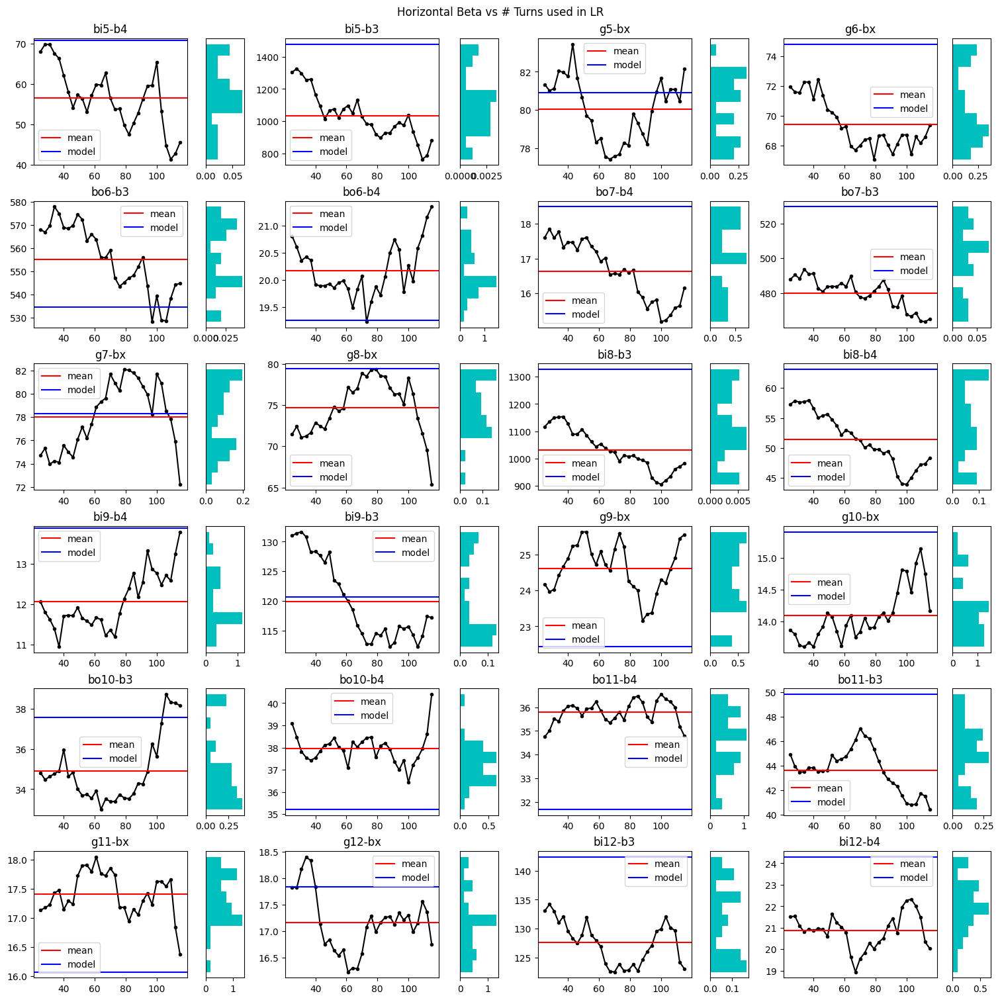

Name 	 Mean 	 	 Stddev
bi5-b4 56.5702097068574 7.607495056544627
bi5-b3 1035.114216060508 143.13995768205575
g5-bx 80.0512227322133 1.6272339135473972
g6-bx 69.39973743009692 1.6220125633389322
bo6-b3 555.0805456317925 14.332426380327718
bo6-b4 20.17043061259466 0.48040939957660034
bo7-b4 16.63641648091633 0.8319756893301753
bo7-b3 480.0040496309267 8.621546078831132
g7-bx 78.00462309864108 2.8911029435313536
g8-bx 74.68022712744929 3.296339940106555
bi8-b3 1031.5629044171585 73.599927638785
bi8-b4 51.41507691155279 4.33272494922304
bi9-b4 12.07754006524021 0.6794808147956143
bi9-b3 119.89855100040329 6.673281535979143
g9-bx 24.617566062719693 0.6832642994834423
g10-bx 14.088600113036764 0.4099998140734485
bo10-b3 34.89731402875897 1.617744622510534
bo10-b4 37.954253849740006 0.6978282230501364
bo11-b4 35.78526940612342 0.4681541725814017
bo11-b3 43.62755296282282 1.7418502466550885
g11-bx 17.412665227591752 0.36377411527726966
g12-bx 17.164122911902705 0.5590945825401265
bi12-b3 127.5

In [35]:
# Beta x
name = "Horizontal Beta vs # Turns used in LR"
Betx_mean2, Betx_stdv2 = NonlinearityGraph(Betx_Matrix2, initial_x0 + InitialTurns, name, driftModel(BetxModel))

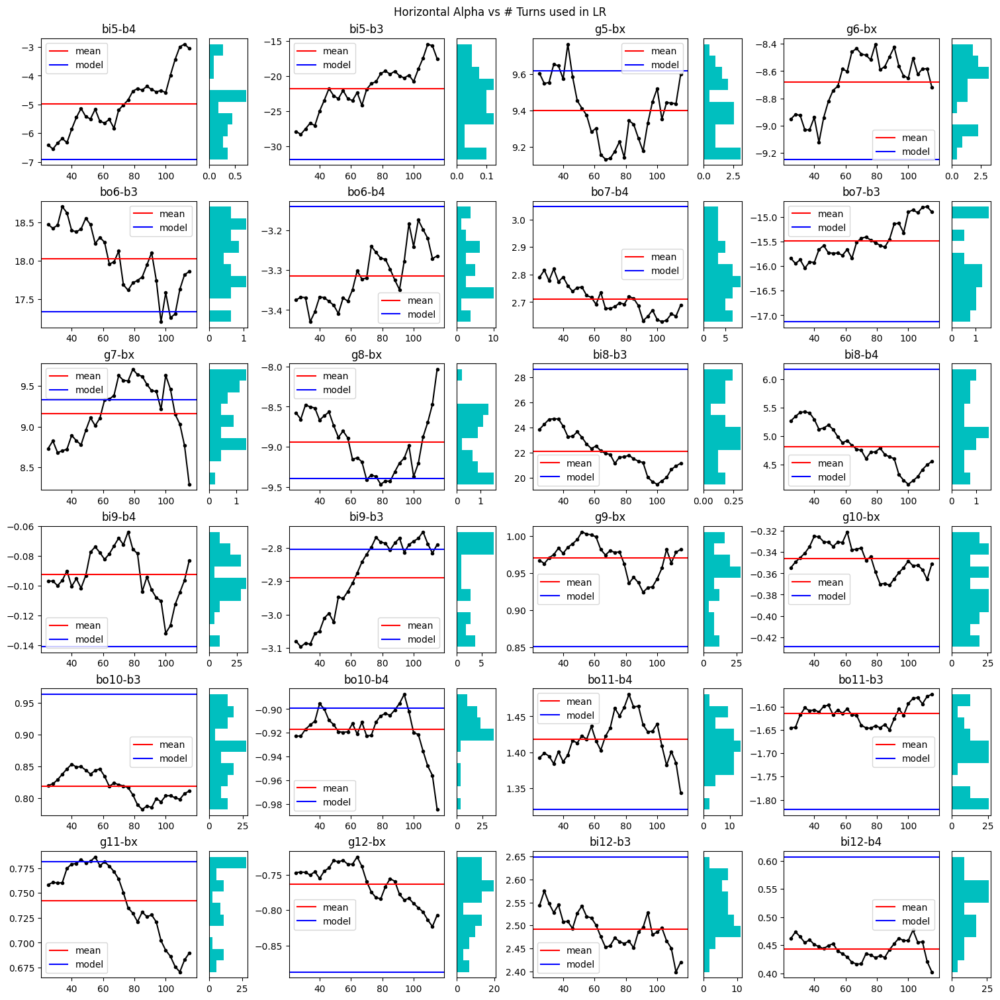

Name 	 Mean 	 	 Stddev
bi5-b4 -4.978297118986581 0.9880277334352707
bi5-b3 -21.819284998680114 3.348958638670953
g5-bx 9.398676389497293 0.173457348639904
g6-bx -8.678211122693043 0.20402424654416154
bo6-b3 18.024409160778557 0.4123652229647138
bo6-b4 -3.3139852217711083 0.06926901785807348
bo7-b4 2.7107259434533435 0.05497159466654942
bo7-b3 -15.485050820357399 0.372366973384301
g7-bx 9.161976455770983 0.3689539822062803
g8-bx -8.938924354909847 0.37012031610947543
bi8-b3 22.102190852727194 1.5391016858412456
bi8-b4 4.815593012536172 0.37838911306330364
bi9-b4 -0.09240109343343007 0.016253131679338974
bi9-b3 -2.8890019524575434 0.11839327109669834
g9-bx 0.9704617942926189 0.022403070168189917
g10-bx -0.34621059841487767 0.014141608914898164
bo10-b3 0.8185288686069155 0.02111447055562709
bo10-b4 -0.916977244660312 0.018653376323017497
bo11-b4 1.4185178915260488 0.02999913907071752
bo11-b3 -1.6154330107483943 0.02211396636571592
g11-bx 0.7424939771491871 0.036718484597368026
g12-bx -0.7

In [36]:
# Alpha x
name = "Horizontal Alpha vs # Turns used in LR"
Alfx_mean2, Alfx_stdv2 = NonlinearityGraph(Alfx_Matrix2, initial_x0 + InitialTurns, name, driftModel(AlfxModel))

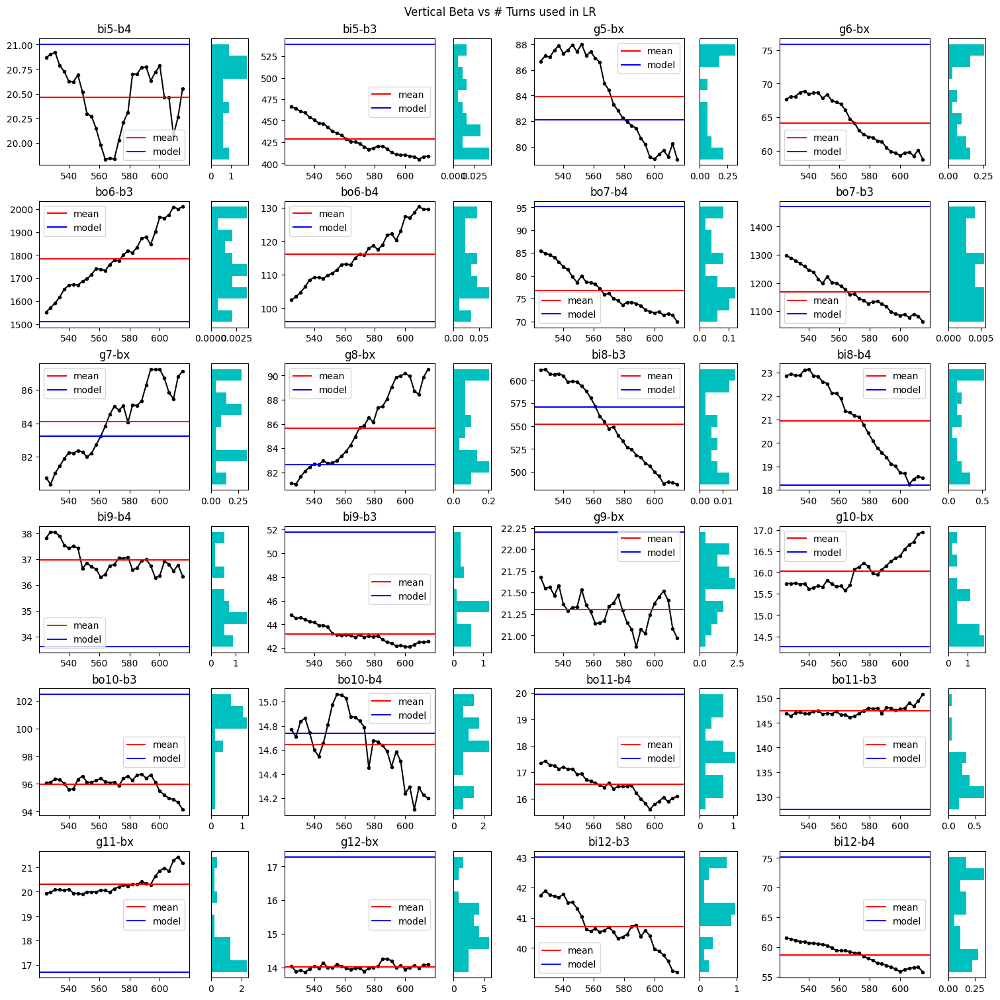

Name 	 Mean 	 	 Stddev
bi5-b4 20.46135183509352 0.3307451944855728
bi5-b3 428.9957156535757 18.74874389869301
g5-bx 83.93398731753567 3.38280416978408
g6-bx 64.17568677844966 3.689793981922128
bo6-b3 1784.0436040783165 131.8890688199339
bo6-b4 116.2261451473531 8.041322776396806
bo7-b4 76.77173833052846 4.555117071045308
bo7-b3 1167.5725037229602 69.48790900844001
g7-bx 84.10613697738515 2.1140922036017735
g8-bx 85.64585947210952 3.1107448586495057
bi8-b3 552.0399817166779 44.085336899615974
bi8-b4 20.94460970530287 1.7068379561951725
bi9-b4 36.97189199807522 0.5050472210058103
bi9-b3 43.16131329022163 0.7894549708410638
g9-bx 21.30551910542416 0.19478592651863014
g10-bx 16.03156845848563 0.39409058939920527
bo10-b3 95.97454343841571 0.6157763647393133
bo10-b4 14.643244355319723 0.2595038653364924
bo11-b4 16.541857102930376 0.5163246294208814
bo11-b3 147.50651245257836 0.9641043769848251
g11-bx 20.31632766458208 0.42461109053227436
g12-bx 14.01415219674761 0.09455691387874211
bi12-b3 4

In [37]:
# Beta y
name = "Vertical Beta vs # Turns used in LR"
Bety_mean2, Bety_stdv2 = NonlinearityGraph(Bety_Matrix2, initial_y0 + InitialTurns, name, driftModel(BetyModel))

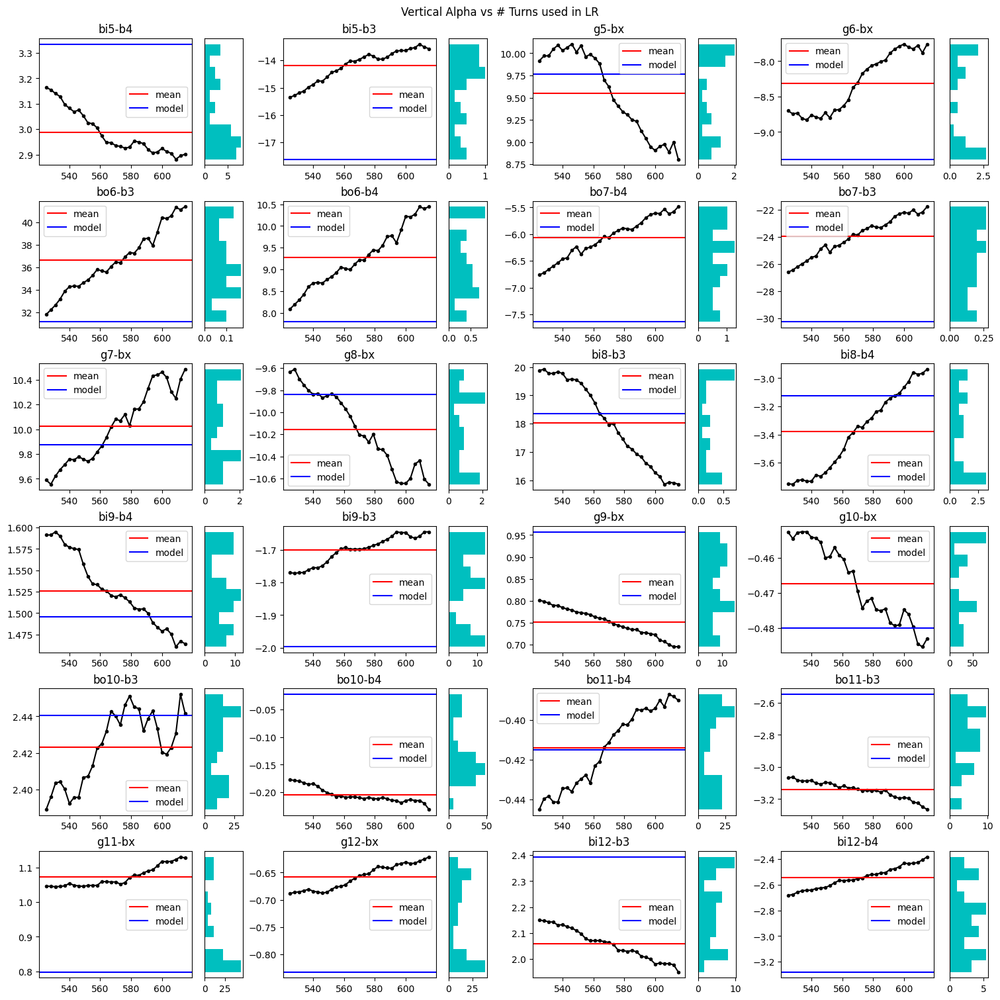

Name 	 Mean 	 	 Stddev
bi5-b4 2.9873369442477316 0.08554675418914474
bi5-b3 -14.18313308018468 0.5812338337635191
g5-bx 9.550313177947052 0.4580254233802228
g6-bx -8.31023194582818 0.4101688074456857
bo6-b3 36.63186550856444 2.732931620274957
bo6-b4 9.27928917533005 0.6810206991541653
bo7-b4 -6.066048904667477 0.37510014416454834
bo7-b3 -23.959015781601316 1.4276173759569568
g7-bx 10.023354580277552 0.2924390266981896
g8-bx -10.153619454896075 0.3377670771806799
bi8-b3 18.025202045171945 1.4514931374078044
bi8-b4 -3.3797960539721807 0.2800458294007321
bi9-b4 1.5259160881343001 0.04125293319792397
bi9-b3 -1.7002880036150008 0.04299319901030384
g9-bx 0.7515694839310458 0.03124934181711863
g10-bx -0.46726023257628263 0.01097356951182148
bo10-b3 2.423276629864038 0.01928810051394875
bo10-b4 -0.2051640634704348 0.013618139130615062
bo11-b4 -0.41415712737993676 0.019372645155077774
bo11-b3 -3.1425121741250885 0.05204293850748125
g11-bx 1.0731122256604753 0.02909187573330172
g12-bx -0.6583274

In [38]:
# Alpha y
name = "Vertical Alpha vs # Turns used in LR"
Alfy_mean2, Alfy_stdv2 = NonlinearityGraph(Alfy_Matrix2, initial_y0 + InitialTurns, name, driftModel(AlfyModel))

[80.05122273 69.39973743 78.0046231  74.68022713 24.61756606 14.08860011
 17.41266523 17.16412291]
Horizontal Betatron function at IP6:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.32638100000031, 7.99309015]
LR values curve fit [0.90308836 0.128071  ]


/Users/GrandmasterFung/env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 0.86511765 -0.00544415]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP6:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.32638100000031, 7.99309015]
LR values curve fit [0.91451287 0.38696382]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 0.85222597 -0.00425222]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Horizontal Betatron function at IP8:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326314949617995, 8.326334050382002]
LR values curve fit [0.91929491 0.09176973]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 0.88947654 -0.02922758]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP8:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326314949617995, 8.326334050382002]
LR values curve fit [ 0.82484452 -0.03812347]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [0.84454163 0.01476852]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Horizontal Betatron function at IP10:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326323818440187, 8.326386181559883]
LR values curve fit [12.58731985  3.97930729]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [13.01221991  2.74211256]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP10:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326323818440187, 8.326386181559883]
LR values curve fit [13.01565025  2.06107401]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [11.58435535  2.76548459]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Horizontal Betatron function at IP12:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326402768039998, 8.326427231959997]
LR values curve fit [10.96502881  0.08183837]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [ 9.98043243 -0.52709441]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>



Vertical Betatron function at IP12:
Experimental Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

[-8.326402768039998, 8.326427231959997]
LR values curve fit [9.59901461 1.8163604 ]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Madx Values:


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

MADx curve fit [10.21493908 -0.17435963]


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Experimental Betatron Function:


<IPython.core.display.Math object>

MADx Betatron Function:


<IPython.core.display.Math object>

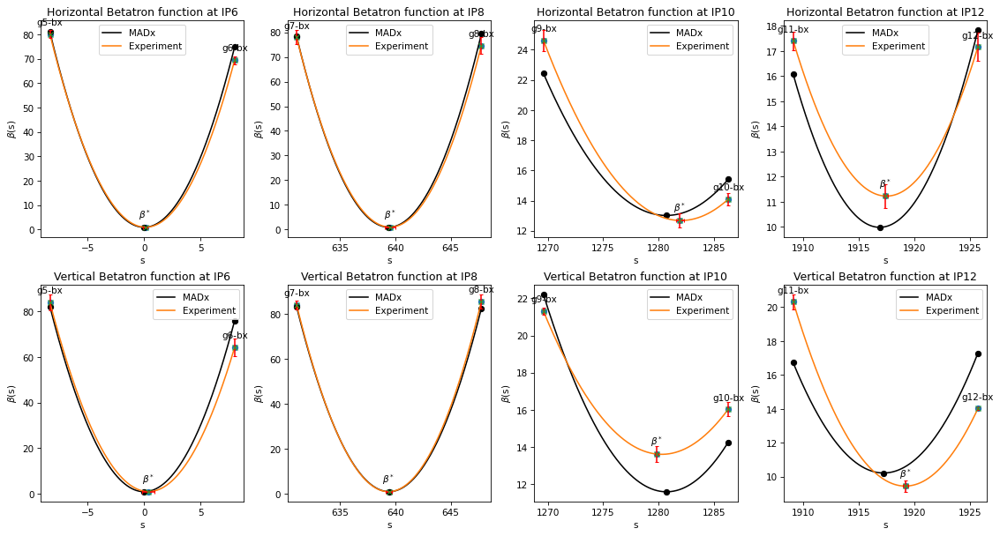

In [39]:
Datax2, Datay2 = IP_calculation(Betx_mean2, Betx_stdv2, Alfx_mean2, Alfx_stdv2,
                                Bety_mean2, Bety_stdv2, Alfy_mean2, Alfy_stdv2)

# Gather Optics from Different Datasets

In [42]:
# Store Data
Datum = Datax, Datay, Datax2, Datay2
File_names = ["interval_x", "interval_y", "initial_x", "initial_y"]
for i in range(len(Datum)):
    file = "IP_results/APEX_7-10-24/" + sdds_file + "_results_vary_" + File_names[i]
    if os.path.isfile(file):
        os.remove(file)
    DataFile = open(file,'a',newline='')
    DataWriter = csv.writer(DataFile, dialect='excel')
    for IP_data in Datum[i]:
        for line in IP_data:
            DataWriter.writerow(line)
    DataFile.close()

In [43]:
# Load Data
def Load_data(file):
    Data = []
    with open(file) as output:
        Lines = csv.reader(output, delimiter = ',', quotechar = '|')
        for line in Lines:
            Data.append(list(map(float, line)))
    return Data


In [45]:
Sdds_files = ['data_Wed_Jul_10_15_18_01_2024', 'data_Wed_Jul_10_15_22_53_2024', 
              'data_Wed_Jul_10_15_25_35_2024']

DataResultsx = []
DataResultsy = []
for i, sdds_files in enumerate(Sdds_files):
    for j, file_name in enumerate(File_names):
        file = "IP_results/APEX_7-10-24/" + sdds_files + "_results_vary_" + file_name
        if j%2 == 0: DataResultsx.append(Load_data(file))
        else: DataResultsy.append(Load_data(file))


In [46]:
DataResultsx = np.array(DataResultsx)
s_star_data = DataResultsx[:, ::4, 1]
b_star_data = DataResultsx[:, 2::4, 1]
b1_data = DataResultsx[:, 2::4, 0]
b2_data = DataResultsx[:, 2::4, 2]

s_star_data_vary_interval = s_star_data[::2]
s_star_data_vary_initial = s_star_data[1::2]

b_star_data_vary_interval = b_star_data[::2]
b_star_data_vary_initial = b_star_data[1::2]

b1_data_vary_interval = b1_data[::2]
b1_data_vary_initial = b1_data[1::2]

b2_data_vary_interval = b2_data[::2]
b2_data_vary_initial = b2_data[1::2]

blue: vary number of turns in an interval
red: vary initial turn number
black: model from madx using APEX currents


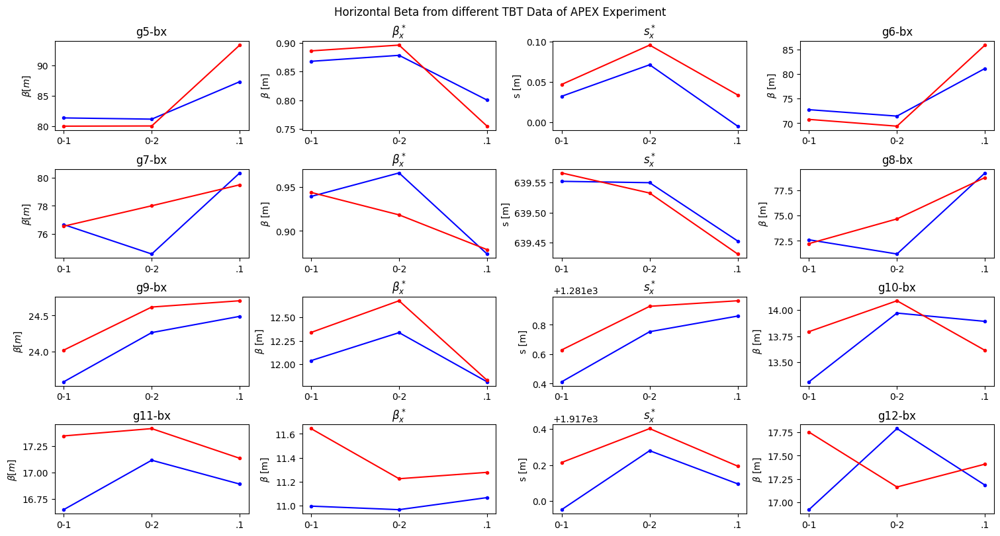

In [50]:
nrow = 4 
ncol = 4

print("blue: vary number of turns in an interval")
print("red: vary initial turn number")
print("black: model from madx using APEX currents")

fig, Ax = plt.subplots(nrow, ncol, figsize=(15, 8), layout='constrained')
fig.suptitle("Horizontal Beta from different TBT Data of APEX Experiment")

x_axis = ["0-1", "0-2", ".1"]

xIPs = Drift_bpmx[1::3]
yIPs = Drift_bpmy[1::3]

for i in range(nrow):
    x1, x2 = xIPs[i]
    Namex1 = Name_xbpms[x1]
    Namex2 = Name_xbpms[x2]
    
    Ax[i][0].plot(x_axis, b1_data_vary_interval[:, i], '-ob', ms = 3)
    Ax[i][1].plot(x_axis, b_star_data_vary_interval[:, i], '-ob', ms = 3)
    Ax[i][2].plot(x_axis, s_star_data_vary_interval[:, i], '-ob', ms = 3)
    Ax[i][3].plot(x_axis, b2_data_vary_interval[:, i], '-ob', ms = 3)

    Ax[i][0].plot(x_axis, b1_data_vary_initial[:, i], '-or', ms = 3)
    Ax[i][1].plot(x_axis, b_star_data_vary_initial[:, i], '-or', ms = 3)
    Ax[i][2].plot(x_axis, s_star_data_vary_initial[:, i], '-or', ms = 3)
    Ax[i][3].plot(x_axis, b2_data_vary_initial[:, i], '-or', ms = 3)

    Ax[i][0].set_title(Namex1) 
    Ax[i][0].set_ylabel(r"$\beta [m]$") 
    
    Ax[i][1].set_title(r"$\beta^*_x$") 
    Ax[i][1].set_ylabel(r"$\beta$ [m]") 
    
    Ax[i][2].set_title(r"$s^*_x$")
    Ax[i][2].set_ylabel("s [m]") 
    
    Ax[i][3].set_title(Namex2)
    Ax[i][3].set_ylabel(r"$\beta$ [m]") 


plt.show()



In [119]:
sss = "/operations/app_store/RunData/run_fy23/33916/RHIC/Orbit/TBT/Blue/Wed_Jun_28_20:13:14_2023.sdds"

In [120]:
ring = 'Blue'
print(sss.find(ring))
print(sss.find('.sdds'))
index_ring = sss.find(ring)
index_sdds = sss.find('.sdds')

60
89


In [121]:
"data_" + sss[index_tbt: index_sdds].replace(":", "_")

'data_Wed_Jun_28_20_13_14_2023'